# Unsupervised Machine Learning Project - Clustering NCAA Men's Basketball Statistics from 2010 - 2023 for Ranking Potential 2024 Winners.

## By: Sam Shade

## Project Description:
### University of Colorado - Boulder M.S.D.S: DTSA 5510 Unsupervised Algorithms in Machine Learning

As March 2024 is on the horizon, millions of Americans will be filling out their brackets to predict who will be the winner of the 2024 NCAA Men's Basketball Championship. The following project uses clustering methods (K-Means Clustering and Hierarchical Clustering) as well as PCA to place 2024 teams into tiersets based on their performance so far this season. The datasets chosen can be found from the KenPom https://kenpom.com/ statistics page. This page examines advanced statistics for NCAA Men's Basketball teams, players, and coaches. From this page, four dataset categories were chosen and described below:

Miscellaneous Metrics:
- **FG2Pct:** 2-Point Field Goal Percentage         
- **RankFG2Pct:** Rank - 2-Point Field Goal Percentage
- **FG3Pct:** 3-Point Field Goal Percentage        
- **RankFG3Pct:** Rank 3-Point Field Goal Percentage      
- **FTPct:** Free Throw Percentage              
- **RankFTPct:** Rank Free Throw Percentage
- **BlockPct:** Block Percentage          
- **RankBlockPct:** Rank Block Percentage    
- **OppFG2Pct:** Opponent 2-Point Field Goal Percentage        
- **RankOppFG2Pct:** Rank Opponent 2-Point Field Goal Percentage
- **OppFG3Pct:** Opponent 3-Point Field Goal Percentage       
- **RankOppFG3Pct:** Rank Opponent 2-Point Field Goal Percentage
- **OppFTPct:** Opponent Free Throw Percentage        
- **RankOppFTPct:** Rank Opponent Free Throw Percentage     
- **OppBlockPct:** Opponent Block Percentage    
- **RankOppBlockPct:** Rank Opponent Block Percentage
- **FG3Rate:** 3-Point Field Goal Rate      
- **RankFG3Rate:** Rank 3-Point Field Goal Rate
- **OppFG3Rate:** Opponent 3-Point Field Goal Rate
- **RankOppFG3Rate:** Rank Opponent 3-Point Field Goal Rate
- **ARate:** Assist Rate       
- **RankARate:** Rank Assist Rate       
- **OppARate:** Opponent Assist Rate       
- **RankOppARate:** Rank Opponent Assist Rate
- **StlRate:** Steal Rate        
- **RankStlRate:** Rank Steal Rate
- **OppStlRate:** Opponent Steal Rate
- **RankOppStlRate:** Rank Opponent Steal Rate
- **DFP:** Defensive Footprint
- **NSTRate:** Non-Steal Turnover Rate
- **RankNSTRate:** Rank Non-Steal Turnover Rate
- **OppNSTRate:** Opponent Non-Steal Turnover Rate   
- **RankOppNSTRate:** Rank Opponent Non-Steal Turnover Rate 

Summary Statistics:
- **Tempo:** Tempo; pace of game
- **RankTempo:** Rank Tempo; pace of game
- **AdjTempo:** Adjusted Tempo (for strength of schedule)	
- **RankAdjTempo:** Rank Adjusted Tempo (for strength of schedule) 	
- **OE:** Offensive Efficiency 
- **RankOE:** Rank Offensive Efficiency
- **AdjOE:** Adjusted Offensive Efficiency (for strength of schedule) 
- **RankAdjOE:** Rank Adjusted Offensive Efficiency (for strength of schedule)
- **DE:** Defensive Efficiency
- **RankDE:** Rank Defensive Efficiency
- **AdjDE:** Adjusted Defensive Efficiency (for strength of schedule)	
- **RankAdjDE:** Rank Adjusted Defensive Efficiency (for strength of schedule)
- **AdjEM:** Adjusted Efficency Margin (for strength of schedule)
- **RankAdjEM:** Rank Adjusted Efficency Margin (for strength of schedule)

Offensive Metrics:
- **eFGPct:** Effective Field Goal Percentage
- **RankeFGPct:** Rank Effective Field Goal Percentage 
- **TOPct:** Turnover Percentage
- **RankTOPct:** Rank Turnover Percentage	
- **ORPct:** Offensive Rebounding Percentage	
- **RankORPct:** Rank Offensive Rebounding Percentage	
- **FTRate:** Free Throw Rate
- **RankFTRate:** Rank Free Throw Rate

Defensive Metrics:
- **eFGPc:** Opponent Effective Field Goal Percentage
- **RankeFGPct:** Rank Opponent Effective Field Goal Percentage
- **TOPct:** Opponent Turnover Percentage
- **RankTOPct:** Rank Opponent Turnover Percentage
- **ORPct:** Opponent Offensive Rebounding Percentage
- **RankORPct:** Rank Opponent Offensive Rebounding Percentage
- **FTRate:** Opponent Free Throw Rate
- **RankFTRate:** Rank Opponent Free Throw Rate

The process include combining datasets from different years, cleaning the data of the individual categories above, performing exploratory data analysis (EDA) to indicate Top 10 teams for every variable, performing the clustering method, and finally placing 2024 teams in tiers based on clusters. 

Disclaimer: all data and property belongs to KenPom Statistics. The following project doesn't not aim to provide insights for gambling or aim to make a profit off of the analysis. This project was strictly for educational purposes. 

## Library and Data Import

In [1]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
import matplotlib.pyplot as plt
import mplcursors  # Import mplcursors library

import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

In [2]:
# load the datasets
directory = "/Users/samshade/Desktop/NCAA Mens Basketball Statistics - KenPom/"

prefixes = ["defense", "misc", "offense", "summary"]
numbers_range = range(10, 25)

# loop over each prefix
for prefix in prefixes:
    # loop over each number in the range
    for number in numbers_range:
        # construct the file path
        file_path = f"{directory}{prefix}{number}.csv"
        
        # dynamically generate variable name and assign DataFrame
        globals()[f"{prefix}{number}"] = pd.read_csv(file_path)

In [3]:
defense_dfs = []

# loop to concatenate all defense dataframes
for year in range(10, 25):
    df_name = 'defense{}'.format(year)
    defense_dfs.append(locals()[df_name])

# concatenate all defense dataframes into a single df
def_df = pd.concat(defense_dfs)

offense_dfs = []

# loop to concatenate all offense dataframes
for year in range(10, 25):
    df_name = 'offense{}'.format(year)
    offense_dfs.append(locals()[df_name])

# concatenate all offense dataframes into a single df one
off_df = pd.concat(offense_dfs)

summary_dfs = []

# loop to concatenate all summary dataframes
for year in range(10, 25):
    df_name = 'summary{}'.format(year)
    summary_dfs.append(locals()[df_name])

# concatenate all summary dataframes into a single df 
sum_df = pd.concat(summary_dfs)

misc_dfs = []

# loop to concatenate all misc dataframes
for year in range(10, 25):
    df_name = 'misc{}'.format(year)
    misc_dfs.append(locals()[df_name])

# Concatenate all misc dataframes into into a single df
misc_df = pd.concat(misc_dfs)

## Defensive Dataframe Analysis

### Data Cleaning

In [4]:
# subsetting the dataframe for years 2010 to 2016
subset_2010_to_2016 = def_df[def_df['Season'] <= 2016].copy()

# copy values from columns with old names to columns with new names
subset_2010_to_2016['eFGPct'] = subset_2010_to_2016['eFG_Pct']
subset_2010_to_2016['RankeFGPct'] = subset_2010_to_2016['RankeFG_Pct']
subset_2010_to_2016['TOPct'] = subset_2010_to_2016['TO_Pct']
subset_2010_to_2016['RankTOPct'] = subset_2010_to_2016['RankTO_Pct']
subset_2010_to_2016['ORPct'] = subset_2010_to_2016['OR_Pct']
subset_2010_to_2016['RankORPct'] = subset_2010_to_2016['RankOR_Pct']
subset_2010_to_2016['FTRate'] = subset_2010_to_2016['FT_Rate']
subset_2010_to_2016['RankFTRate'] = subset_2010_to_2016['RankFT_Rate']

# drop columns with old names
subset_2010_to_2016.drop(columns=['eFG_Pct', 'RankeFG_Pct', 'TO_Pct', 'RankTO_Pct', 'OR_Pct', 'RankOR_Pct', 'FT_Rate', 'RankFT_Rate'], inplace=True)

# subsetting the dataframe for years 2017 to 2024
subset_2017_to_2024 = def_df[def_df['Season'] >= 2017].copy()

# drop columns labeled incorrectly from 2010 to 2016
subset_2017_to_2024.drop(columns=['eFG_Pct', 'RankeFG_Pct', 'TO_Pct', 'RankTO_Pct', 'OR_Pct', 'RankOR_Pct', 'FT_Rate', 'RankFT_Rate'], inplace=True)

# concatenating both subsets
final_def_df = pd.concat([subset_2010_to_2016, subset_2017_to_2024], ignore_index=True)

In [5]:
final_def_df

,Season,TeamName,eFGPct,RankeFGPct,TOPct,RankTOPct,ORPct,RankORPct,FTRate,RankFTRate
0,2010,Air Force,53.184500,327.0,19.985600,200.0,31.575800,119.0,39.970700,226.0
1,2010,Akron,47.054000,87.0,20.974700,136.0,32.881500,189.0,41.462100,250.0
2,2010,Alabama,47.664400,115.0,21.383000,106.0,34.002700,233.0,36.505200,151.0
3,2010,Alabama A&M,48.128300,137.0,26.174900,5.0,40.758000,347.0,43.086300,273.0
4,2010,Alabama St.,48.876400,163.0,23.491700,26.0,31.621200,121.0,48.876400,328.0
...,...,...,...,...,...,...,...,...,...,...
5280,2024,Wright St.,55.299401,351.0,16.351454,228.0,28.617363,151.0,30.718563,126.0
5281,2024,Wyoming,53.775443,336.0,15.634422,282.0,29.472477,198.0,26.854892,41.0
5282,2024,Xavier,48.332341,66.0,15.874049,261.0,29.803922,211.0,30.732579,127.0
5283,2024,Yale,50.184502,163.0,15.686275,277.0,23.471883,10.0,29.077491,83.0


In [6]:
# add -Def to each column variable due to same named statistics in offense df's
exclude_columns = ['Season', 'TeamName']

# rename columns by adding '-Def' suffix
for column in final_def_df.columns:
    if column not in exclude_columns:
        final_def_df.rename(columns={column: f"{column}-Def"}, inplace=True)

# display the df with renamed columns
final_def_df.head()

,Season,TeamName,eFGPct-Def,RankeFGPct-Def,TOPct-Def,RankTOPct-Def,ORPct-Def,RankORPct-Def,FTRate-Def,RankFTRate-Def
0,2010,Air Force,53.1845,327.0,19.9856,200.0,31.5758,119.0,39.9707,226.0
1,2010,Akron,47.0540,87.0,20.9747,136.0,32.8815,189.0,41.4621,250.0
2,2010,Alabama,47.6644,115.0,21.3830,106.0,34.0027,233.0,36.5052,151.0
3,2010,Alabama A&M,48.1283,137.0,26.1749,5.0,40.7580,347.0,43.0863,273.0
4,2010,Alabama St.,48.8764,163.0,23.4917,26.0,31.6212,121.0,48.8764,328.0


### Defensive Dataframe EDA

### Top 10 By Defensive FG%

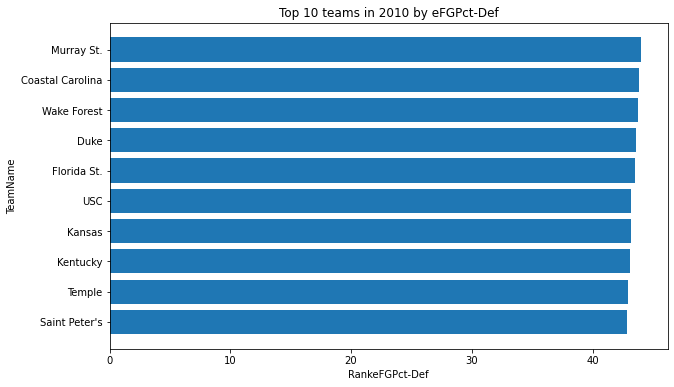

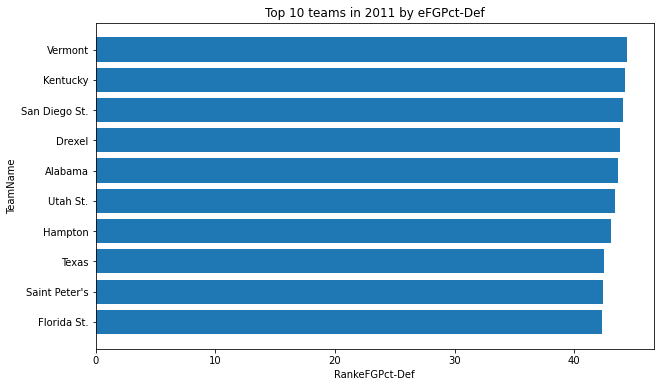

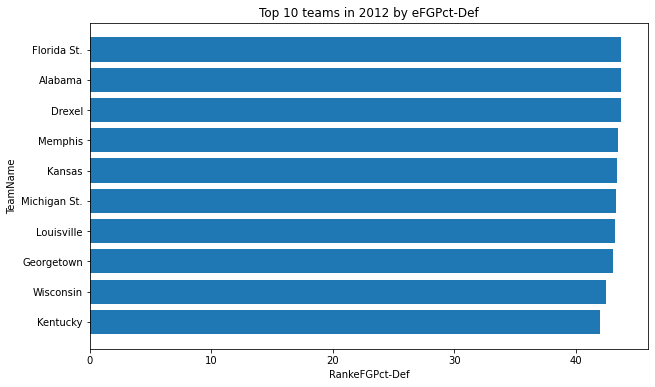

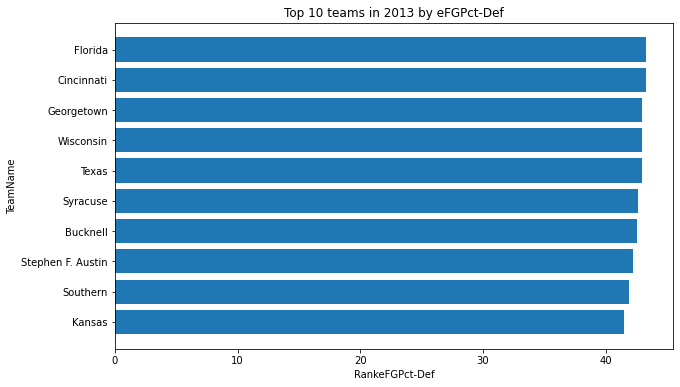

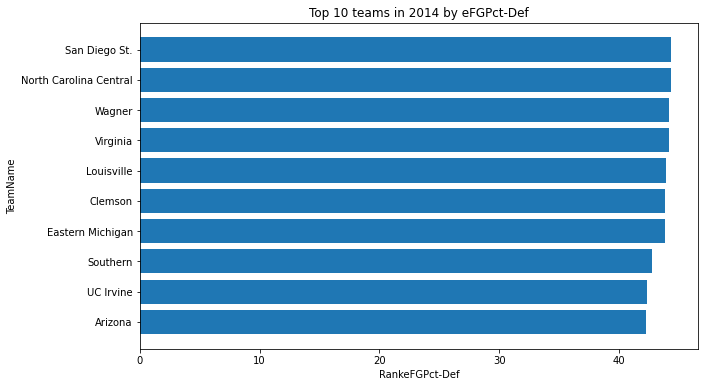

...

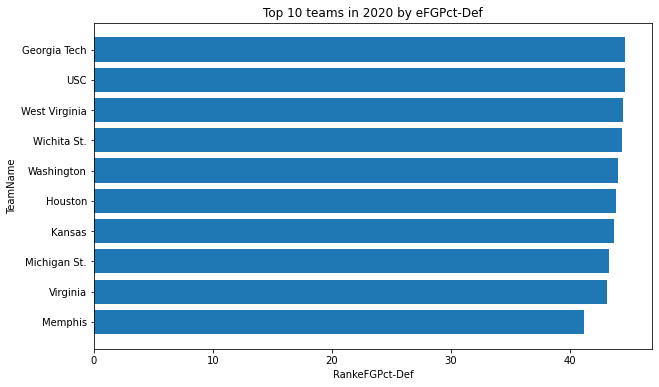

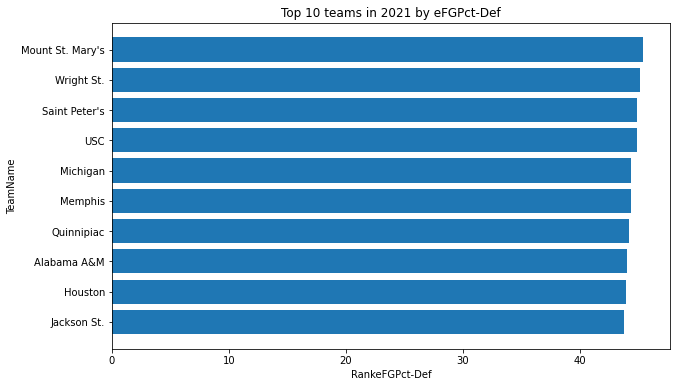

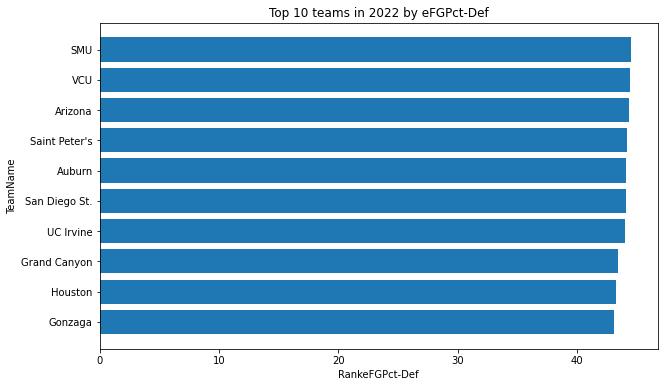

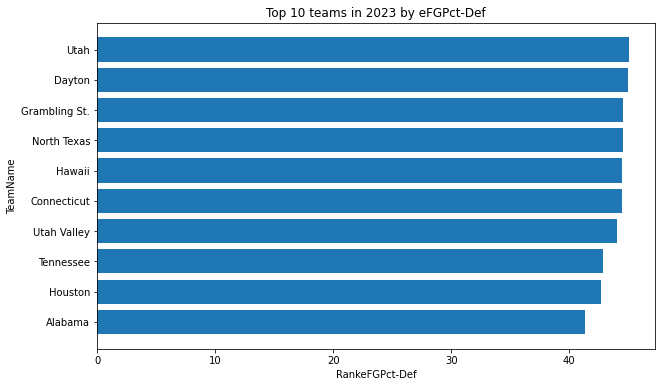

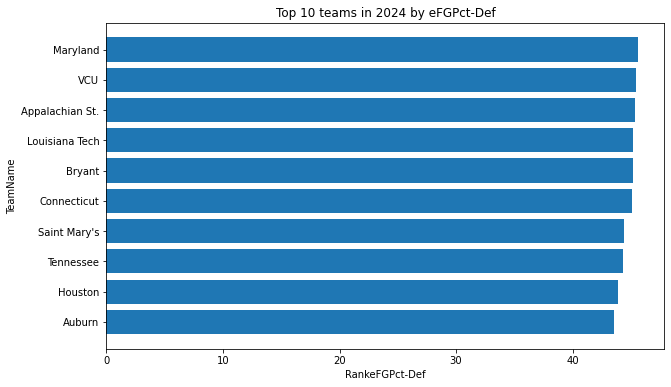

In [7]:
grouped_by_season = final_def_df.groupby('Season')

sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankeFGPct-Def')
    
for season, df_season in sorted_by_season.items():
    top_10_fgp_def = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_fgp_def['TeamName'], top_10_fgp_def['eFGPct-Def'])
    plt.xlabel('RankeFGPct-Def')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by eFGPct-Def')
    plt.show()

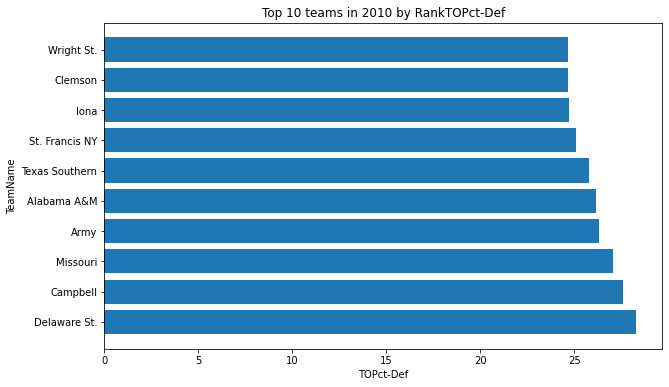

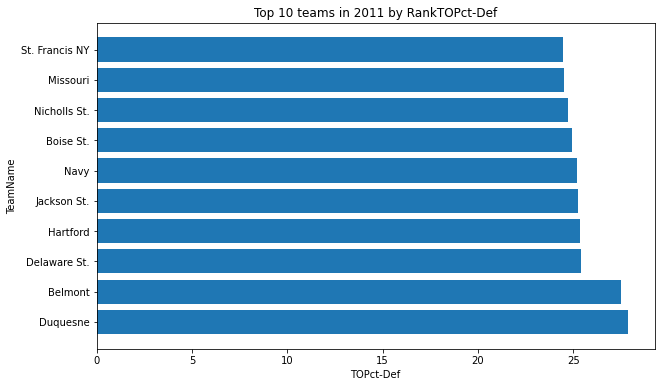

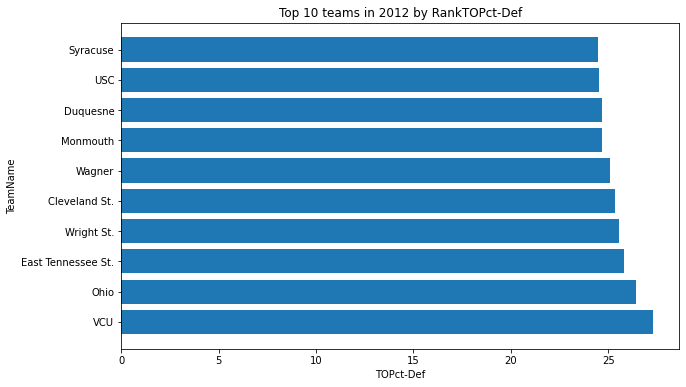

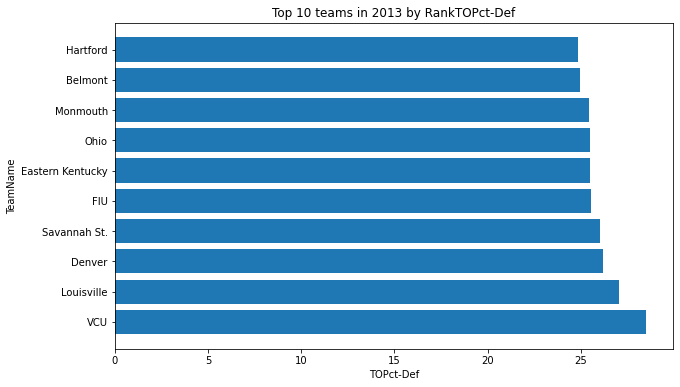

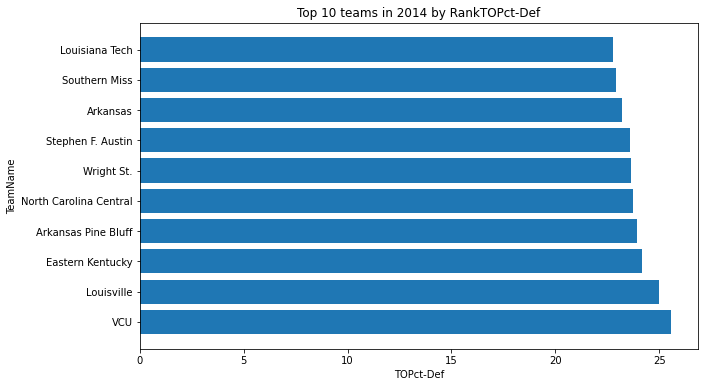

...

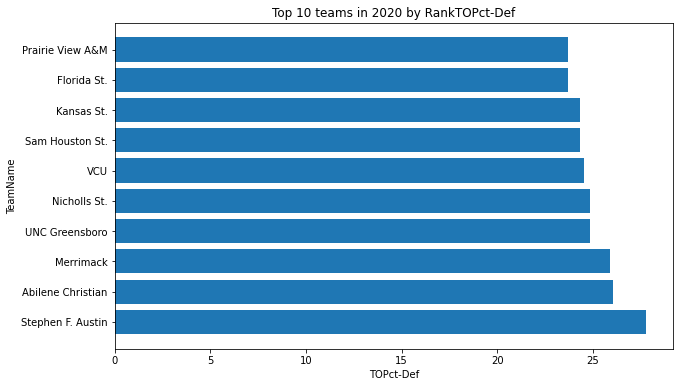

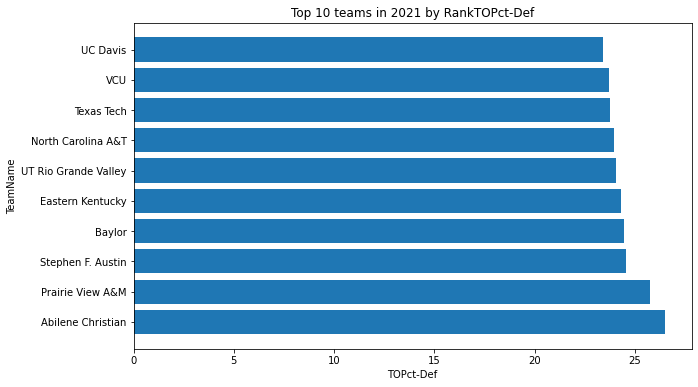

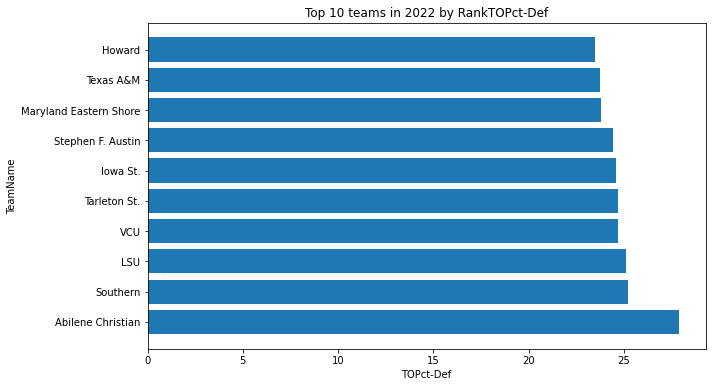

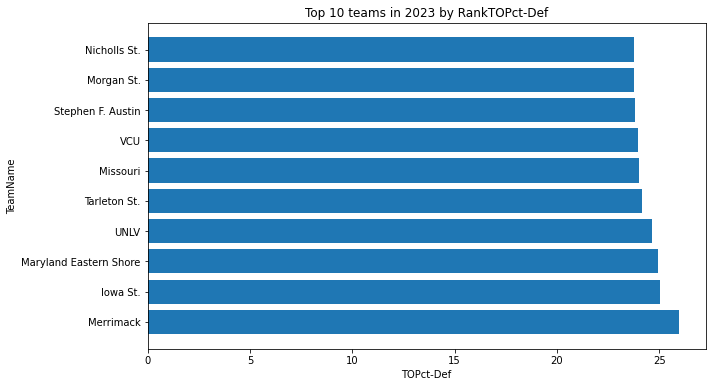

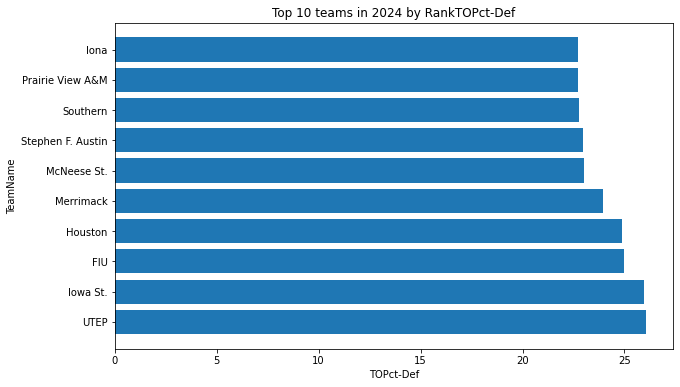

In [8]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankTOPct-Def')
    
for season, df_season in sorted_by_season.items():
    top_10_top_def = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_top_def['TeamName'], top_10_top_def['TOPct-Def'])
    plt.xlabel('TOPct-Def')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by RankTOPct-Def')
    plt.show()

### Top 10 By Defense Allowing Offensive Rebounds %

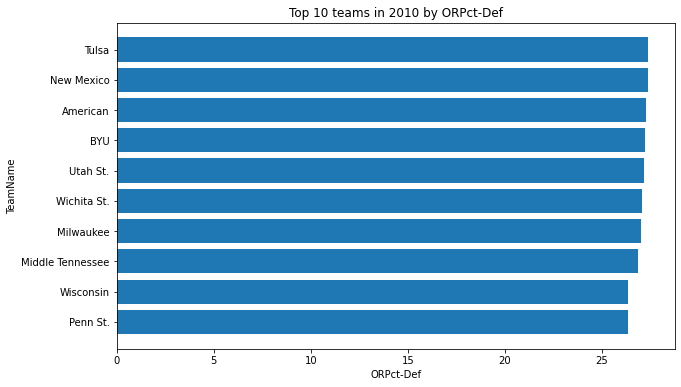

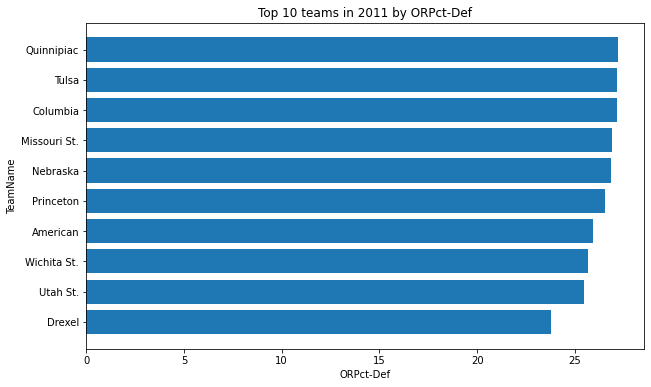

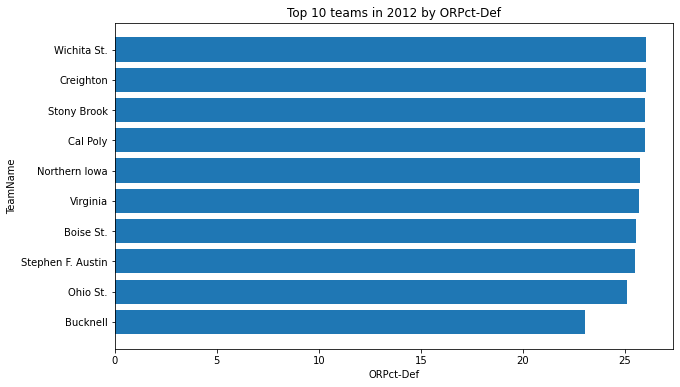

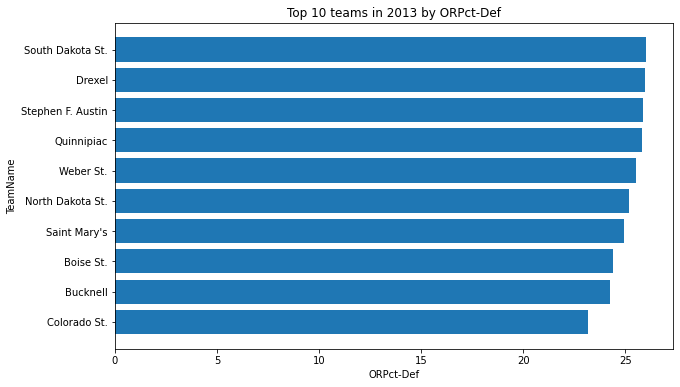

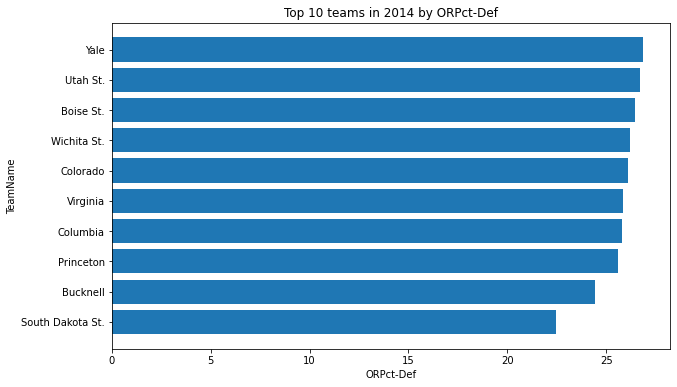

...

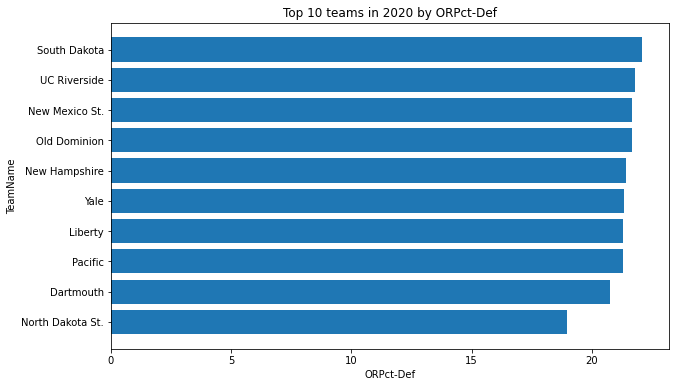

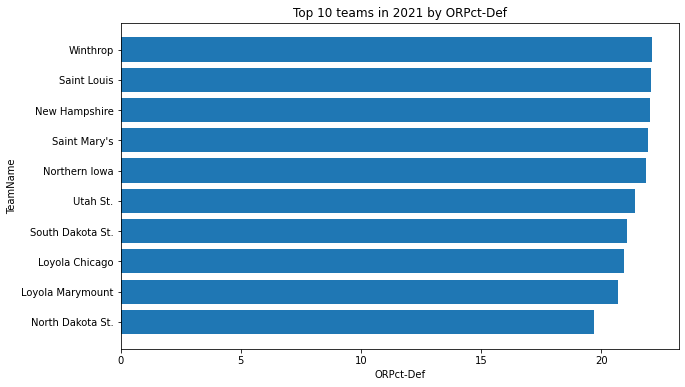

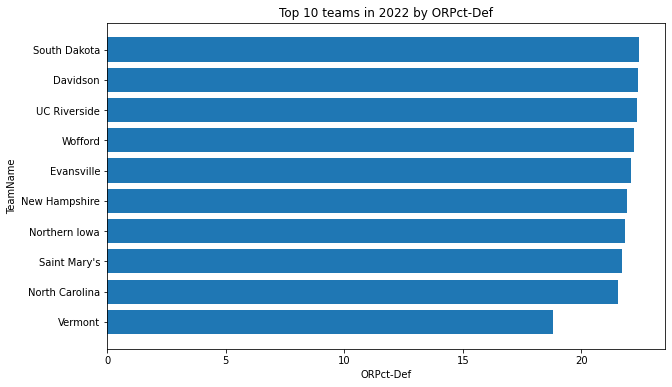

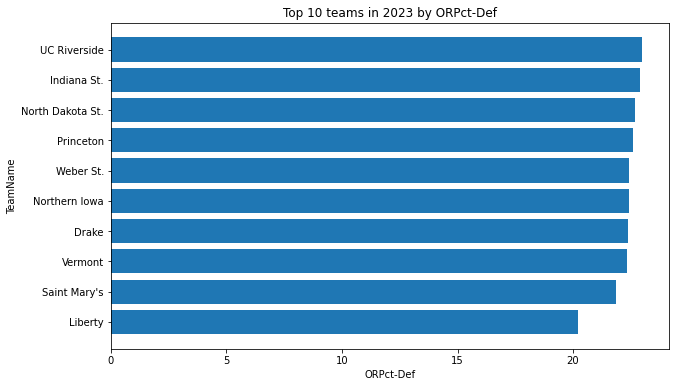

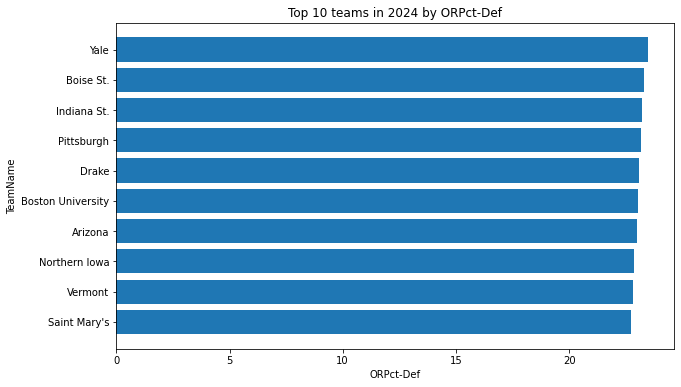

In [9]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankORPct-Def')
    
for season, df_season in sorted_by_season.items():
    top_10_orp_def = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_orp_def['TeamName'], top_10_orp_def['ORPct-Def'])
    plt.xlabel('ORPct-Def')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by ORPct-Def')
    plt.show()

### Top 10 By Defense Free Throw Rate

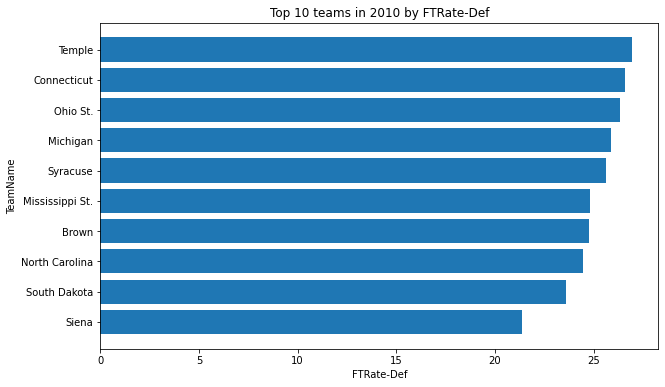

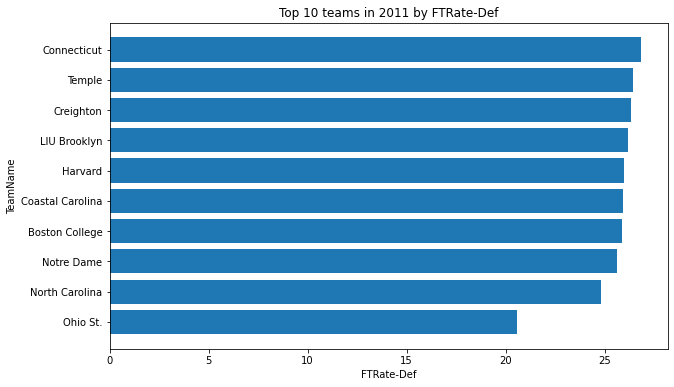

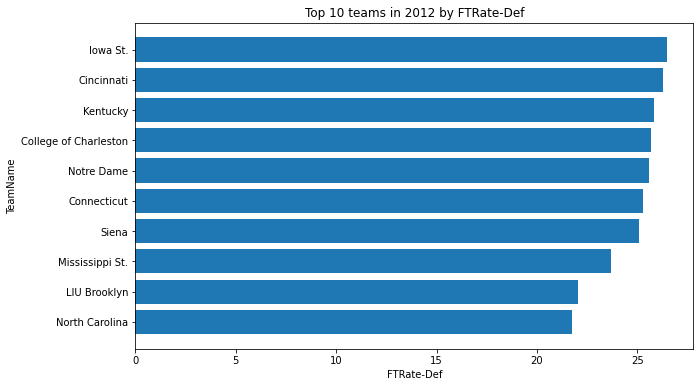

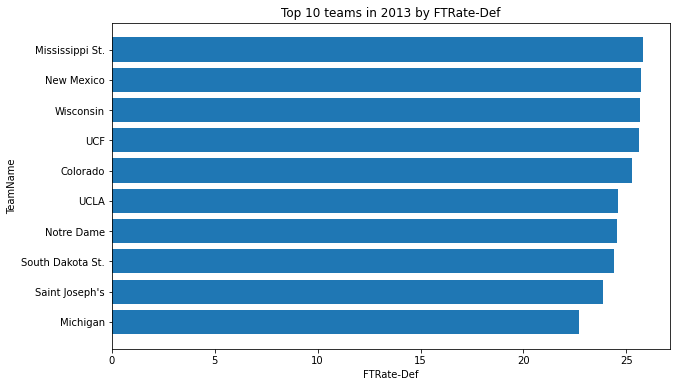

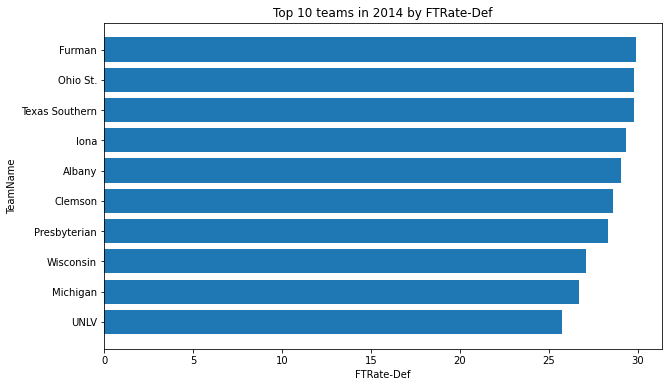

...

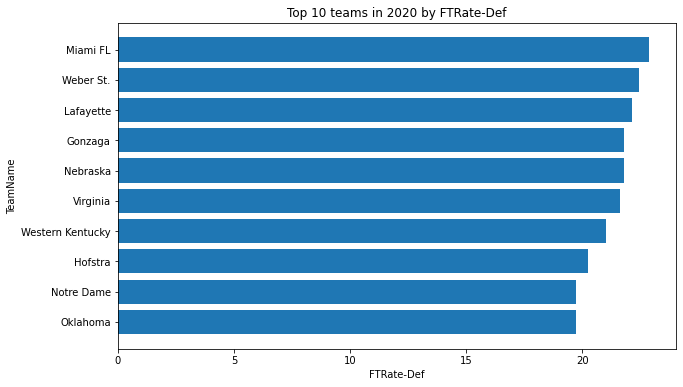

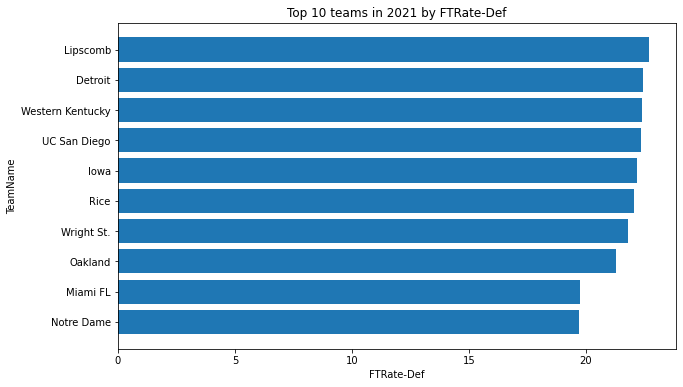

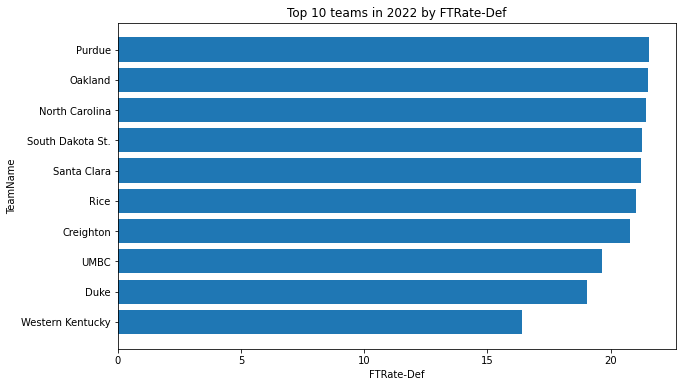

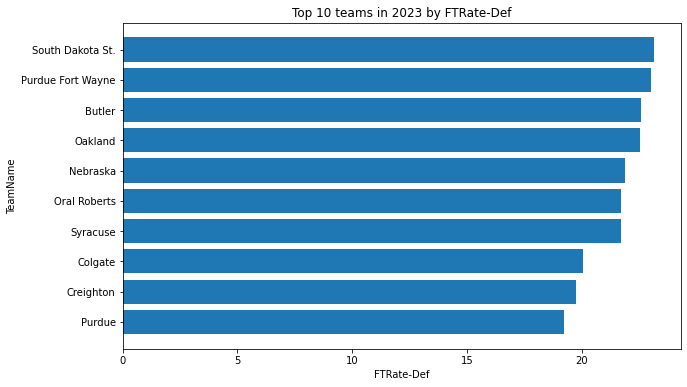

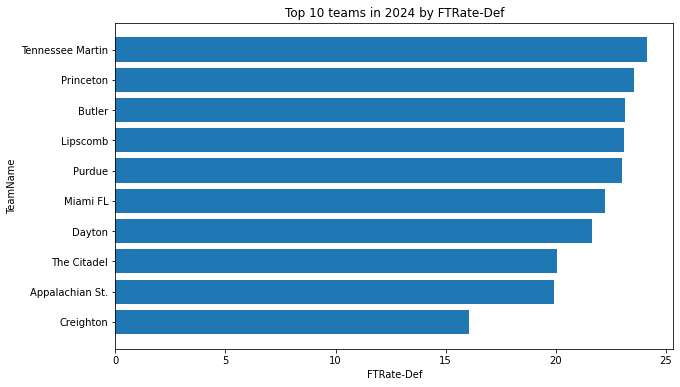

In [10]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankFTRate-Def')
    
for season, df_season in sorted_by_season.items():
    top_10_ftr_def = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_ftr_def['TeamName'], top_10_ftr_def['FTRate-Def'])
    plt.xlabel('FTRate-Def')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by FTRate-Def')
    plt.show()

### Defensive Dataframe K-Means Clustering

In [11]:
# define feature for clustering
features = ['eFGPct-Def', 'RankeFGPct-Def', 'TOPct-Def', 'RankTOPct-Def',
            'ORPct-Def', 'RankORPct-Def', 'FTRate-Def', 'RankFTRate-Def']

for season in final_def_df['Season'].unique():
    # select data for the current season
    season_data_def = final_def_df[final_def_df['Season'] == season].copy()
    
    X = season_data_def[features]

    # scaling
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # perform PCA for dimensionality reduction
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)

    # initialize KMeans
    kmeans = KMeans(n_clusters=5, random_state=42)

    # fit the model
    kmeans.fit(X_scaled)

    # predict cluster assignments
    clusters = kmeans.predict(X_scaled)

    # add cluster assignments to the DataFrame
    season_data_def['DefCluster'] = clusters

    # create a DataFrame with team names and statistics for hover-over
    hover_data = season_data_def[['TeamName'] + features + ['DefCluster']]

    # identify winner for each season
    winner = None
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut' 

    # visualize clusters using Plotly
    fig = px.scatter(season_data_def, x=X_pca[:, 0], y=X_pca[:, 1], color='DefCluster', hover_name='TeamName',
                     hover_data=hover_data, labels={'x': 'Principal Component 1', 'y': 'Principal Component 2', 'Cluster': 'Cluster'},
                     title=f'Clusters Visualization (PCA) Defensive - Season {season}')

    # highlight the winner with a different marker style
    if winner is not None:
        winner_data = season_data_def[season_data_def['TeamName'] == winner]
        winner_hovertext = [f"{winner}\nCluster: {winner_data['DefCluster'].iloc[0]}"]  # Add cluster to hovertext
        for feature in features:
            winner_hovertext.append(f"{feature}: {winner_data[feature].iloc[0]}")  # Add statistics to hovertext
        fig.add_trace(go.Scatter(x=[X_pca[0, 0]], y=[X_pca[0, 1]], mode='markers', marker=dict(symbol='star', color='black', size=12),
                                 hovertext=winner_hovertext, showlegend=False))

    fig.show()


In [12]:
winners_def_clusters = [3, 0, 1, 2, 1, 1, 0, 2, 2, 1, 1, 1, 2]

# define a list containing winners and seasons
winners_data = []

# define a list to store filtered df's
winners_def_dfs = []

for season in range(2010, 2025):
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut'
    else:
        winner = None  # For seasons not mentioned
    
    # append to winners_data list
    winners_data.append({'Season': season, 'Winner': winner})
    
    # filter final_def_df for the current season and winner
    winners_def_df = final_def_df[(final_def_df['Season'] == season) & (final_def_df['TeamName'] == winner)]
    winners_def_dfs.append(winners_def_df)

# concatenate all filtered df's
all_winners_def_df = pd.concat(winners_def_dfs, ignore_index=True)

all_winners_def_df['DefCluster'] = winners_def_clusters

# inspect
all_winners_def_df

,Season,TeamName,eFGPct-Def,RankeFGPct-Def,TOPct-Def,RankTOPct-Def,ORPct-Def,RankORPct-Def,FTRate-Def,RankFTRate-Def,DefCluster
0,2010,Duke,43.628100,7.0,21.263100,116.0,32.134200,149.0,34.013600,97.0,3
1,2011,Connecticut,44.531900,13.0,17.283600,314.0,33.459500,236.0,26.836200,10.0,0
2,2012,Kentucky,41.971400,1.0,17.583400,301.0,30.756800,113.0,25.809200,8.0,1
3,2013,Louisville,44.782200,32.0,27.048300,2.0,33.286000,242.0,34.945000,147.0,2
4,2014,Connecticut,44.556000,15.0,19.646300,82.0,32.778100,244.0,35.743000,78.0,1
5,2015,Duke,46.536600,70.0,18.585900,204.0,30.162100,125.0,24.024500,4.0,1
6,2016,Villanova,46.662200,42.0,20.552800,43.0,29.371580,147.0,29.995550,48.0,0
7,2017,North Carolina,48.102630,71.0,18.596773,168.0,24.982699,25.0,31.565330,82.0,2
8,2018,Villanova,48.479800,56.0,18.196220,186.0,27.096327,100.0,26.697209,32.0,2
9,2019,Virginia,44.686717,8.0,17.372795,250.0,25.363985,50.0,26.265664,21.0,1


## Offensive Dataframe Analysis:

### Data Cleaning

In [13]:
# subsetting the dataframe for years 2010 to 2016
subset_2010_to_2016 = off_df[off_df['Season'] <= 2016].copy()

# copy values from columns with old names to columns with new names
subset_2010_to_2016['eFGPct'] = subset_2010_to_2016['eFG_Pct']
subset_2010_to_2016['RankeFGPct'] = subset_2010_to_2016['RankeFG_Pct']
subset_2010_to_2016['TOPct'] = subset_2010_to_2016['TO_Pct']
subset_2010_to_2016['RankTOPct'] = subset_2010_to_2016['RankTO_Pct']
subset_2010_to_2016['ORPct'] = subset_2010_to_2016['OR_Pct']
subset_2010_to_2016['RankORPct'] = subset_2010_to_2016['RankOR_Pct']
subset_2010_to_2016['FTRate'] = subset_2010_to_2016['FT_Rate']
subset_2010_to_2016['RankFTRate'] = subset_2010_to_2016['RankFT_Rate']

# drop columns with old names
subset_2010_to_2016.drop(columns=['eFG_Pct', 'RankeFG_Pct', 'TO_Pct', 'RankTO_Pct', 'OR_Pct', 'RankOR_Pct', 'FT_Rate', 'RankFT_Rate'], inplace=True)

# subsetting the dataframe for years 2017 to 2024
subset_2017_to_2024 = off_df[off_df['Season'] >= 2017].copy()

# drop columns labeled incorrectly from 2010 to 2016
subset_2017_to_2024.drop(columns=['eFG_Pct', 'RankeFG_Pct', 'TO_Pct', 'RankTO_Pct', 'OR_Pct', 'RankOR_Pct', 'FT_Rate', 'RankFT_Rate'], inplace=True)

# concatenating both subsets
final_off_df = pd.concat([subset_2010_to_2016, subset_2017_to_2024], ignore_index=True)

In [14]:
final_off_df

,Season,TeamName,eFGPct,RankeFGPct,TOPct,RankTOPct,ORPct,RankORPct,FTRate,RankFTRate
0,2010,Air Force,50.037800,115.0,22.491100,285.0,23.369600,343.0,34.417500,259.0
1,2010,Akron,49.261000,146.0,19.932500,147.0,37.180000,32.0,36.595300,199.0
2,2010,Alabama,48.968800,157.0,19.581300,124.0,34.808100,94.0,34.280900,263.0
3,2010,Alabama A&M,40.380200,347.0,22.101900,264.0,33.102000,158.0,48.136900,12.0
4,2010,Alabama St.,45.193600,306.0,23.701000,320.0,35.491800,69.0,45.327100,32.0
...,...,...,...,...,...,...,...,...,...,...
5280,2024,Wright St.,58.761610,2.0,16.198159,117.0,29.221557,168.0,33.808050,153.0
5281,2024,Wyoming,50.805271,172.0,19.470377,313.0,29.040097,175.0,38.506589,43.0
5282,2024,Xavier,48.664688,258.0,16.342463,124.0,33.070089,59.0,31.691395,218.0
5283,2024,Yale,51.542777,138.0,14.192344,23.0,28.536880,196.0,28.471248,296.0


In [15]:
# add -Off to each column due to similar names in defense df's
for column in final_off_df.columns:
    if column not in exclude_columns:
        final_off_df.rename(columns={column: f"{column}-Off"}, inplace=True)

# Display the DataFrame with renamed columns
final_off_df.head()

,Season,TeamName,eFGPct-Off,RankeFGPct-Off,TOPct-Off,RankTOPct-Off,ORPct-Off,RankORPct-Off,FTRate-Off,RankFTRate-Off
0,2010,Air Force,50.0378,115.0,22.4911,285.0,23.3696,343.0,34.4175,259.0
1,2010,Akron,49.2610,146.0,19.9325,147.0,37.1800,32.0,36.5953,199.0
2,2010,Alabama,48.9688,157.0,19.5813,124.0,34.8081,94.0,34.2809,263.0
3,2010,Alabama A&M,40.3802,347.0,22.1019,264.0,33.1020,158.0,48.1369,12.0
4,2010,Alabama St.,45.1936,306.0,23.7010,320.0,35.4918,69.0,45.3271,32.0


### Offensive Dataframe EDA

### Top 10 By Offensive FG%

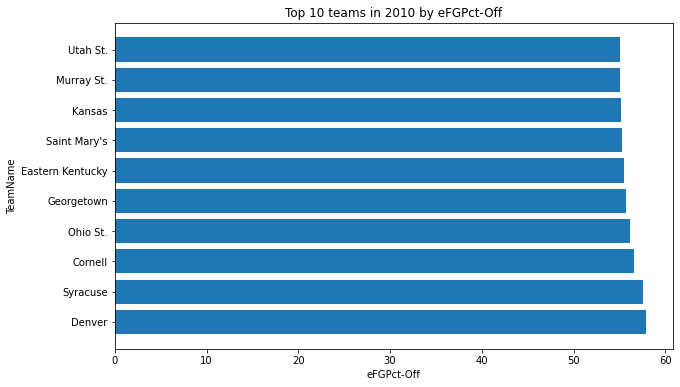

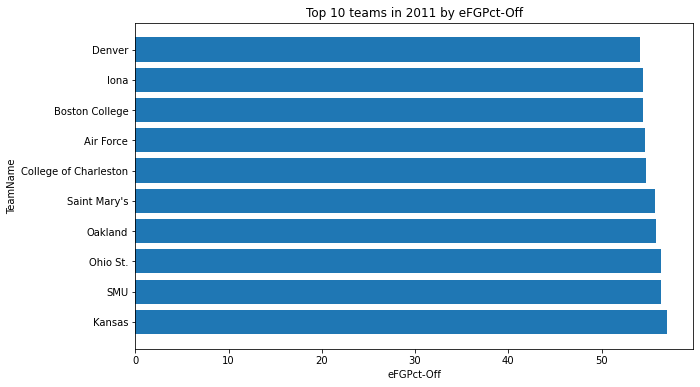

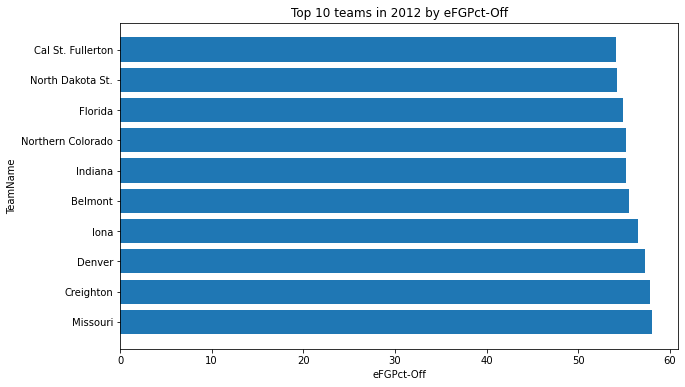

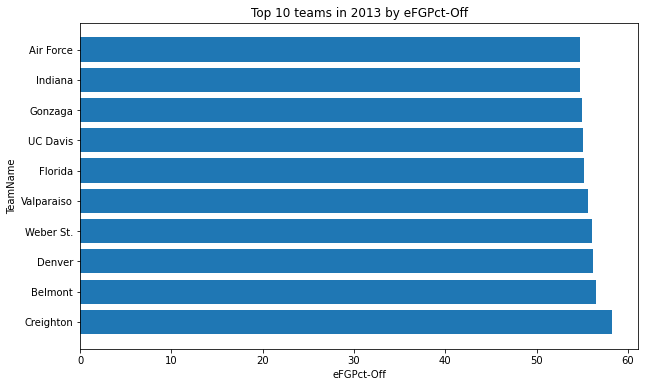

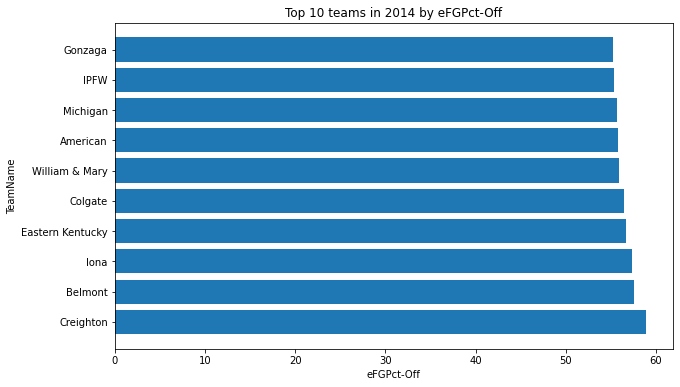

...

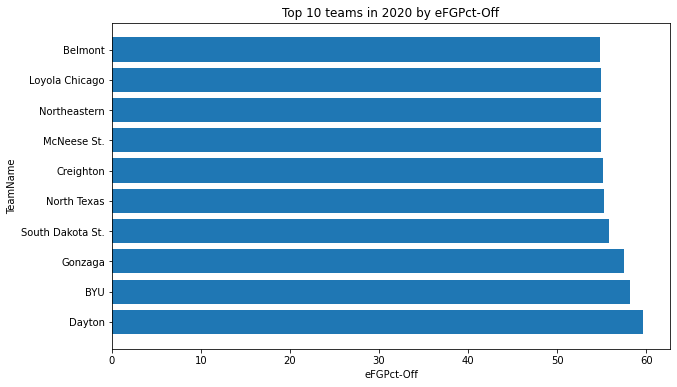

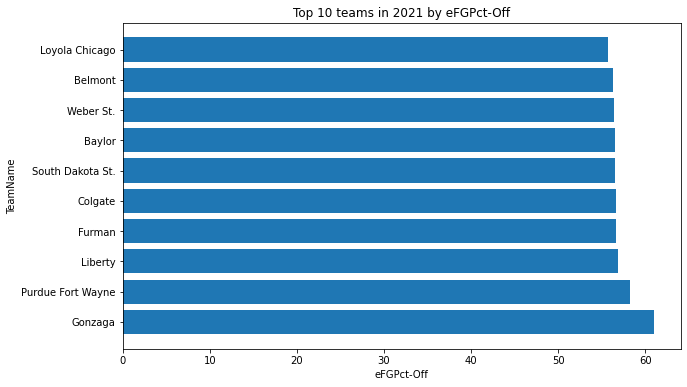

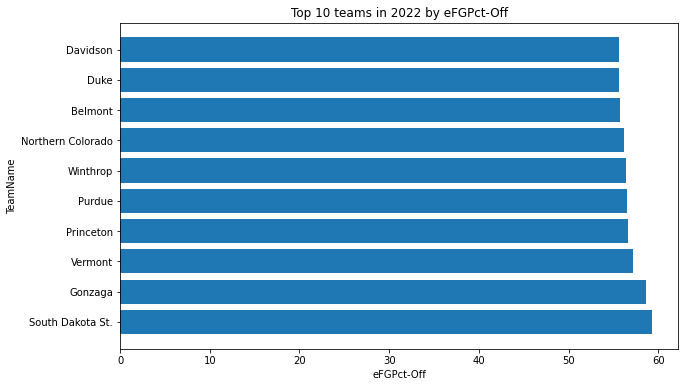

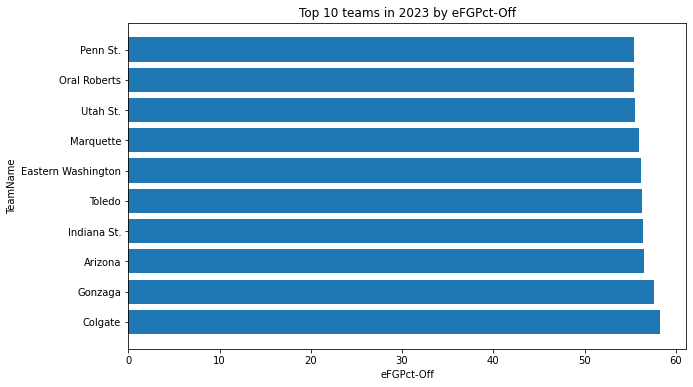

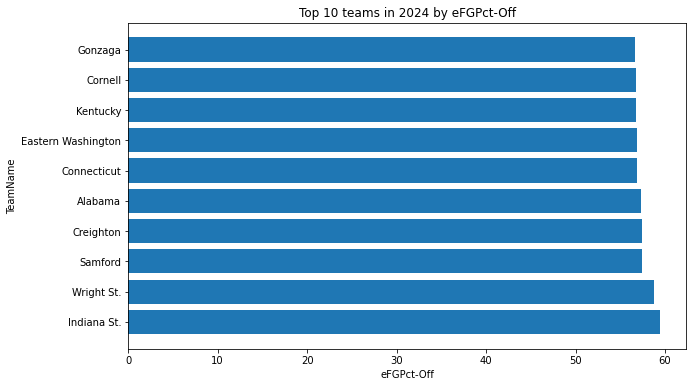

In [16]:
grouped_by_season = final_off_df.groupby('Season')

sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankeFGPct-Off')
    
for season, df_season in sorted_by_season.items():
    top_10_fgp_off = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_fgp_off['TeamName'], top_10_fgp_off['eFGPct-Off'])
    plt.xlabel('eFGPct-Off')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by eFGPct-Off')
    plt.show()

### Top 10 By Offensive Turnover %

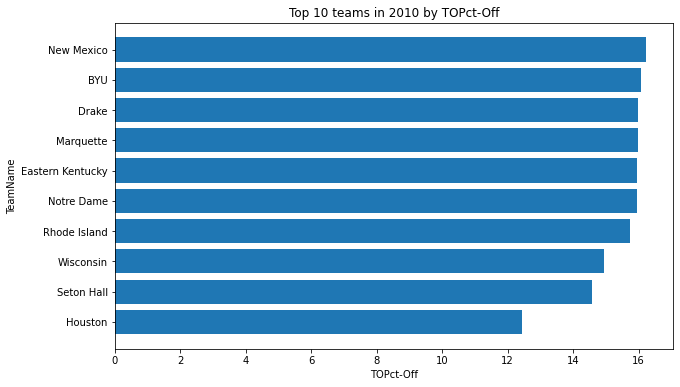

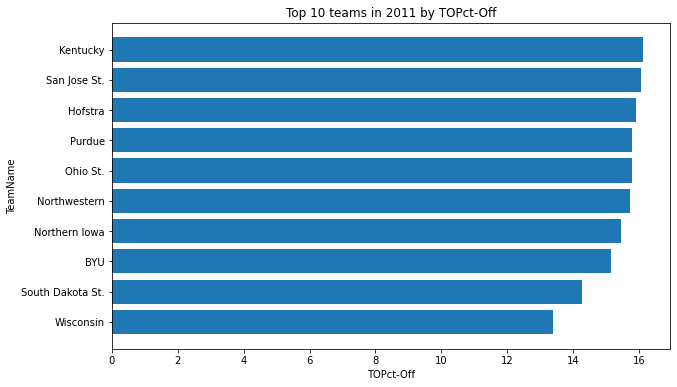

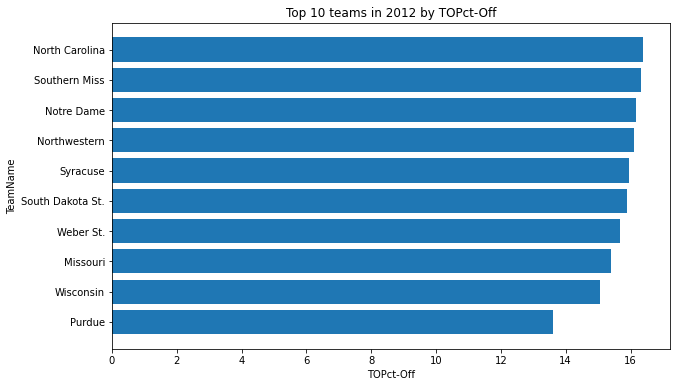

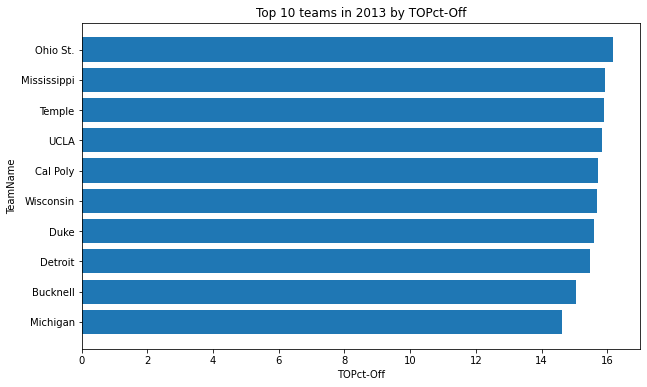

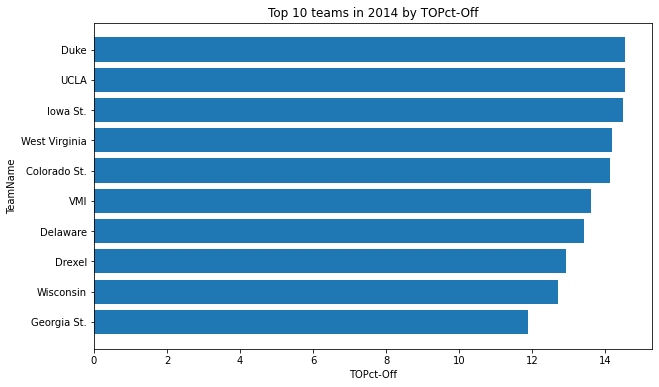

...

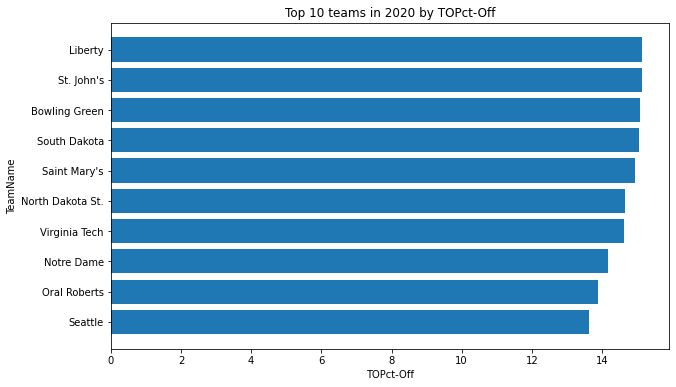

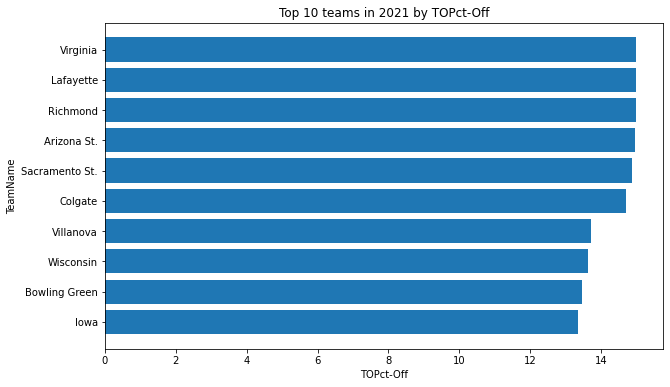

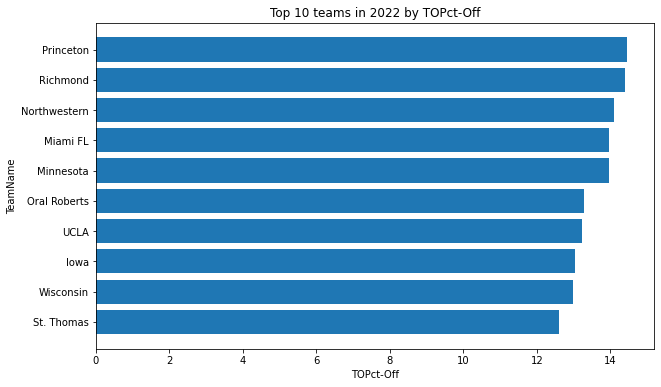

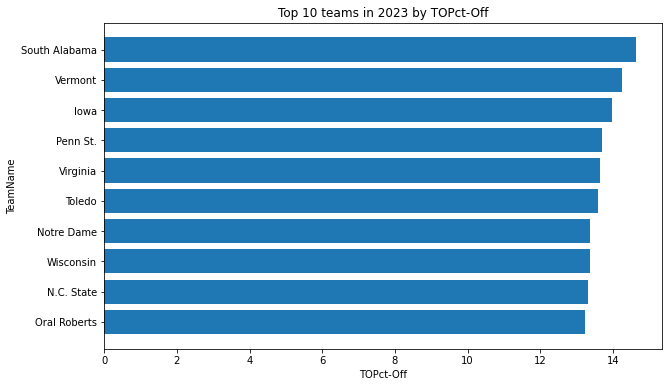

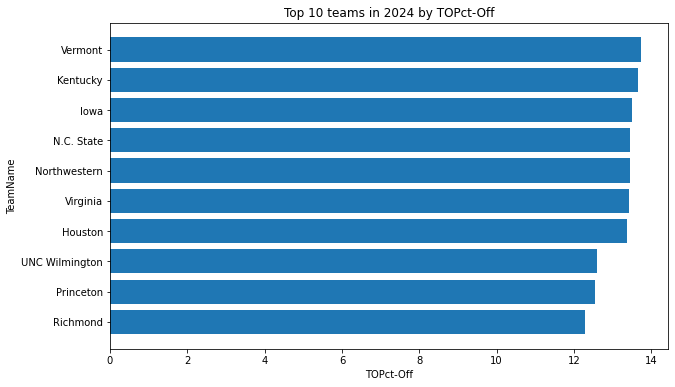

In [17]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankTOPct-Off')
    
for season, df_season in sorted_by_season.items():
    top_10_top_off = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_top_off['TeamName'], top_10_top_off['TOPct-Off'])
    plt.xlabel('TOPct-Off')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by TOPct-Off')
    plt.show()

### Top 10 By Offensive Rebound %

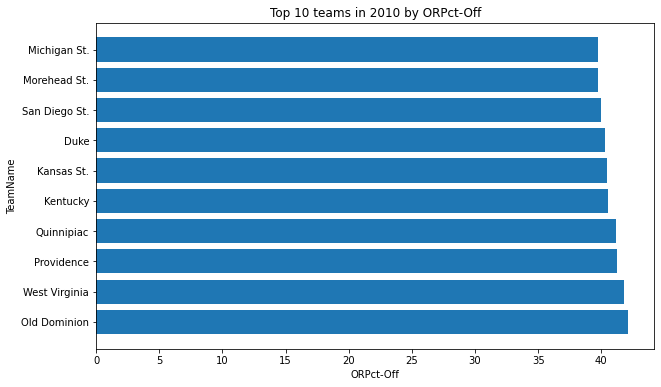

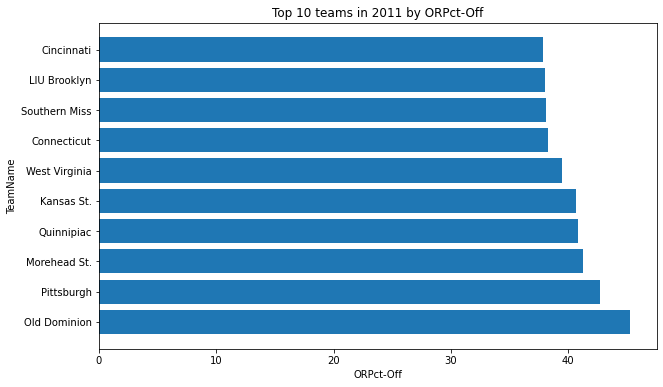

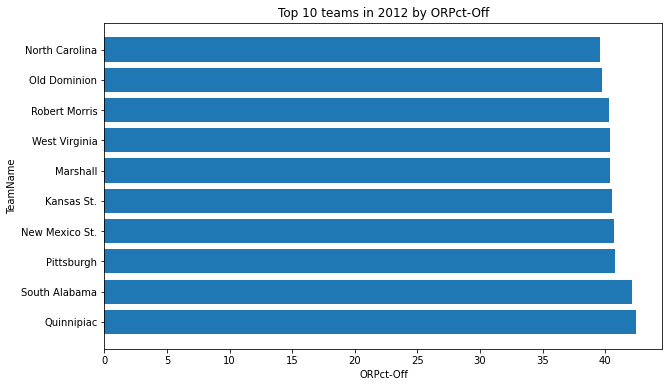

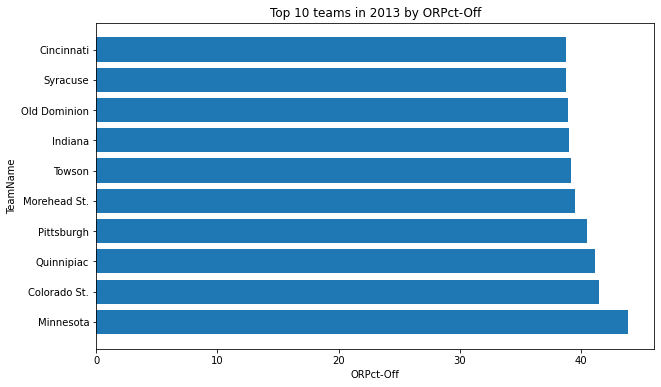

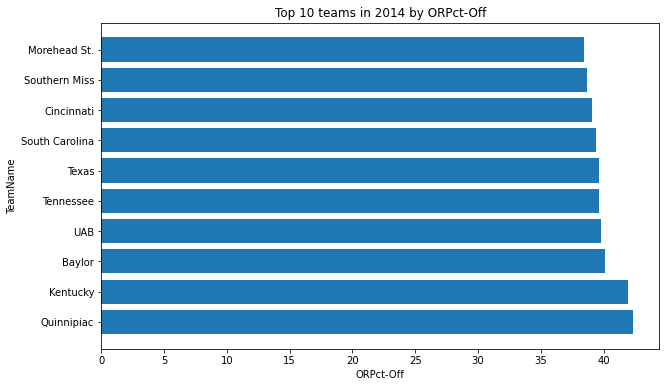

...

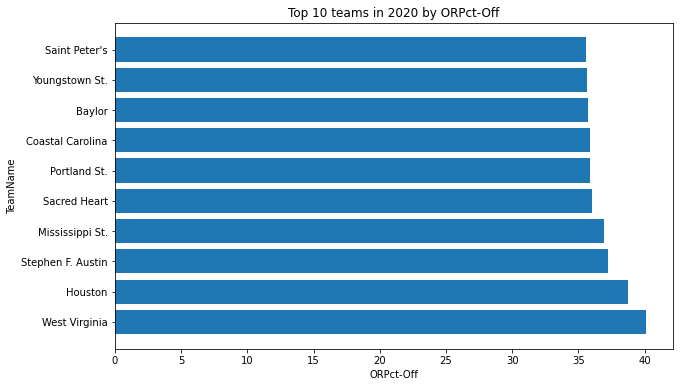

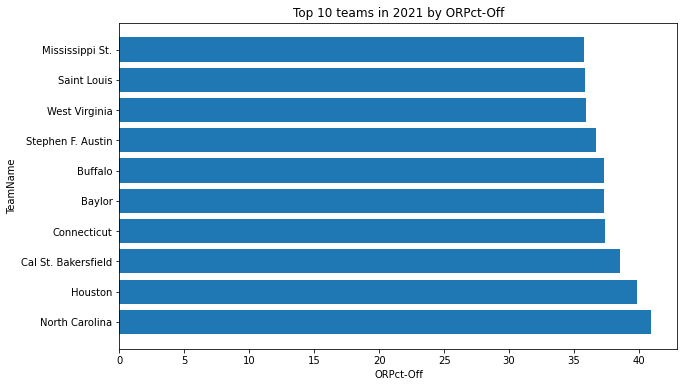

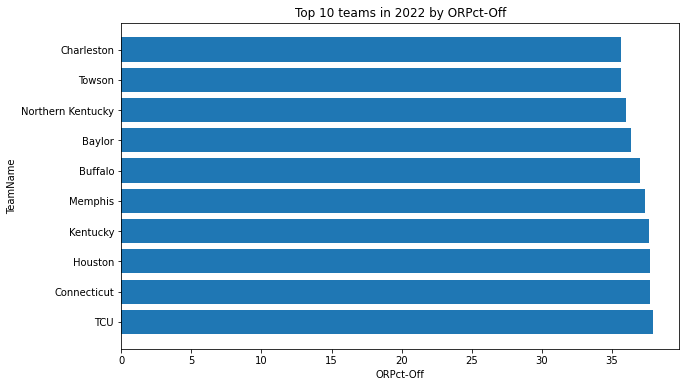

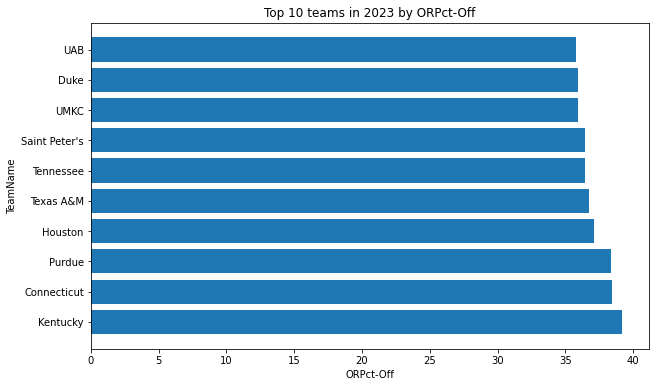

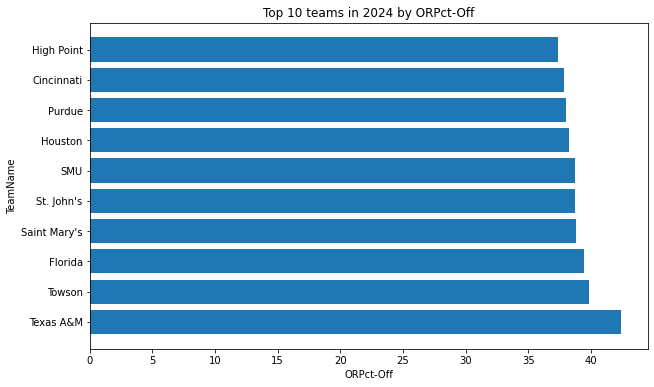

In [18]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankORPct-Off')
    
for season, df_season in sorted_by_season.items():
    top_10_orp_off = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_orp_off['TeamName'], top_10_orp_off['ORPct-Off'])
    plt.xlabel('ORPct-Off')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by ORPct-Off')
    plt.show()

### Top 10 By Offensive Free Throw Rate

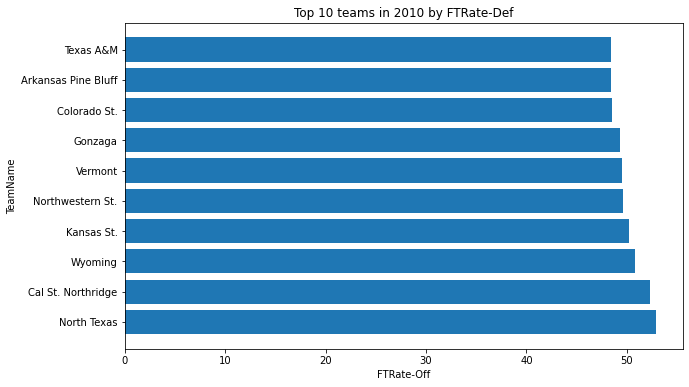

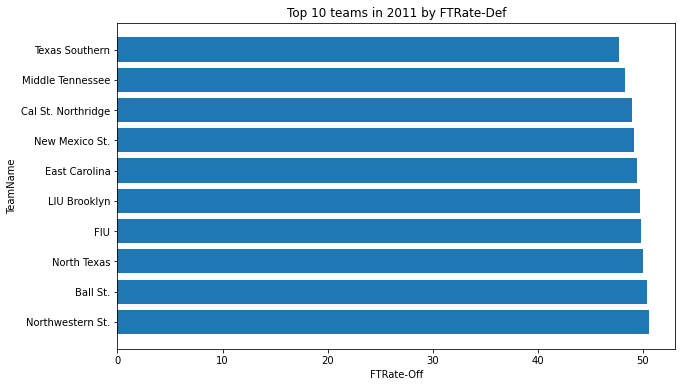

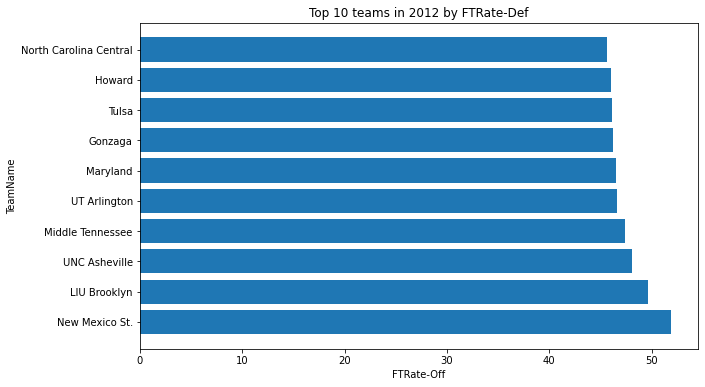

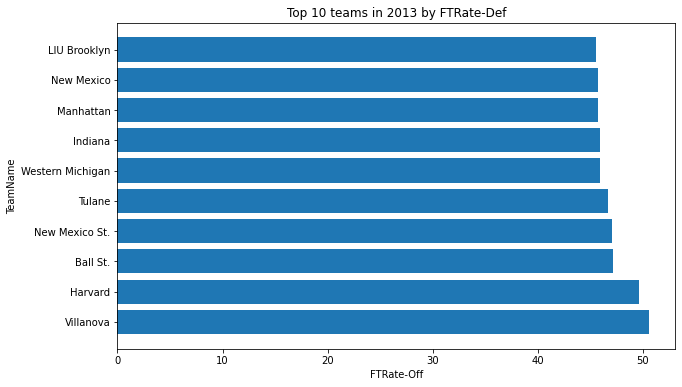

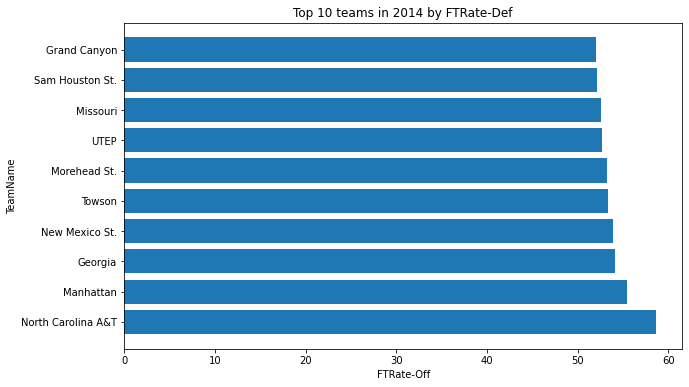

...

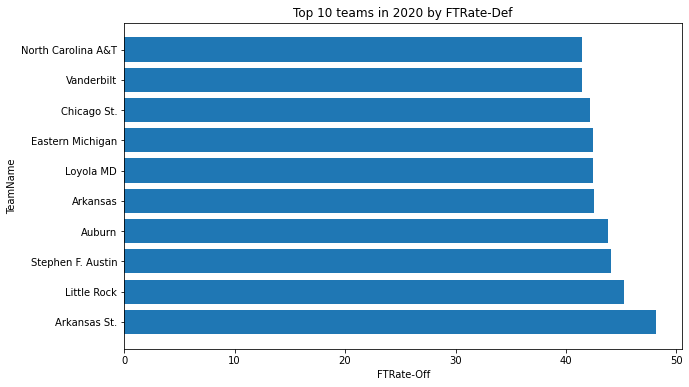

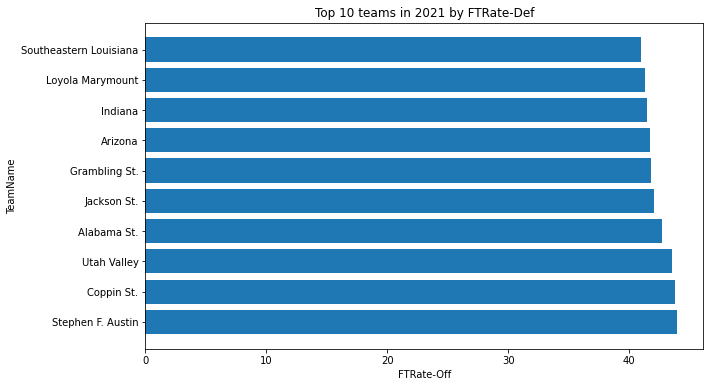

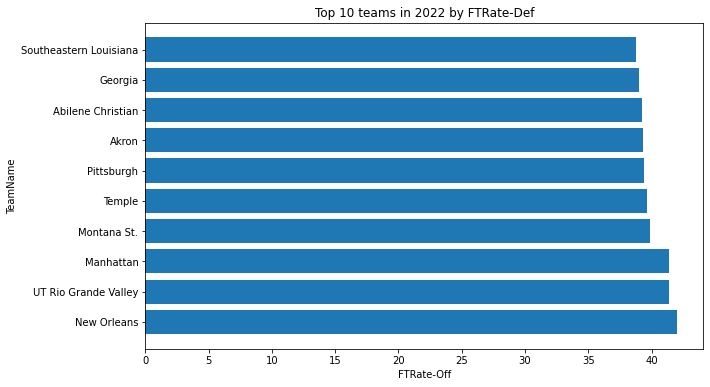

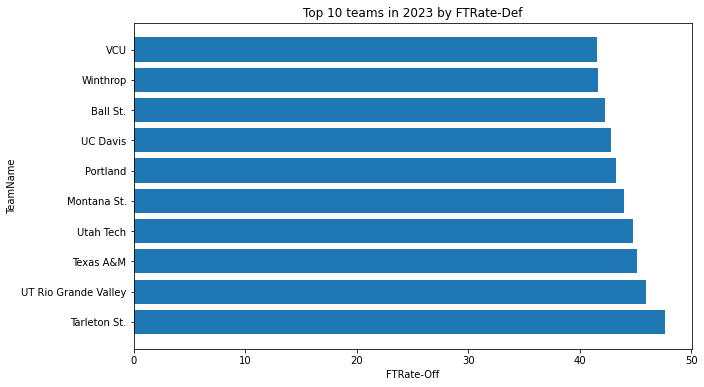

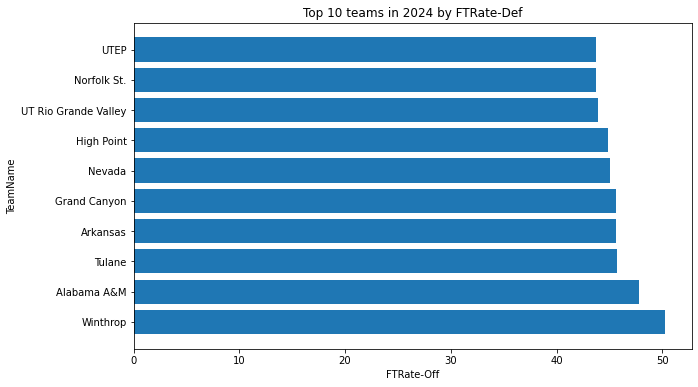

In [19]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankFTRate-Off')
    
for season, df_season in sorted_by_season.items():
    top_10_ftr_off = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_ftr_off['TeamName'], top_10_ftr_off['FTRate-Off'])
    plt.xlabel('FTRate-Off')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by FTRate-Def')
    plt.show()

### Offensive Dataframe K-Means Clustering

In [20]:
# features for clustering
features = ['eFGPct-Off', 'RankeFGPct-Off', 'TOPct-Off', 'RankTOPct-Off',
            'ORPct-Off', 'RankORPct-Off', 'FTRate-Off', 'RankFTRate-Off']

for season in final_off_df['Season'].unique():
    # select data for the current season
    season_data_off = final_off_df[final_off_df['Season'] == season].copy()
    
    X = season_data_off[features]

    # scaling
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # perform PCA for dimensionality reduction
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)

    # initialize KMeans
    kmeans = KMeans(n_clusters=5, random_state=42)

    # fit the model
    kmeans.fit(X_scaled)

    # predict cluster assignments
    clusters = kmeans.predict(X_scaled)

    # add cluster assignments to the df
    season_data_off['OffCluster'] = clusters

    # create a df with team names and statistics for hover-over
    hover_data = season_data_off[['TeamName'] + features + ['OffCluster']]

    # identify winner for each season
    winner = None
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut' 

    # visualize clusters using Plotly
    fig = px.scatter(season_data_off, x=X_pca[:, 0], y=X_pca[:, 1], color='OffCluster', hover_name='TeamName',
                     hover_data=hover_data, labels={'x': 'Principal Component 1', 'y': 'Principal Component 2', 'Cluster': 'Cluster'},
                     title=f'Clusters Visualization (PCA) Offensive - Season {season}')

    # highlight the winner with a different marker style
    if winner is not None:
        winner_data = season_data_off[season_data_off['TeamName'] == winner]
        winner_hovertext = [f"{winner}\nCluster: {winner_data['OffCluster'].iloc[0]}"]  # Add cluster to hovertext
        for feature in features:
            winner_hovertext.append(f"{feature}: {winner_data[feature].iloc[0]}")  # Add statistics to hovertext
        fig.add_trace(go.Scatter(x=[X_pca[0, 0]], y=[X_pca[0, 1]], mode='markers', marker=dict(symbol='star', color='black', size=12),
                                 hovertext=winner_hovertext, showlegend=False))

    fig.show()


In [21]:
winners_off_clusters = [1, 4, 3, 0, 2, 4, 0, 3, 0, 1, 1, 1, 2]

# define a list containing winners and seasons
winners_data = []

# define a list to store filtered df's
winners_off_dfs = []

# Iterate over each season
for season in range(2010, 2025):
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut'
    else:
        winner = None  # For seasons not mentioned
    
    # append to winners_data list
    winners_data.append({'Season': season, 'Winner': winner})
    
    # filter final_def_df for the current season and winner
    winners_off_df = final_off_df[(final_off_df['Season'] == season) & (final_off_df['TeamName'] == winner)]
    winners_off_dfs.append(winners_off_df)

# concatenate all filtered df's
all_winners_off_df = pd.concat(winners_off_dfs, ignore_index=True)

all_winners_off_df['OffCluster'] = winners_off_clusters

# inspect
all_winners_off_df

,Season,TeamName,eFGPct-Off,RankeFGPct-Off,TOPct-Off,RankTOPct-Off,ORPct-Off,RankORPct-Off,FTRate-Off,RankFTRate-Off,OffCluster
0,2010,Duke,50.527000,92.0,16.416900,15.0,40.308400,7.0,37.900500,158.0,1
1,2011,Connecticut,48.168000,213.0,17.137100,26.0,38.228300,7.0,33.841100,268.0,4
2,2012,Kentucky,53.758900,14.0,16.982300,21.0,37.461400,21.0,41.726000,47.0,3
3,2013,Louisville,50.543200,88.0,18.303900,77.0,38.228900,16.0,39.982600,71.0,0
4,2014,Connecticut,51.549500,83.0,17.332800,103.0,30.400600,209.0,38.344100,233.0,2
5,2015,Duke,56.618000,4.0,16.267500,35.0,35.771700,32.0,39.844800,97.0,4
6,2016,Villanova,56.052500,8.0,16.323500,58.0,28.238130,224.0,34.089900,242.0,0
7,2017,North Carolina,51.654340,115.0,16.232477,39.0,41.251682,1.0,34.332425,208.0,3
8,2018,Villanova,59.508197,1.0,15.045513,14.0,29.569892,140.0,29.426230,287.0,0
9,2019,Virginia,55.179961,19.0,14.706673,12.0,30.366492,101.0,29.085603,279.0,1


## Misc Dataframe Analysis

### Data Cleaning

In [22]:
misc_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5285 entries, 0 to 361
Data columns (total 40 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Season                5285 non-null   int64  
 1   TeamName              5285 non-null   object 
 2   FG2Pct                5285 non-null   float64
 3   RankFG2Pct            5285 non-null   int64  
 4   FG3Pct                5285 non-null   float64
 5   RankFG3Pct            5285 non-null   int64  
 6   FTPct                 5285 non-null   float64
 7   RankFTPct             5285 non-null   int64  
 8   BlockPct              5285 non-null   float64
 9   RankBlockPct          5285 non-null   int64  
 10  OppFG2Pct             5285 non-null   float64
 11  RankOppFG2Pct         5285 non-null   int64  
 12  OppFG3Pct             5285 non-null   float64
 13  RankOppFG3Pct         5285 non-null   int64  
 14  OppFTPct              5285 non-null   float64
 15  RankOppFTPct          

In [23]:
columns_to_drop = ['F3GRate','RankF3GRate','OppF3GRate', 'RankOppF3GRate',
                'DefensiveFingerprint', 'FG3Rate','RankFG3Rate','OppFG3Rate',
                'RankOppFG3Rate','DFP','NSTRate','RankNSTRate','OppNSTRate',
                'RankOppNSTRate'] 

misc_df = misc_df.drop(columns_to_drop, axis=1)
misc_df

,Season,TeamName,FG2Pct,RankFG2Pct,FG3Pct,RankFG3Pct,FTPct,RankFTPct,BlockPct,RankBlockPct,...,OppBlockPct,RankOppBlockPct,ARate,RankARate,OppARate,RankOppARate,StlRate,RankStlRate,OppStlRate,RankOppStlRate
0,2010,Air Force,52.321200,23,31.047600,293,63.736300,321,5.774300,311,...,10.665000,268,61.379300,27,60.610900,326,0.081600,292,0.100200,203
1,2010,Akron,48.182500,153,34.230200,168,66.434500,255,8.365300,203,...,6.728500,26,53.638500,166,47.809300,41,0.091200,220,0.102100,217
2,2010,Alabama,47.604300,179,35.000000,125,70.731700,112,10.910700,76,...,10.123600,234,54.235100,147,48.505400,53,0.118100,38,0.088200,87
3,2010,Alabama A&M,39.780700,347,28.205100,339,64.139000,310,12.861700,25,...,12.163500,325,45.790600,321,57.618200,283,0.129400,10,0.111400,293
4,2010,Alabama St.,44.398300,288,31.086100,291,64.653900,297,11.348200,62,...,10.373400,254,59.764300,43,50.798700,99,0.109300,77,0.115100,314
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
357,2024,Wright St.,59.197908,4,38.461538,10,76.739927,26,7.239382,278,...,6.713165,22,50.989523,159,45.533499,54,0.083801,259,0.101175,261
358,2024,Wyoming,49.193548,227,35.742972,75,75.095057,61,6.133625,330,...,11.981567,339,45.454545,284,48.739496,130,0.070326,334,0.120309,352
359,2024,Xavier,47.665198,284,33.818182,179,73.408240,111,9.149723,175,...,11.718062,331,61.348006,13,60.869565,354,0.096806,141,0.091081,149
360,2024,Yale,52.004334,117,33.797217,181,71.674877,195,9.102244,178,...,8.775731,136,50.307692,179,56.752137,319,0.083411,261,0.078431,45


In [24]:
misc_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5285 entries, 0 to 361
Data columns (total 26 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Season           5285 non-null   int64  
 1   TeamName         5285 non-null   object 
 2   FG2Pct           5285 non-null   float64
 3   RankFG2Pct       5285 non-null   int64  
 4   FG3Pct           5285 non-null   float64
 5   RankFG3Pct       5285 non-null   int64  
 6   FTPct            5285 non-null   float64
 7   RankFTPct        5285 non-null   int64  
 8   BlockPct         5285 non-null   float64
 9   RankBlockPct     5285 non-null   int64  
 10  OppFG2Pct        5285 non-null   float64
 11  RankOppFG2Pct    5285 non-null   int64  
 12  OppFG3Pct        5285 non-null   float64
 13  RankOppFG3Pct    5285 non-null   int64  
 14  OppFTPct         5285 non-null   float64
 15  RankOppFTPct     5285 non-null   int64  
 16  OppBlockPct      5285 non-null   float64
 17  RankOppBlockPct

### Misc Dataframe EDA

### Top 10 Teams By 2-Point FG%

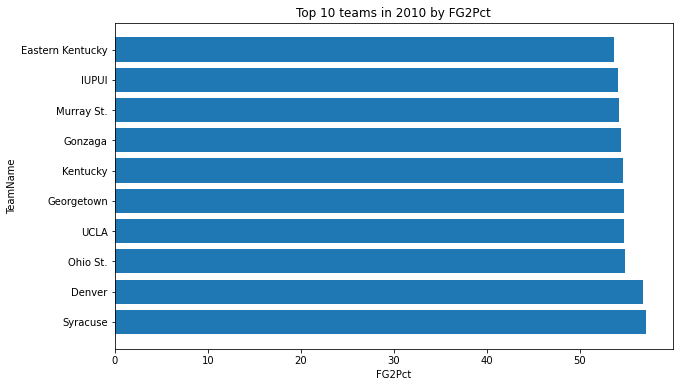

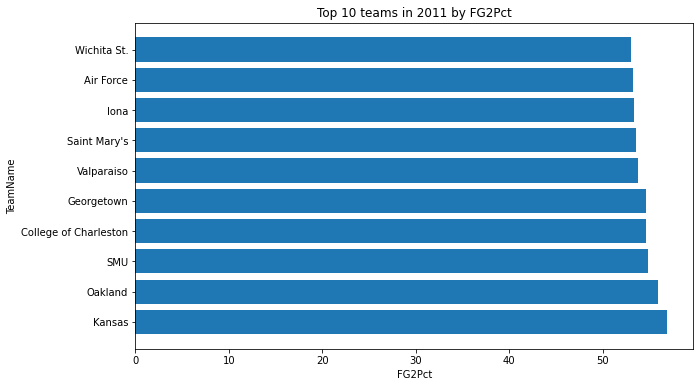

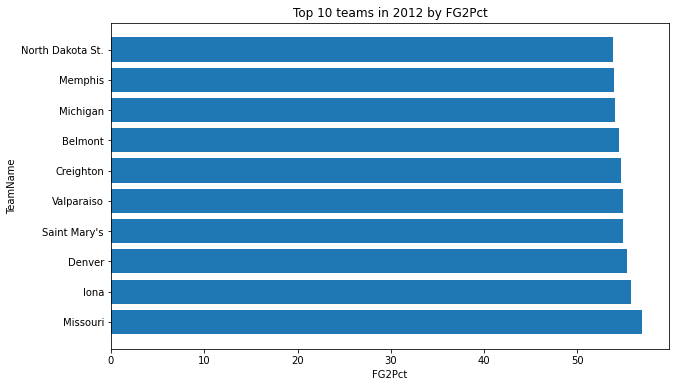

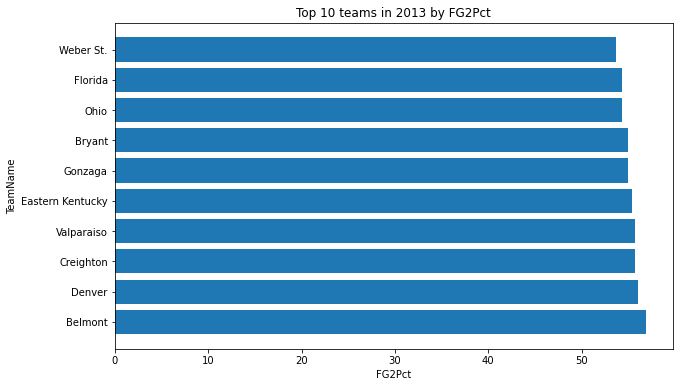

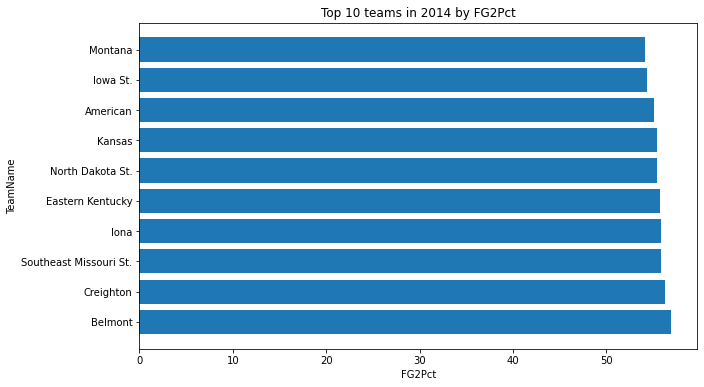

...

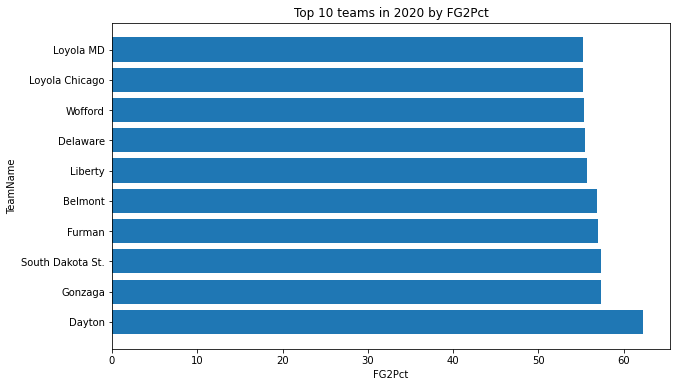

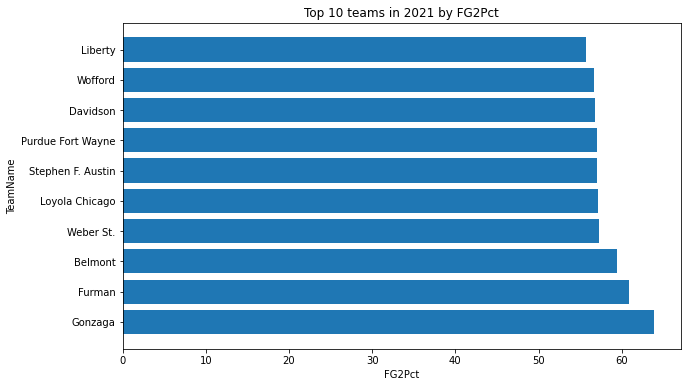

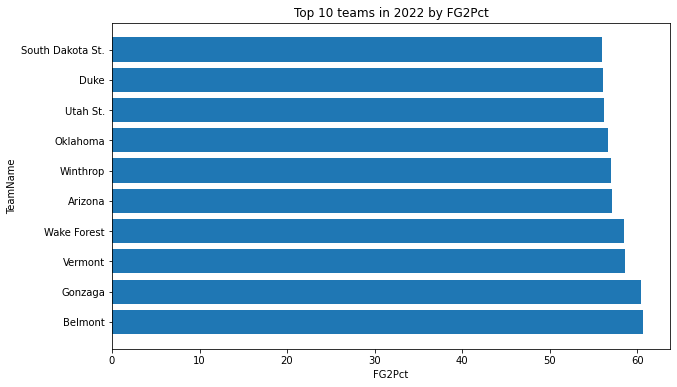

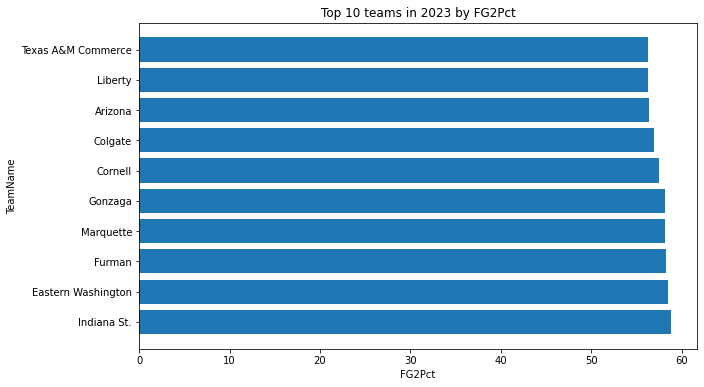

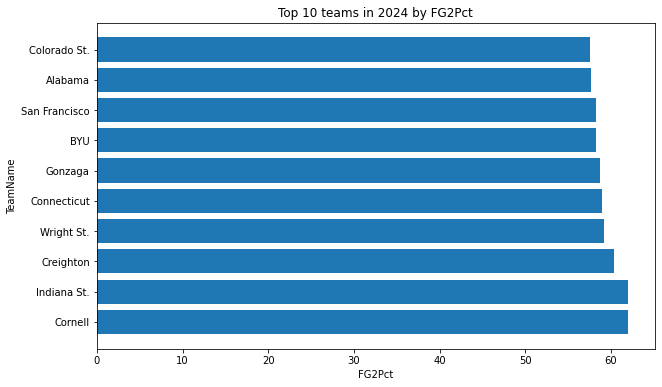

In [25]:
grouped_by_season = misc_df.groupby('Season')

# iterate over each group and sort separately
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankFG2Pct')
    
for season, df_season in sorted_by_season.items():
    top_10_fg2p = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_fg2p['TeamName'], top_10_fg2p['FG2Pct'])
    plt.xlabel('FG2Pct')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by FG2Pct')
    plt.show()

### Top 10 Teams By 3-Point FG%

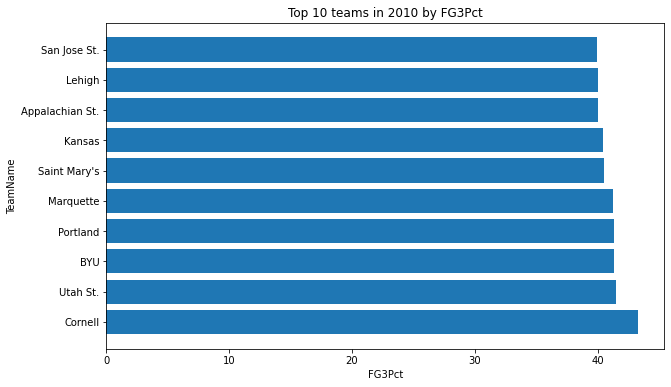

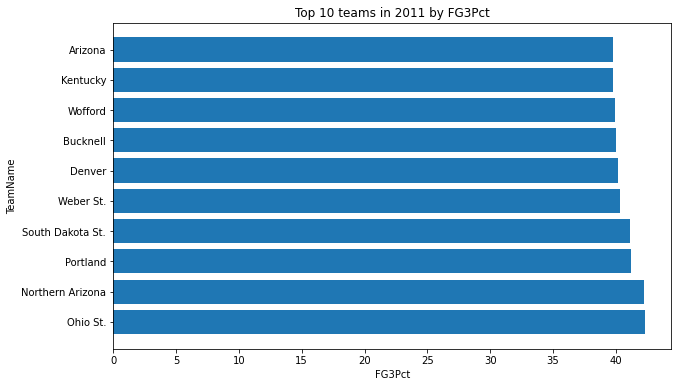

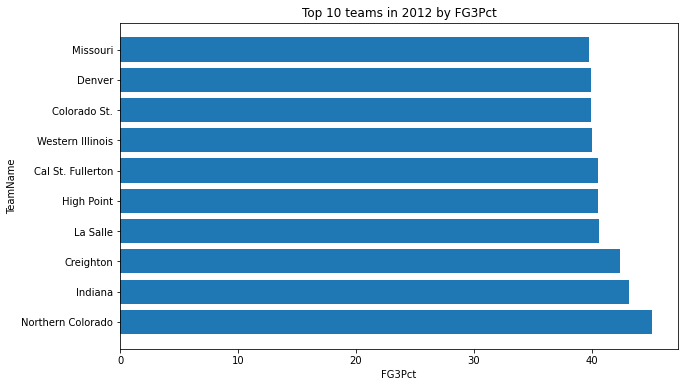

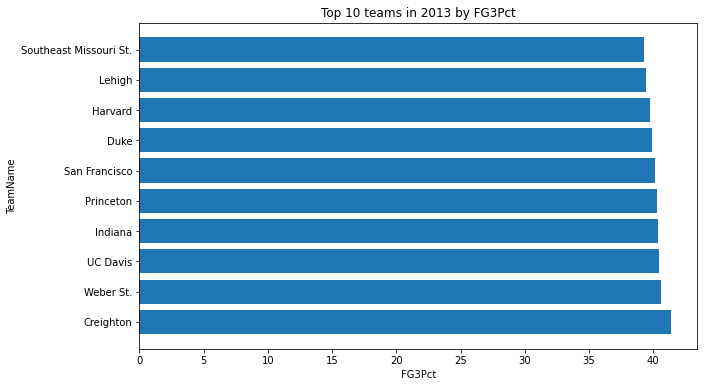

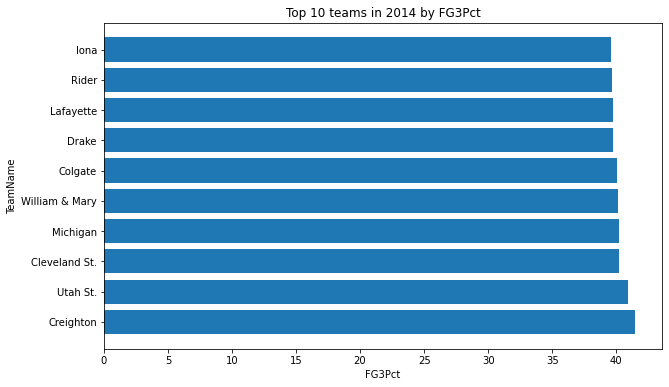

...

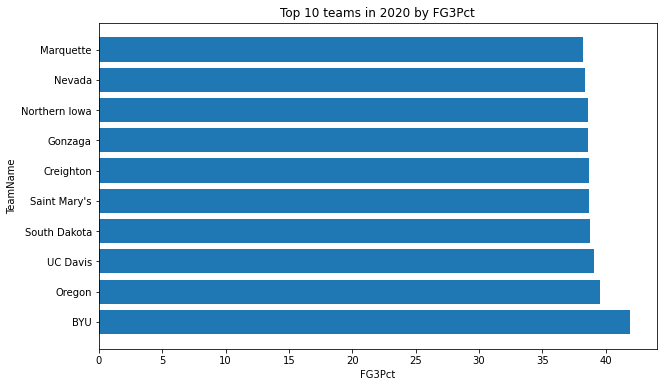

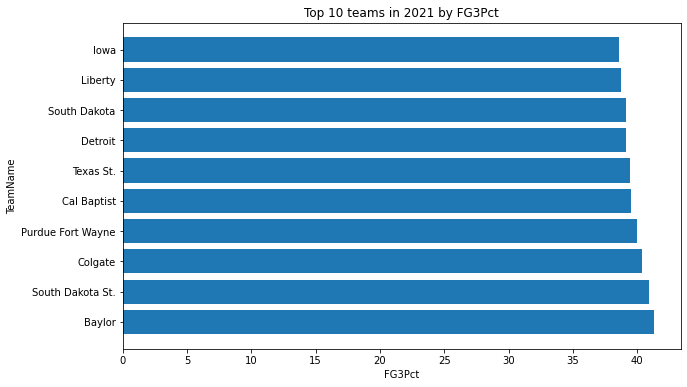

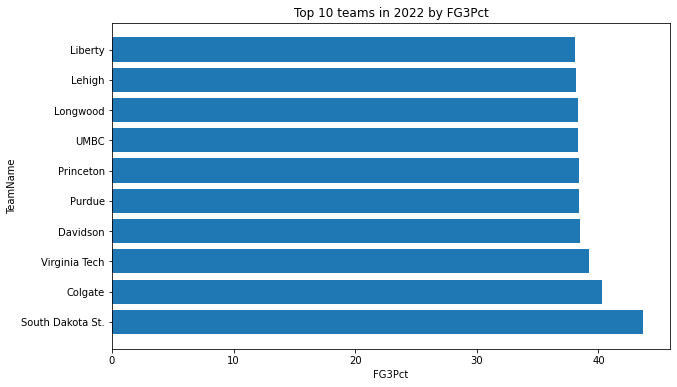

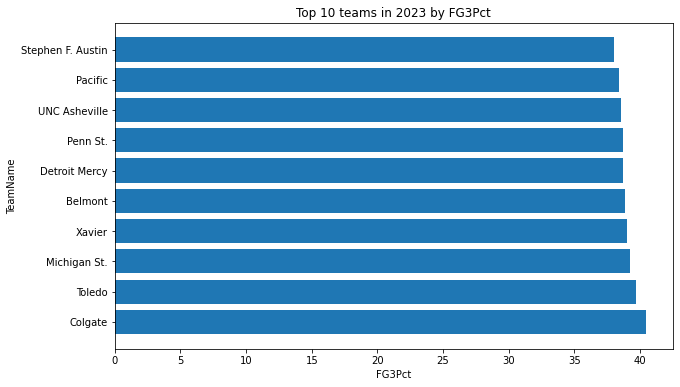

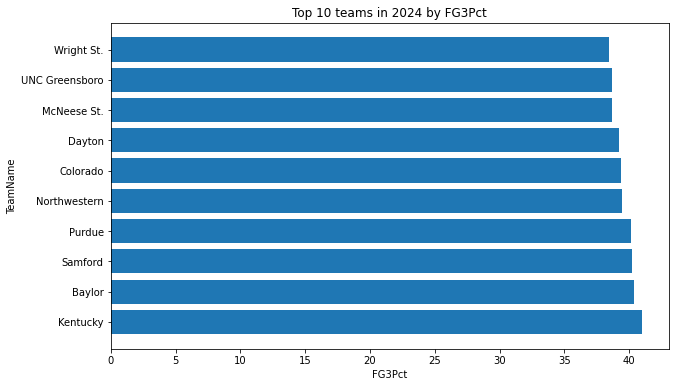

In [26]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankFG3Pct')
    
for season, df_season in sorted_by_season.items():
    top_10_fg3p = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_fg3p['TeamName'], top_10_fg3p['FG3Pct'])
    plt.xlabel('FG3Pct')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by FG3Pct')
    plt.show()

### Top 10 Teams By FT%

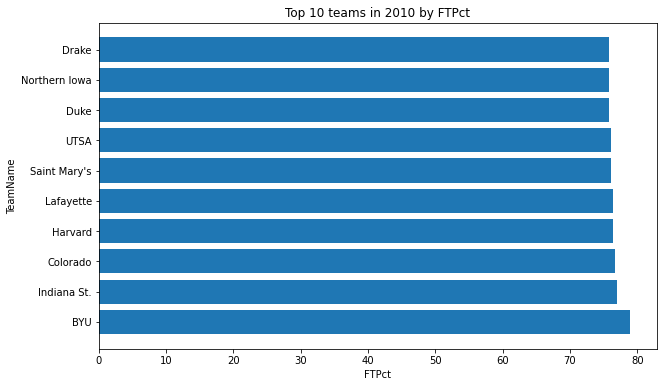

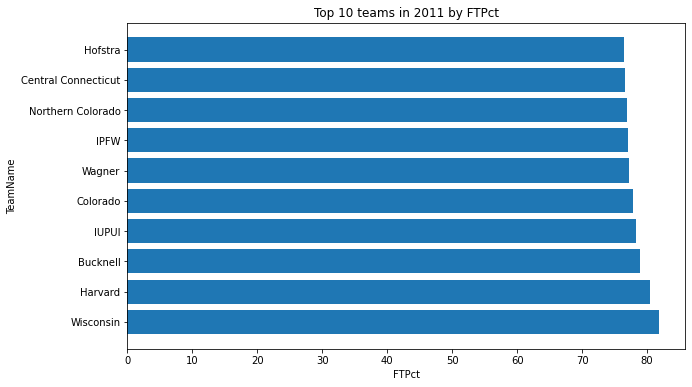

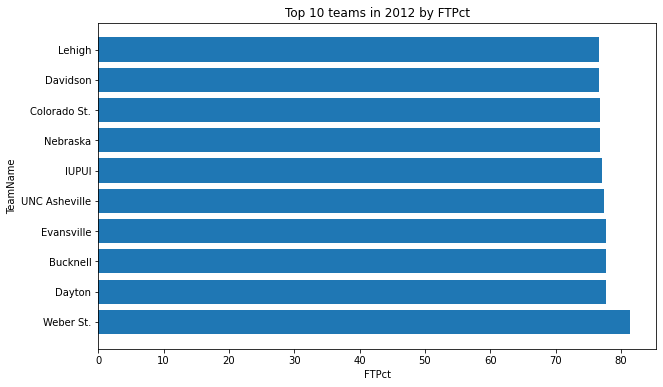

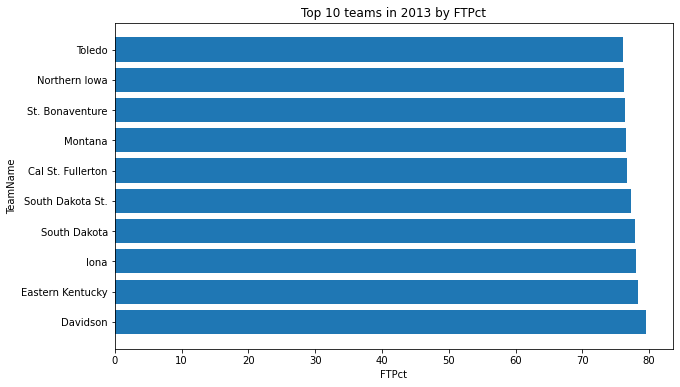

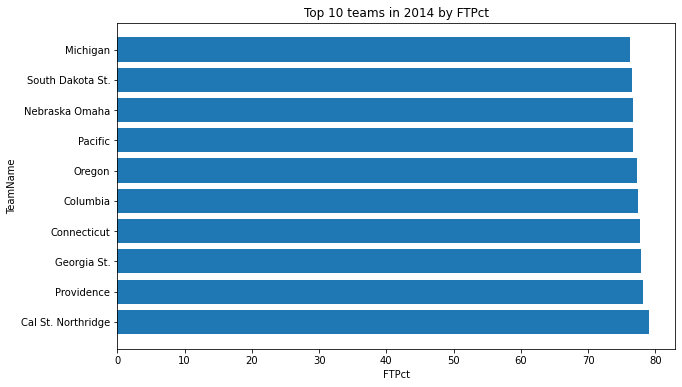

...

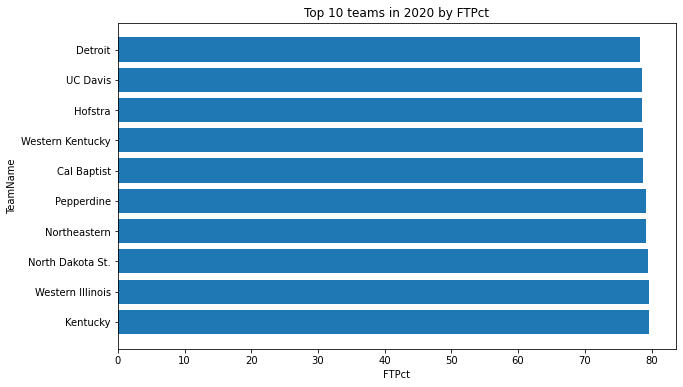

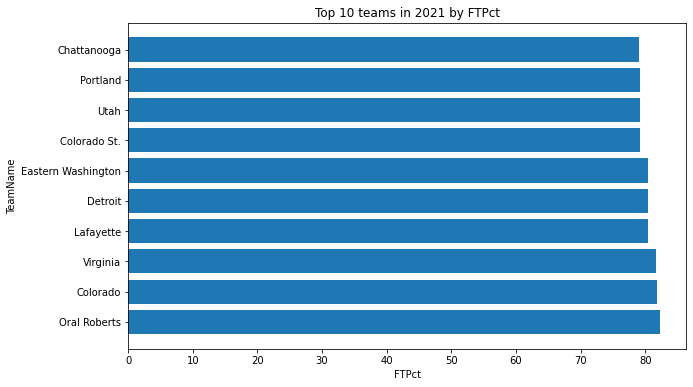

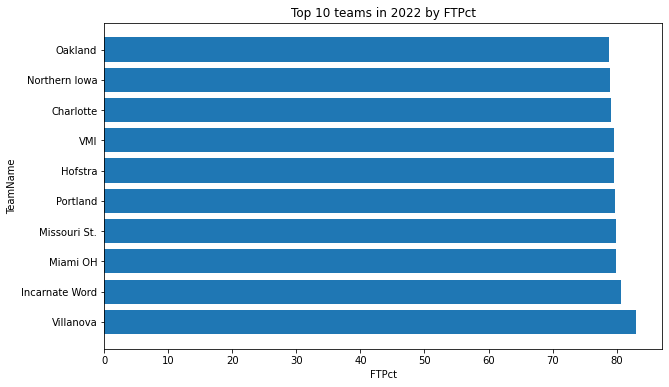

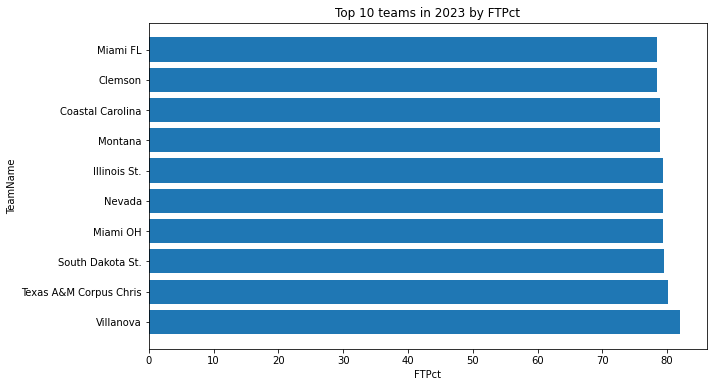

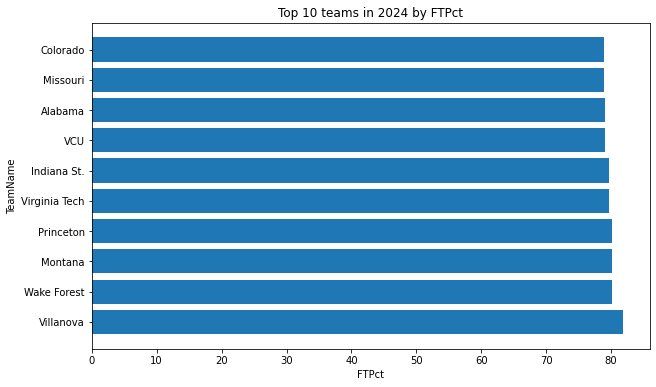

In [27]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankFTPct')
    
for season, df_season in sorted_by_season.items():
    top_10_ftp = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_ftp['TeamName'], top_10_ftp['FTPct'])
    plt.xlabel('FTPct')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by FTPct')
    plt.show()

### Top 10 Teams By Block %

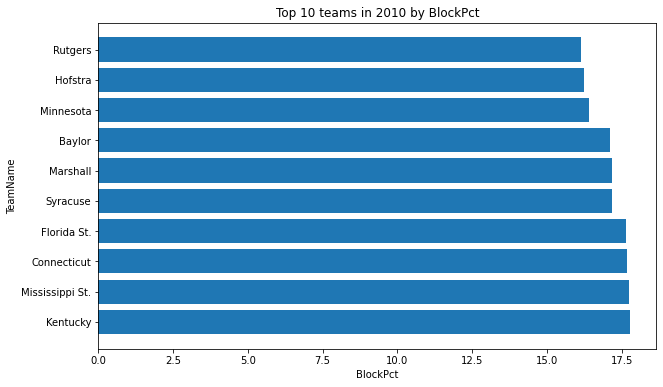

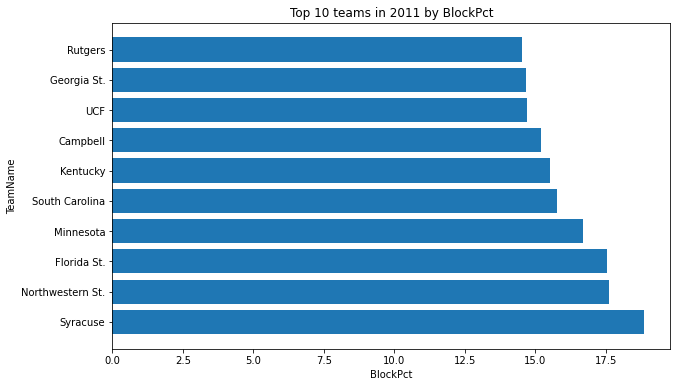

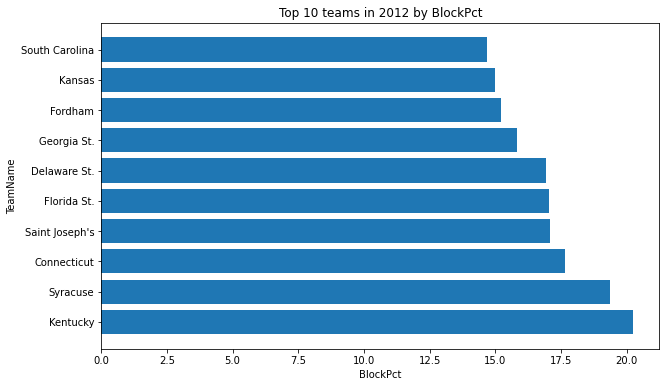

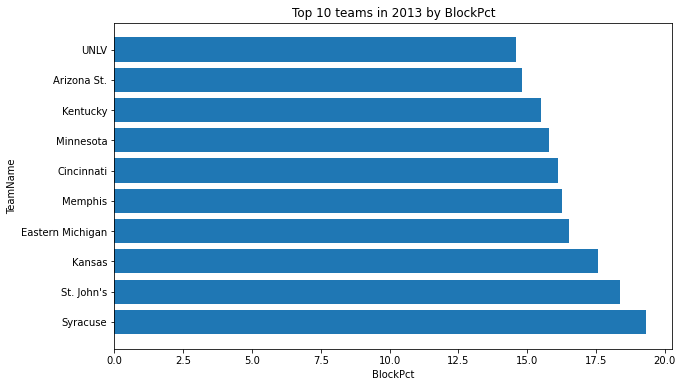

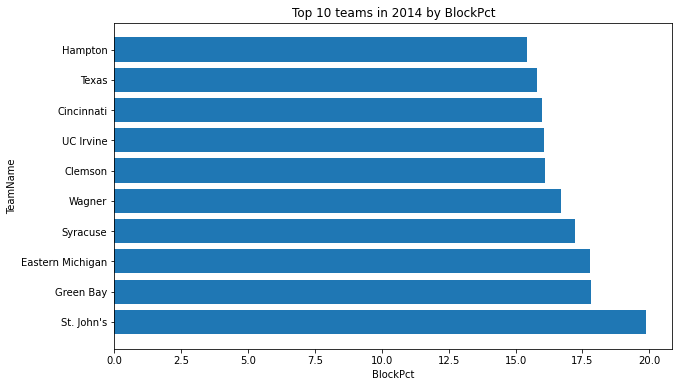

...

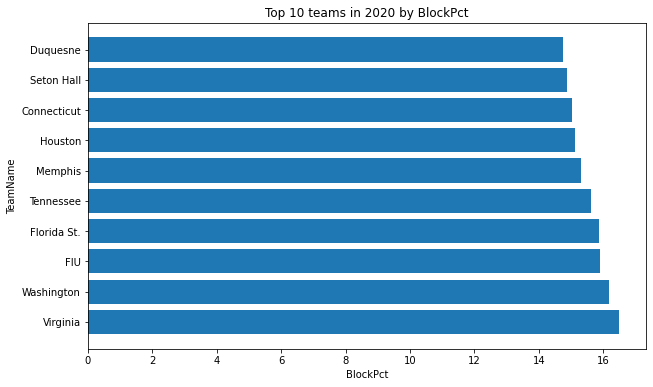

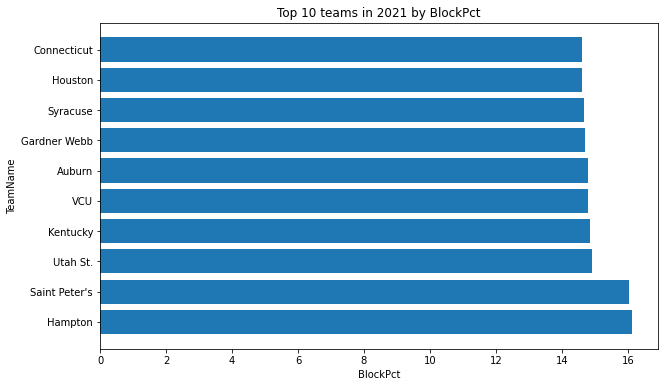

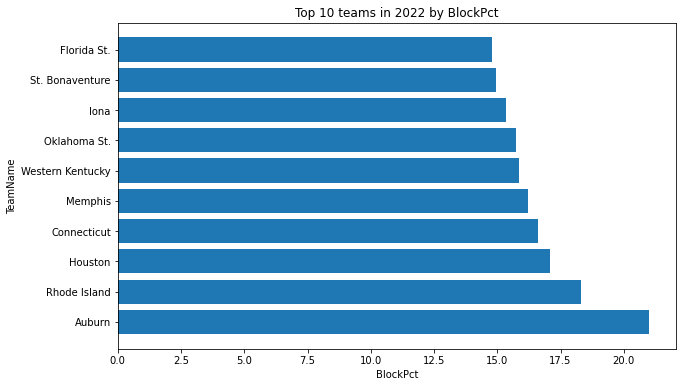

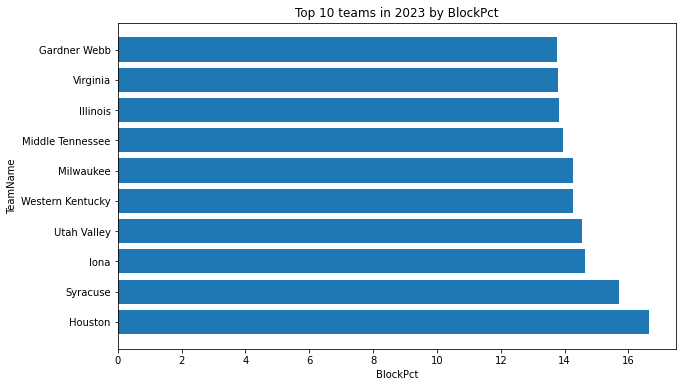

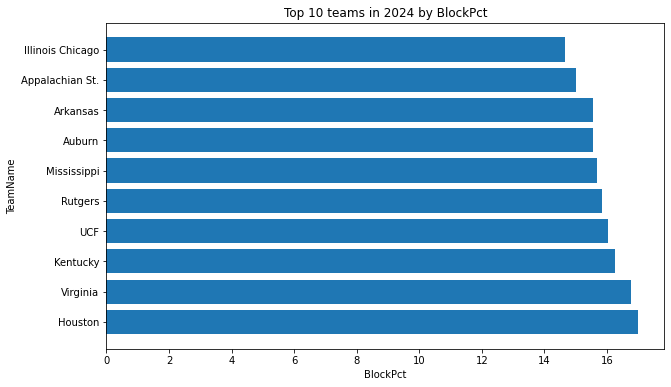

In [28]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankBlockPct')
    
for season, df_season in sorted_by_season.items():
    top_10_block = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_block['TeamName'], top_10_block['BlockPct'])
    plt.xlabel('BlockPct')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by BlockPct')
    plt.show()

### Top 10 Teams By Opposing 2-Point FG%

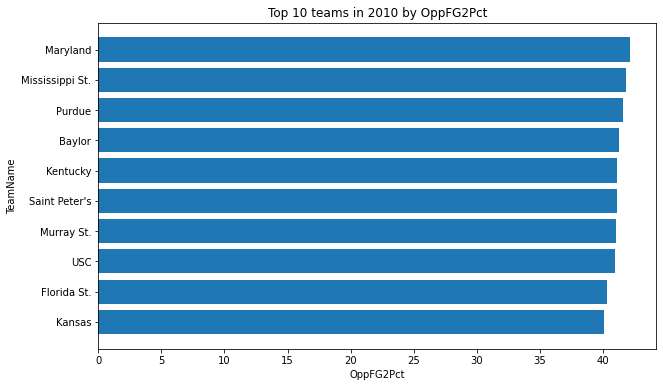

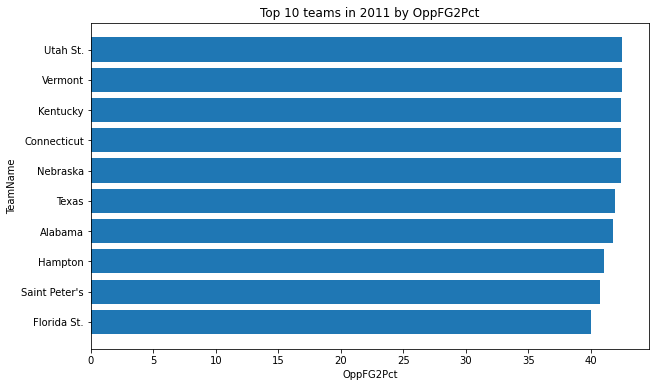

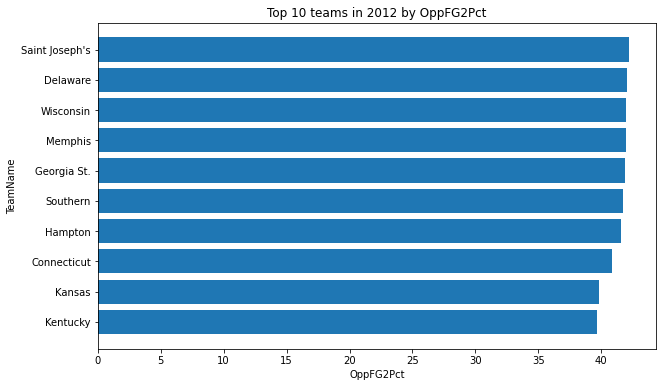

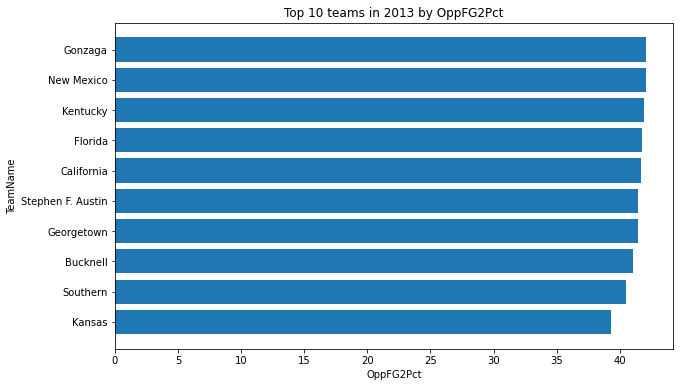

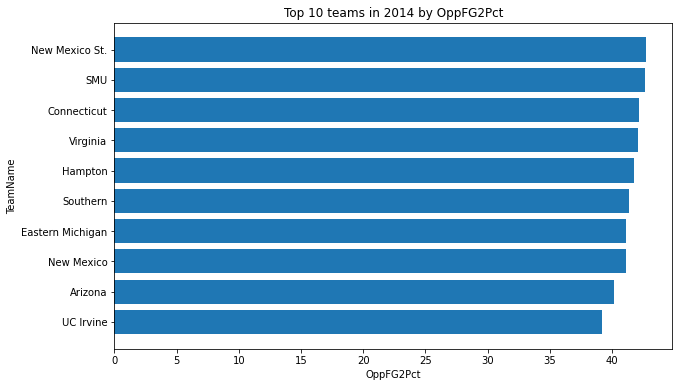

...

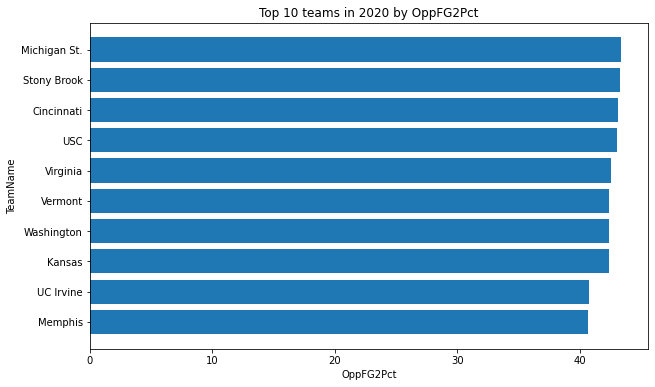

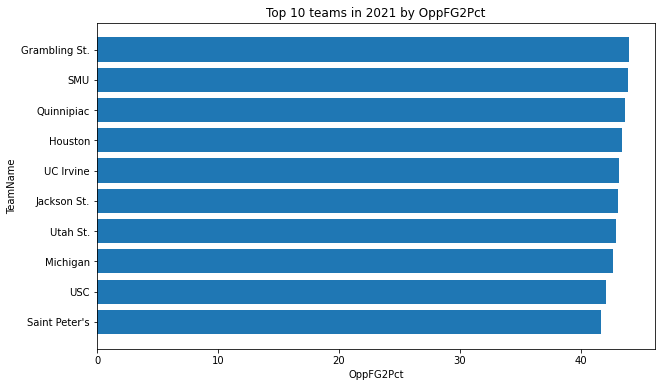

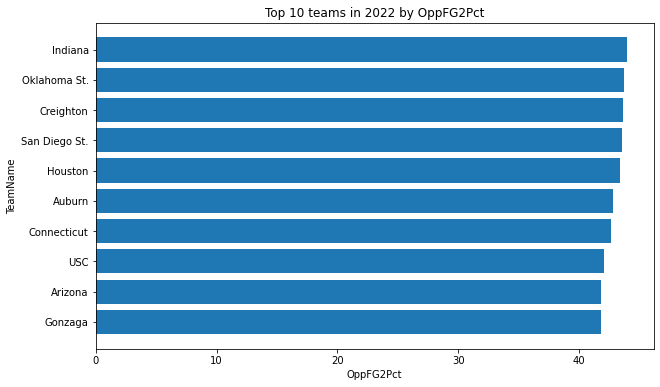

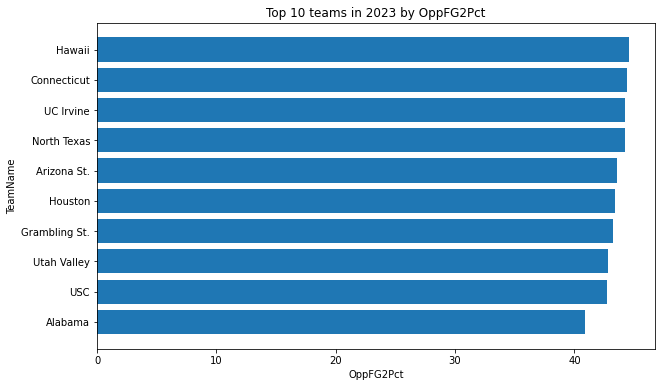

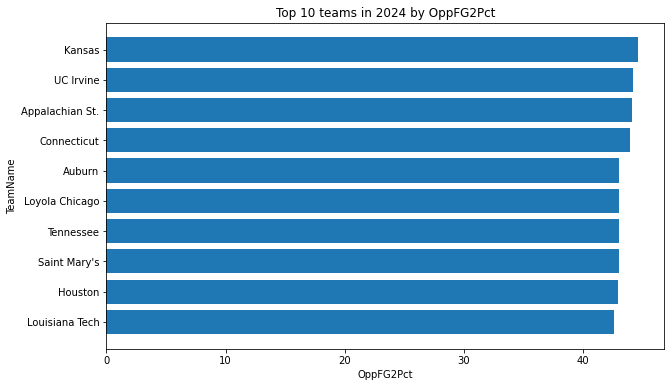

In [29]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankOppFG2Pct')
    
for season, df_season in sorted_by_season.items():
    top_10_ofg2p = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_ofg2p['TeamName'], top_10_ofg2p['OppFG2Pct'])
    plt.xlabel('OppFG2Pct')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by OppFG2Pct')
    plt.show()

### Top 10 Teams By Opposing 3-Point FG%

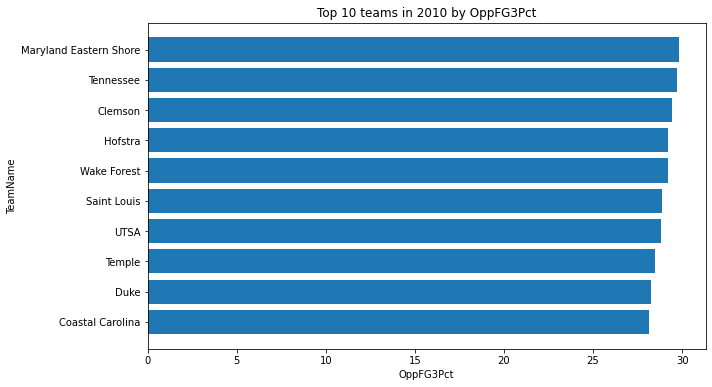

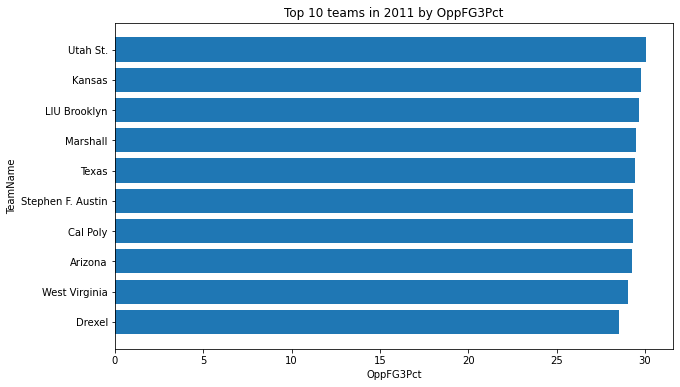

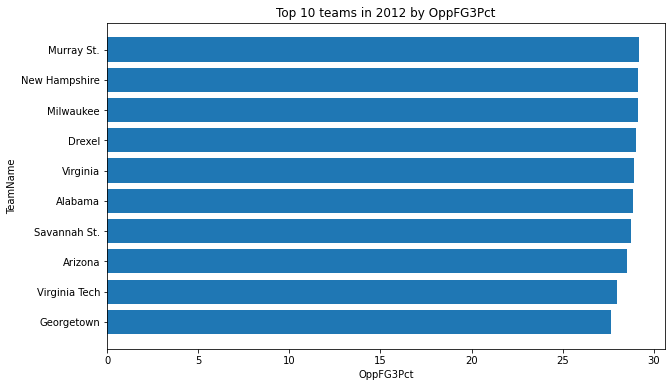

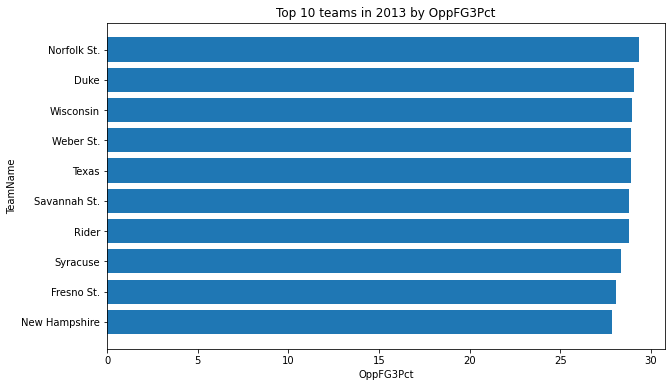

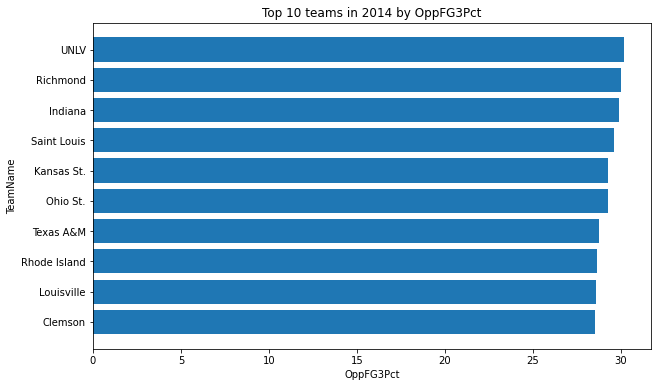

...

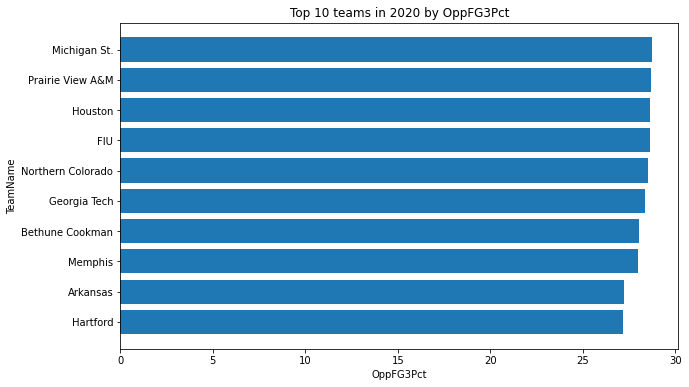

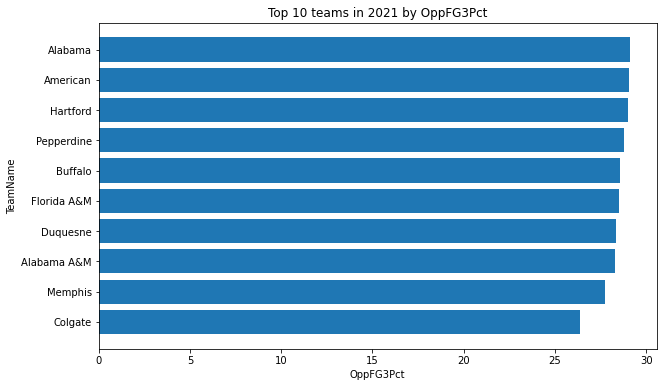

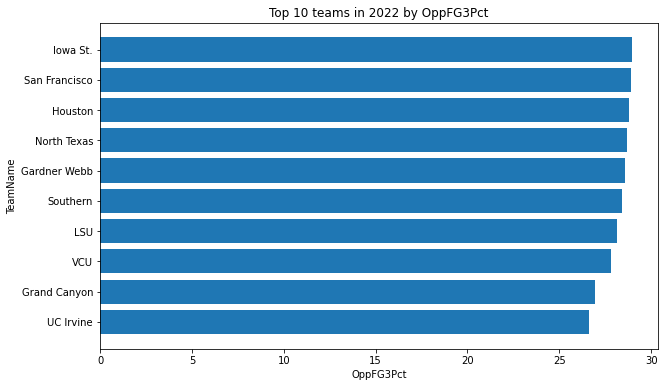

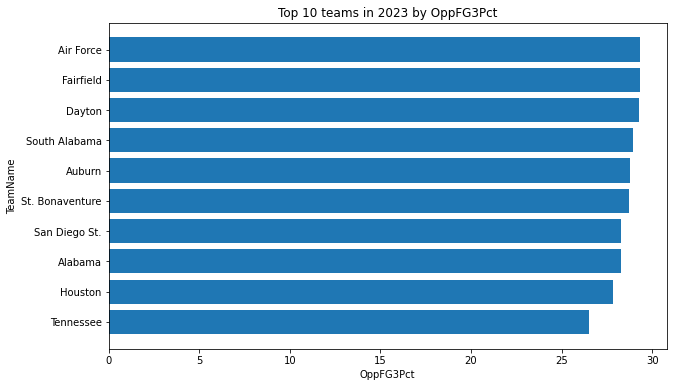

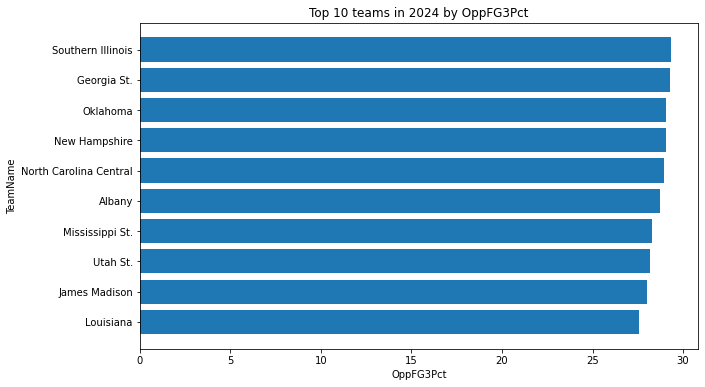

In [30]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankOppFG3Pct')
    
for season, df_season in sorted_by_season.items():
    top_10_ofg3p = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_ofg3p['TeamName'], top_10_ofg3p['OppFG3Pct'])
    plt.xlabel('OppFG3Pct')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by OppFG3Pct')
    plt.show()

### Top 10 Teams By Opposing FT%

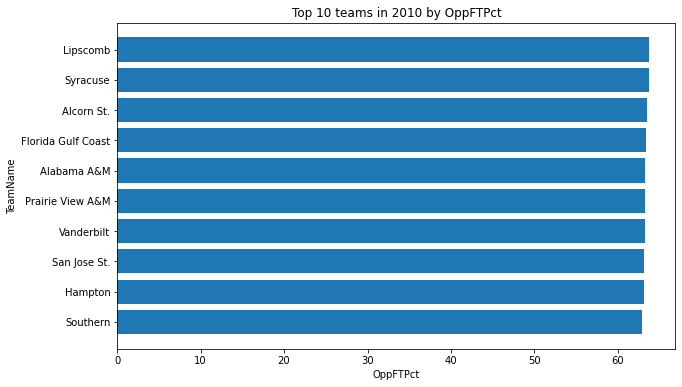

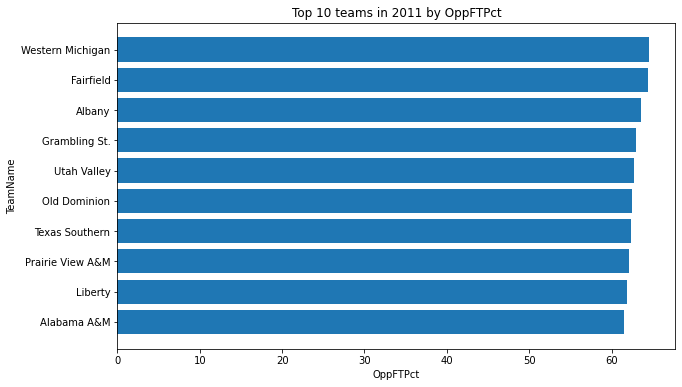

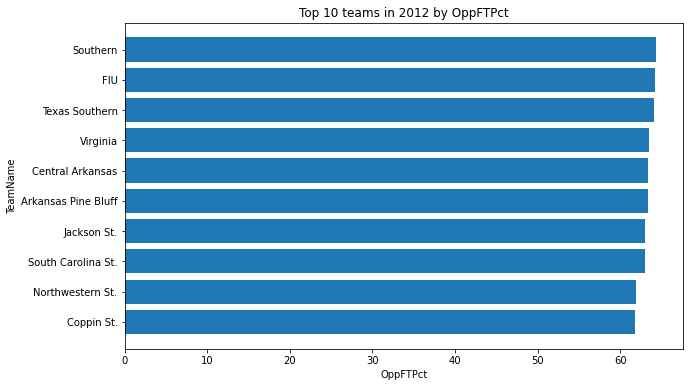

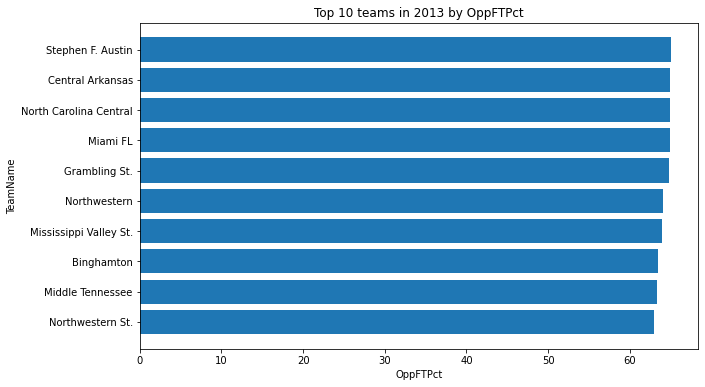

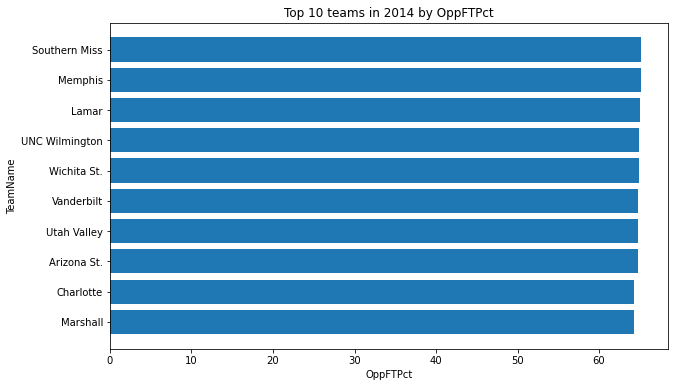

...

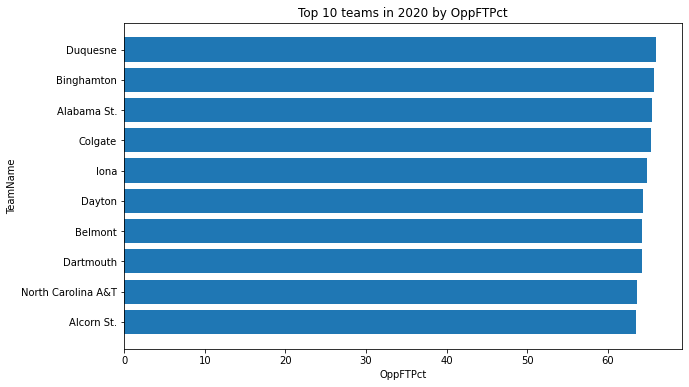

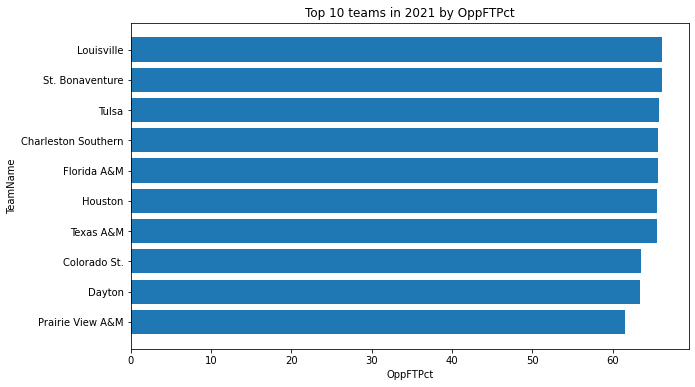

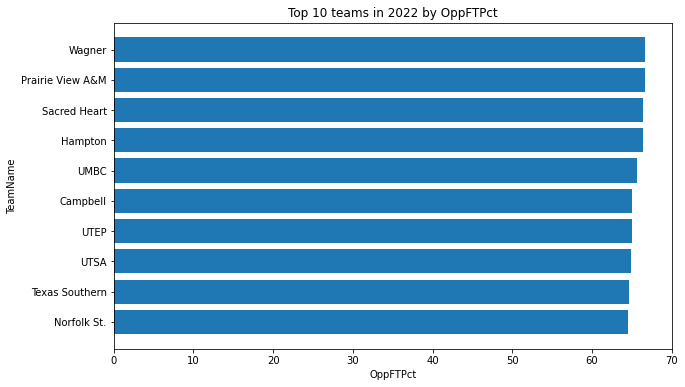

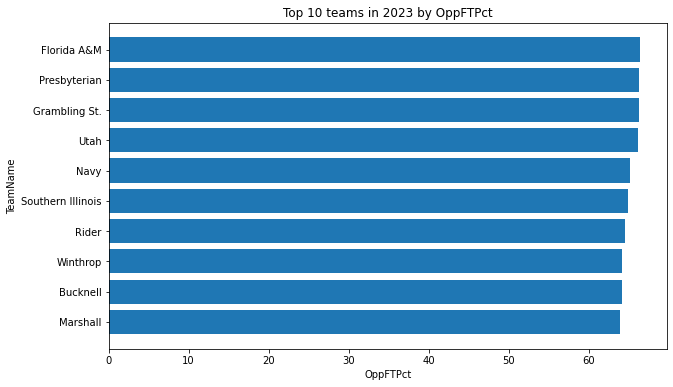

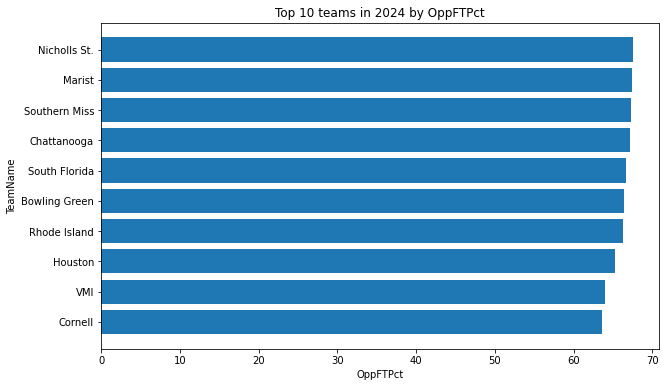

In [31]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankOppFTPct')
    
for season, df_season in sorted_by_season.items():
    top_10_oft = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_oft['TeamName'], top_10_oft['OppFTPct'])
    plt.xlabel('OppFTPct')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by OppFTPct')
    plt.show()

### Top 10 Teams By Opposing Block %

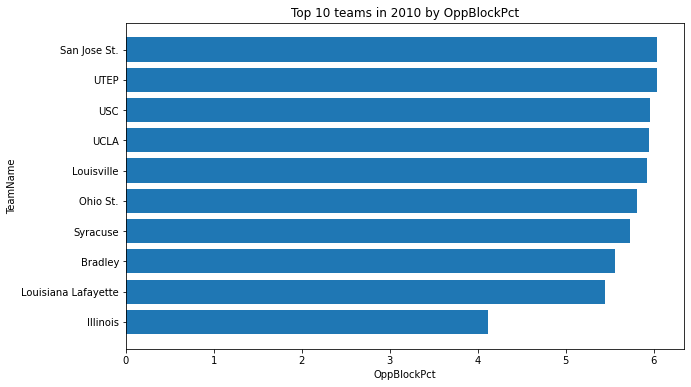

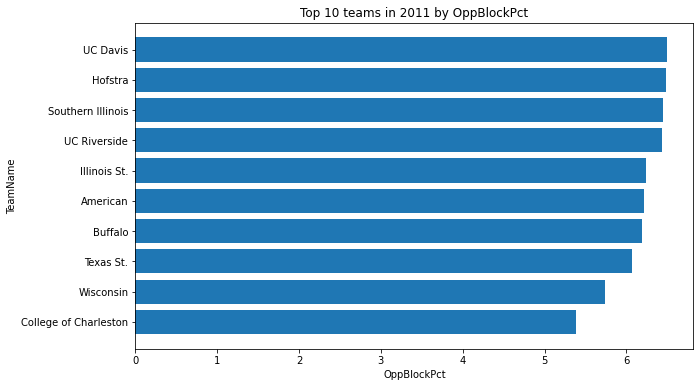

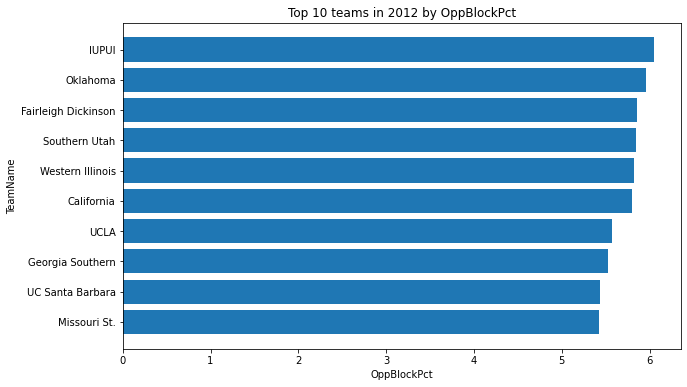

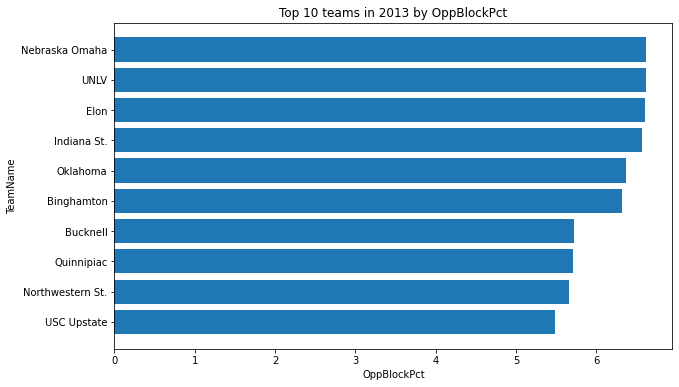

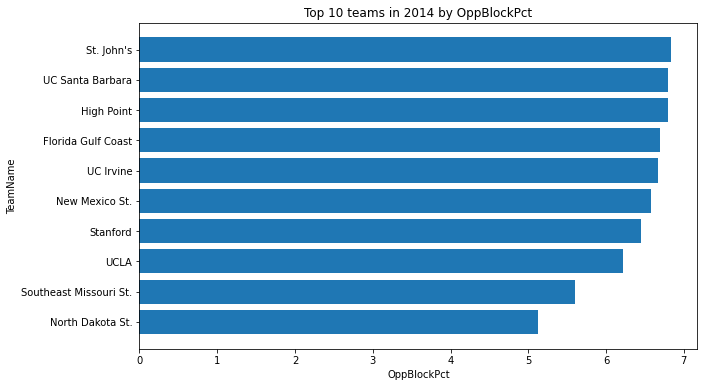

...

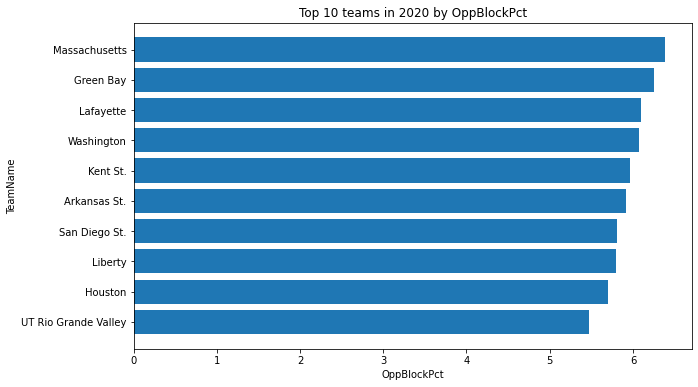

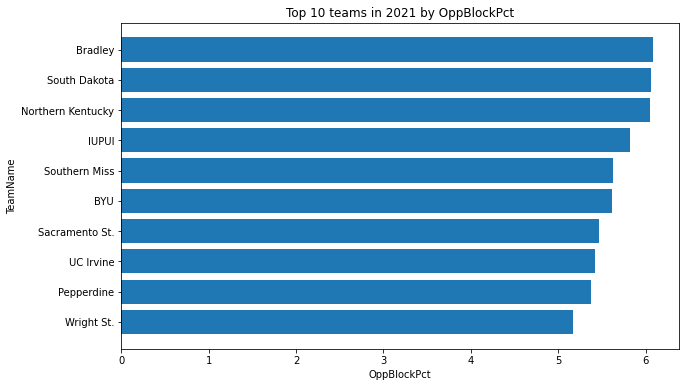

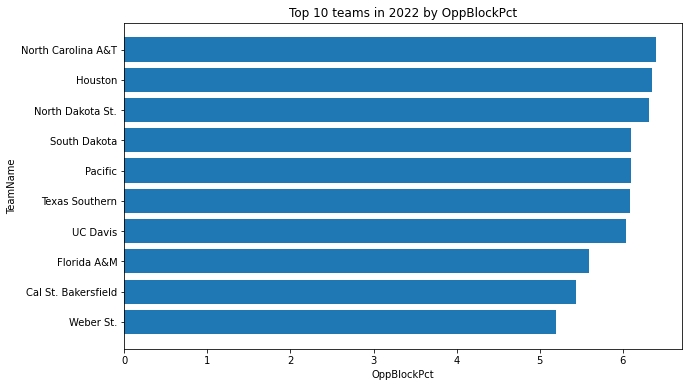

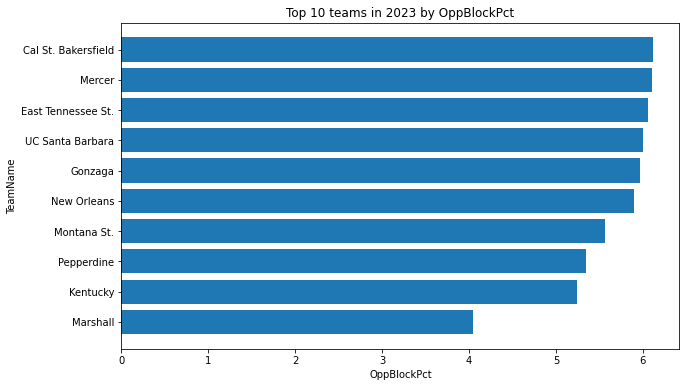

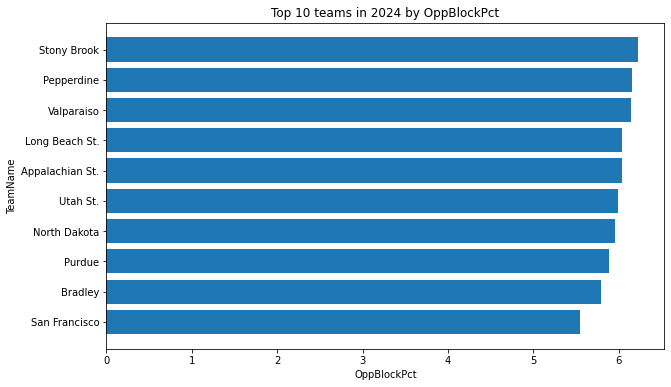

In [32]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankOppBlockPct')
    
for season, df_season in sorted_by_season.items():
    top_10_oblock = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_oblock['TeamName'], top_10_oblock['OppBlockPct'])
    plt.xlabel('OppBlockPct')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by OppBlockPct')
    plt.show()

### Top 10 Teams By Assist Rate

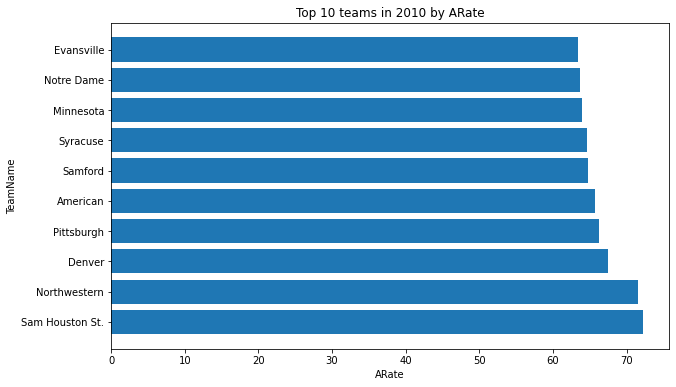

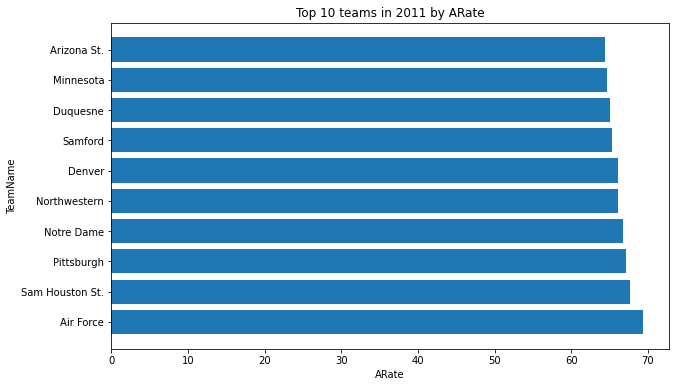

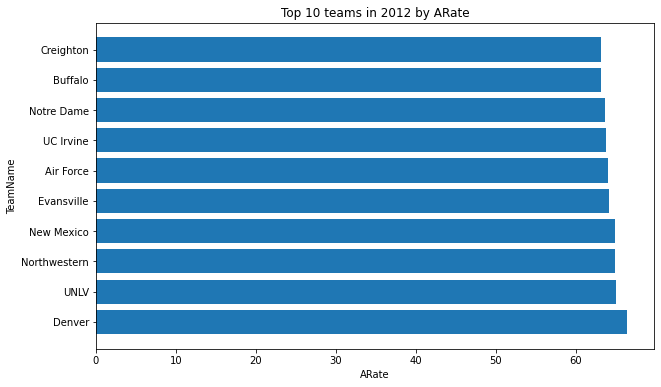

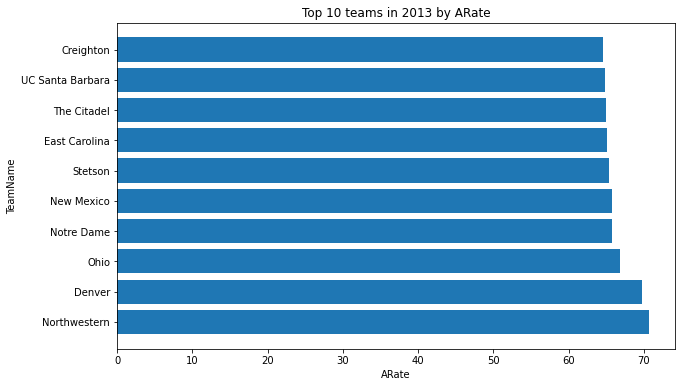

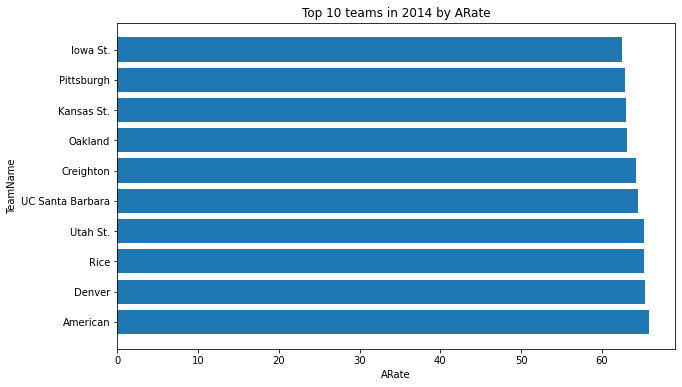

...

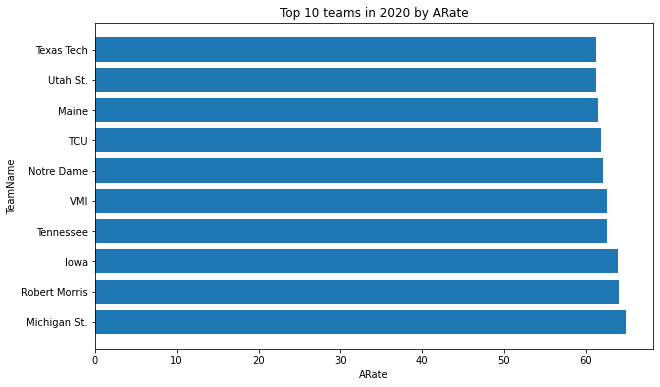

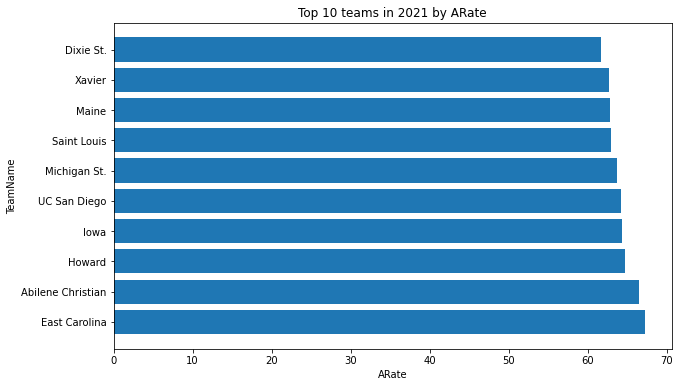

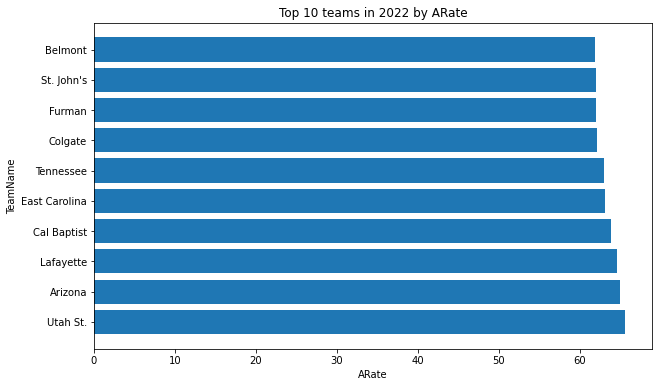

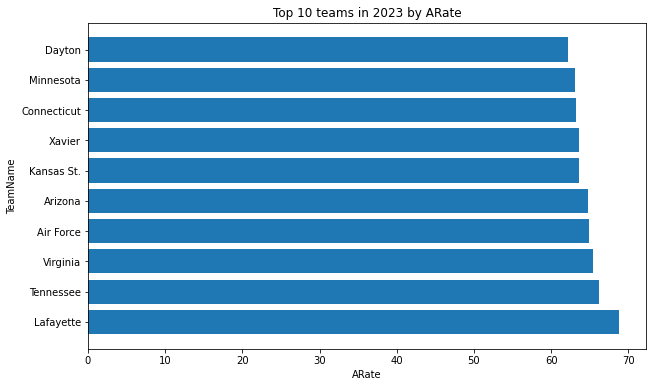

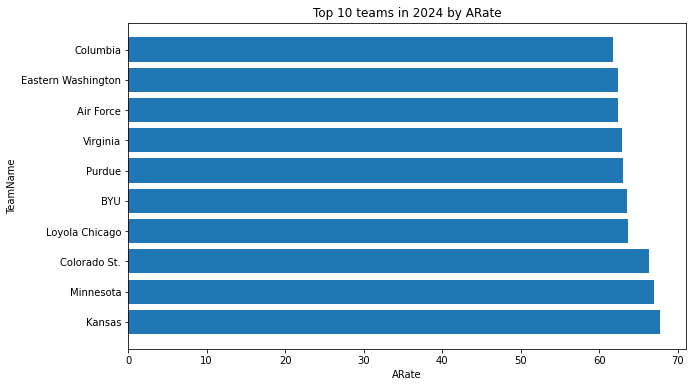

In [33]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankARate')
    
for season, df_season in sorted_by_season.items():
    top_10_arate = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_arate['TeamName'], top_10_arate['ARate'])
    plt.xlabel('ARate')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by ARate')
    plt.show()

### Top 10 Teams By Opposing Assist Rate

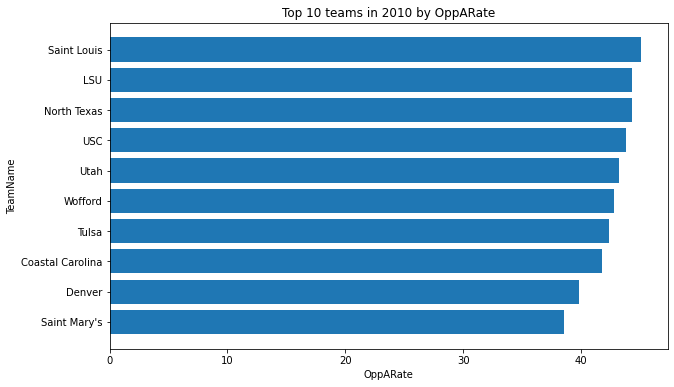

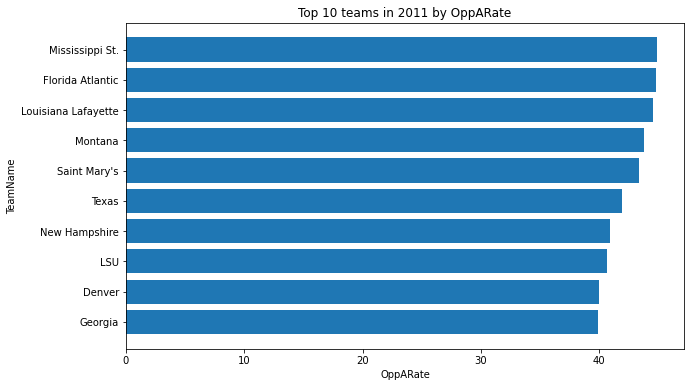

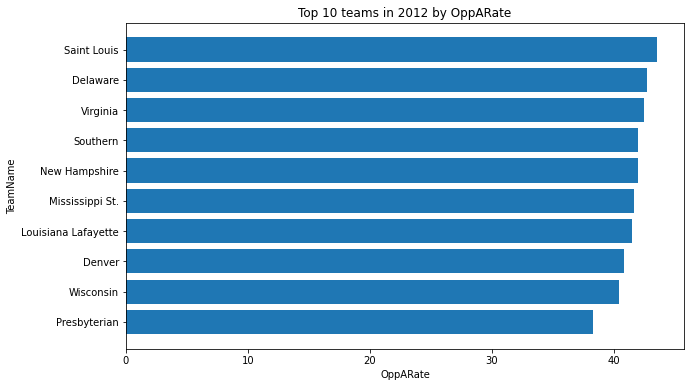

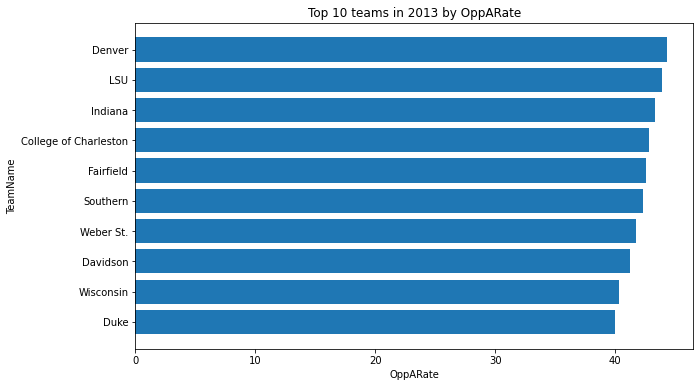

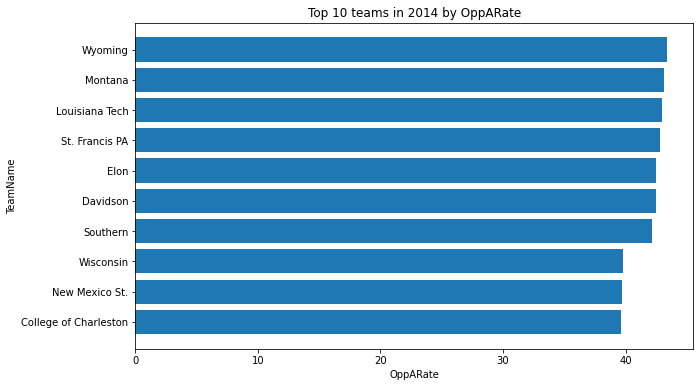

...

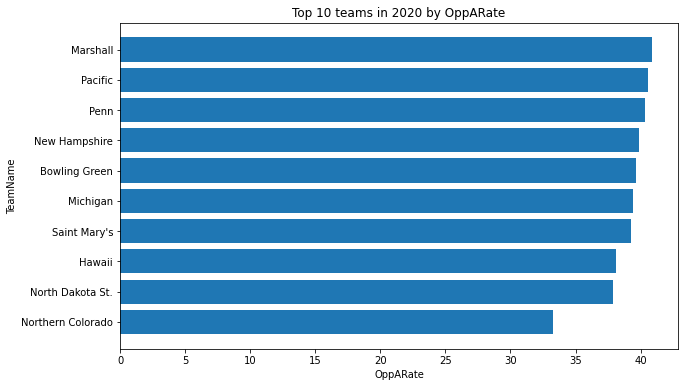

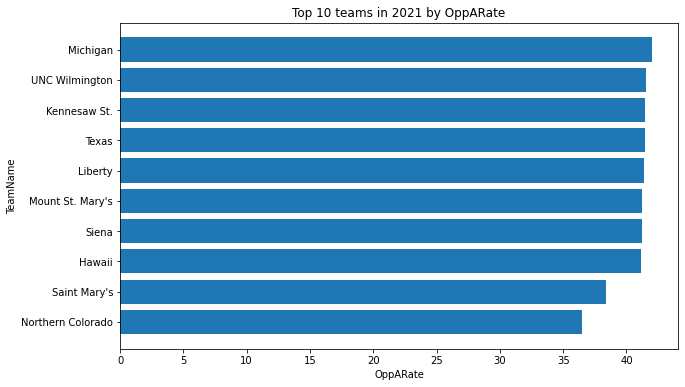

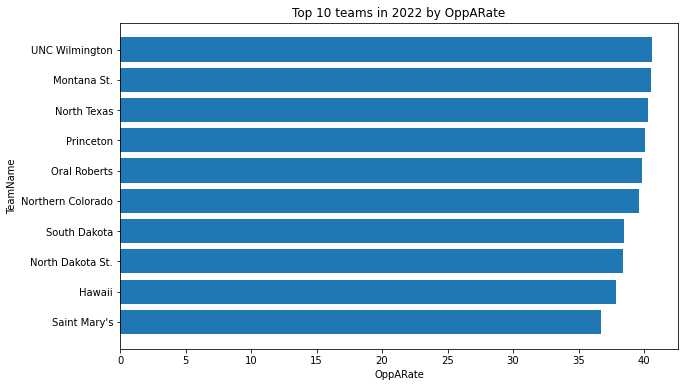

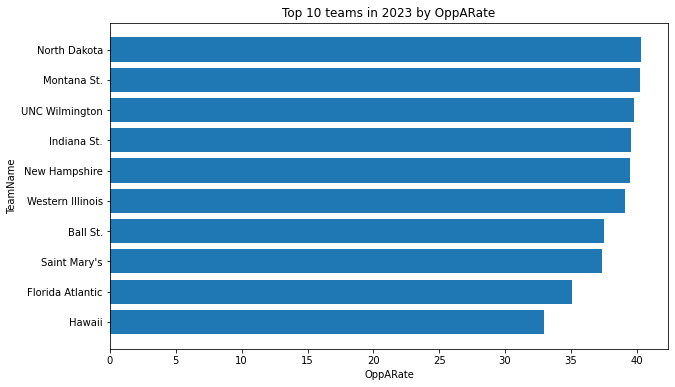

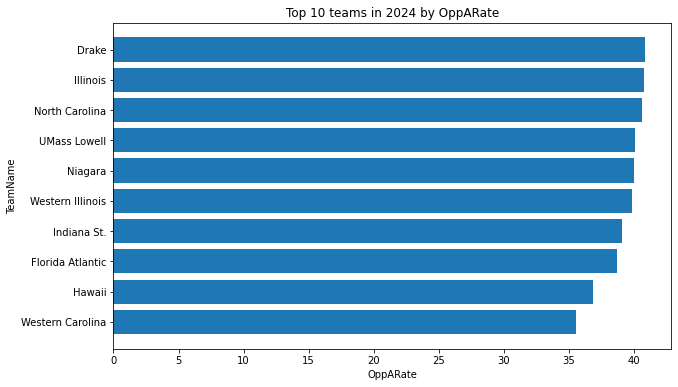

In [34]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankOppARate')
    
for season, df_season in sorted_by_season.items():
    top_10_oarate = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_oarate['TeamName'], top_10_oarate['OppARate'])
    plt.xlabel('OppARate')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by OppARate')
    plt.show()

### Top 10 Teams By Steal Rate

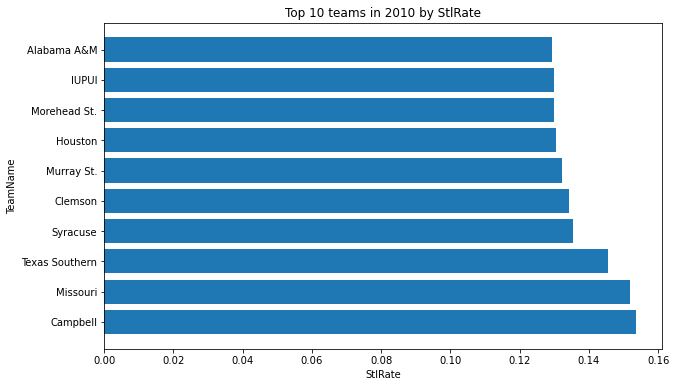

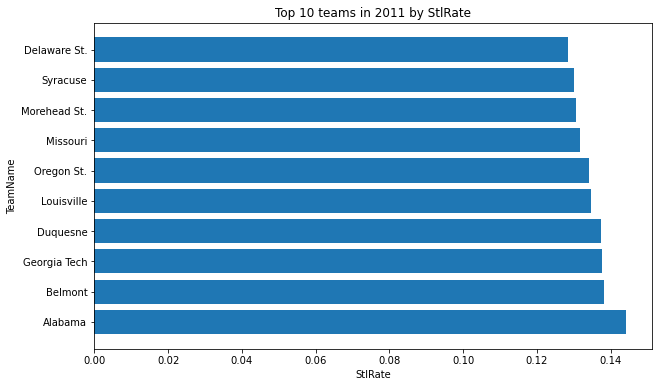

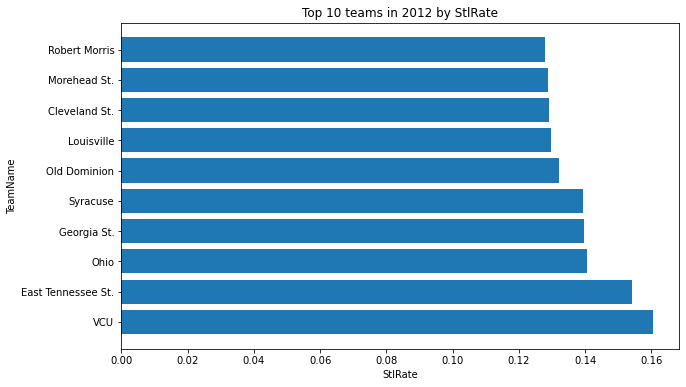

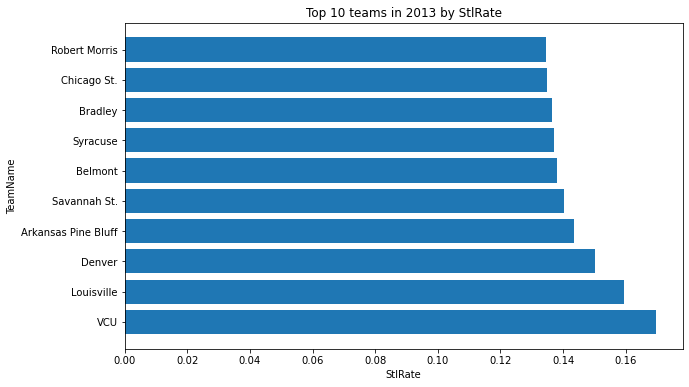

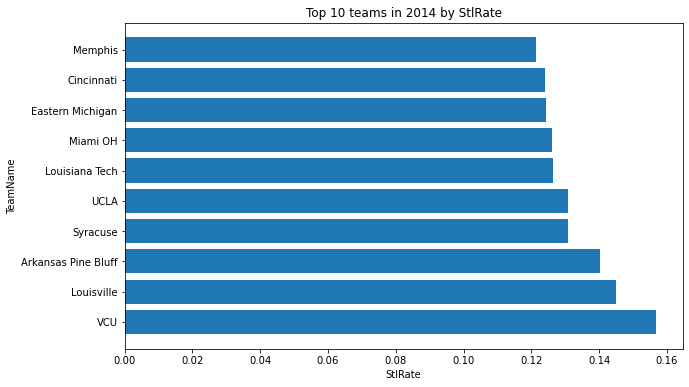

...

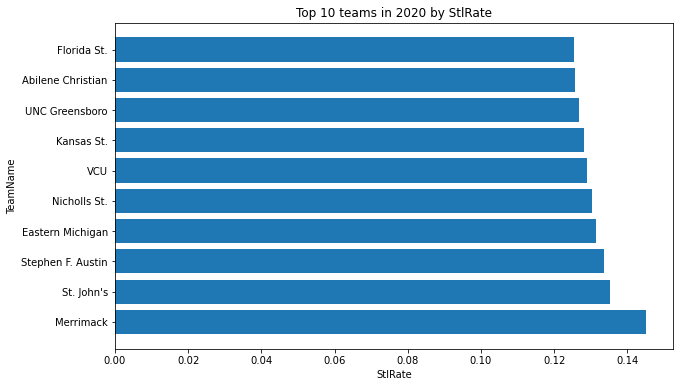

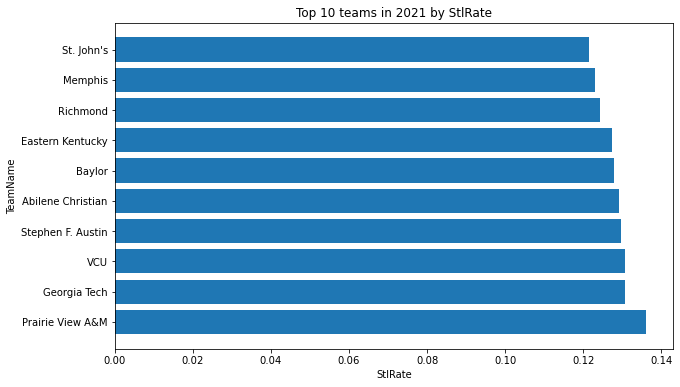

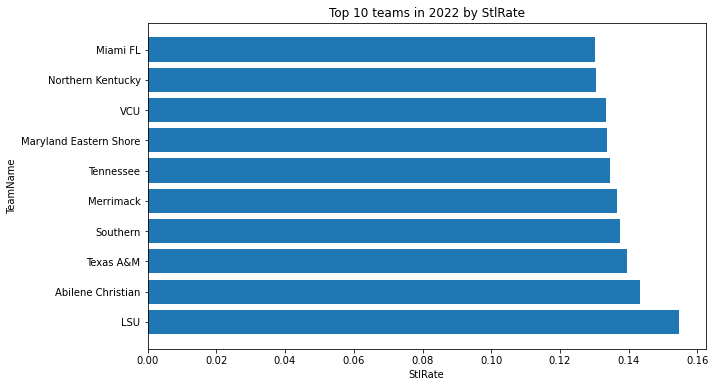

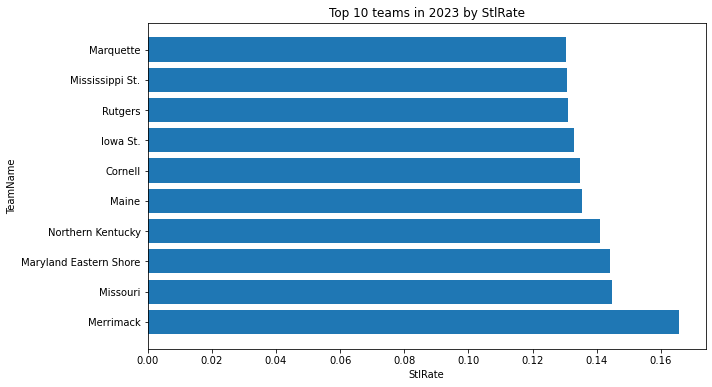

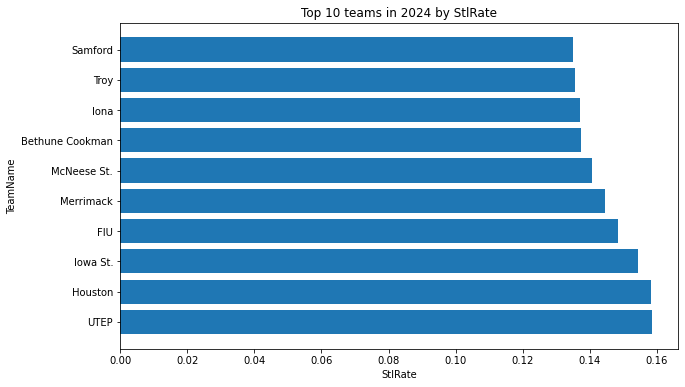

In [35]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankStlRate')
    
for season, df_season in sorted_by_season.items():
    top_10_stl = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_stl['TeamName'], top_10_stl['StlRate'])
    plt.xlabel('StlRate')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by StlRate')
    plt.show()

### Top 10 Teams By Opposing Steal Rate

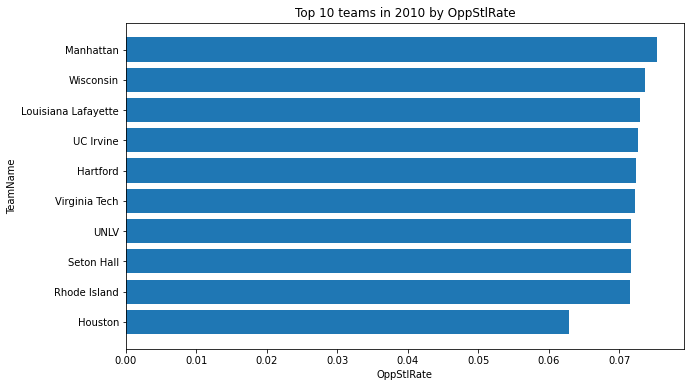

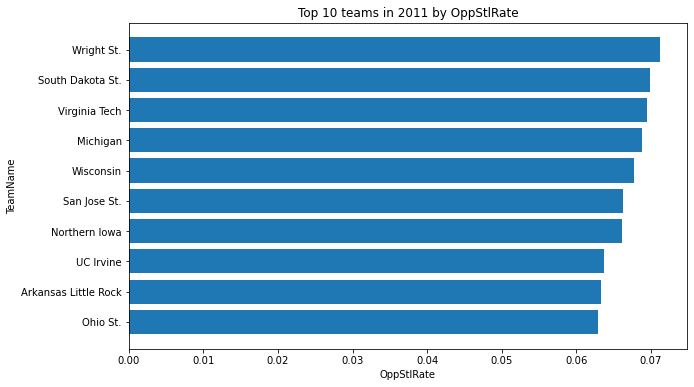

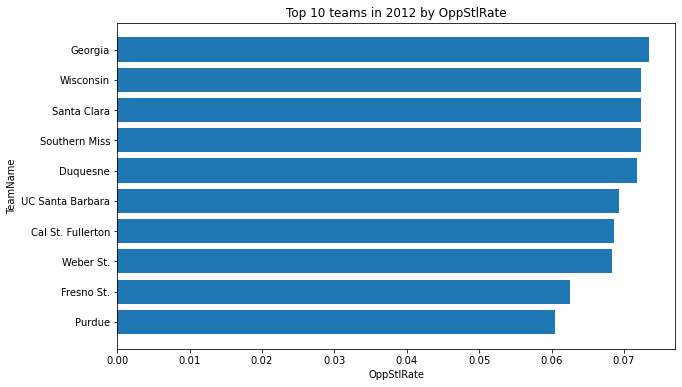

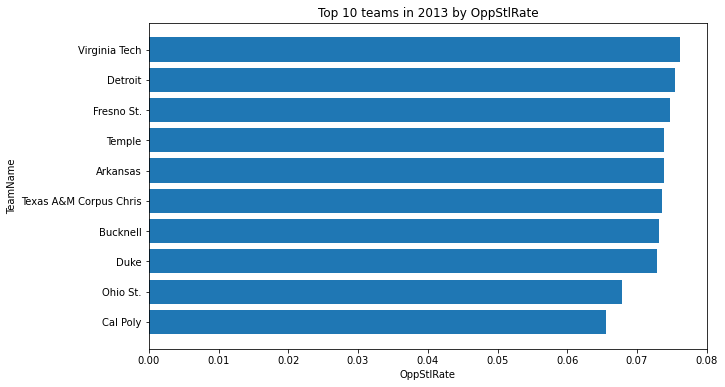

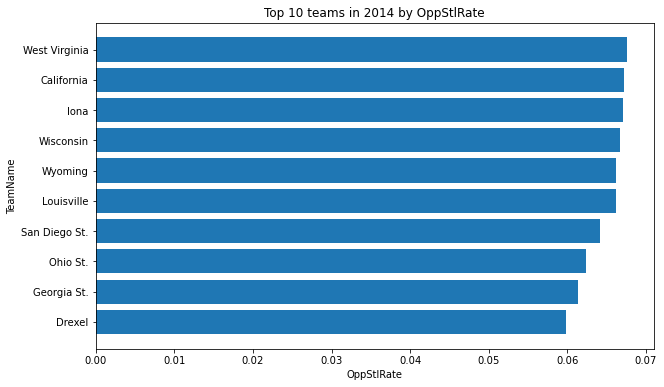

...

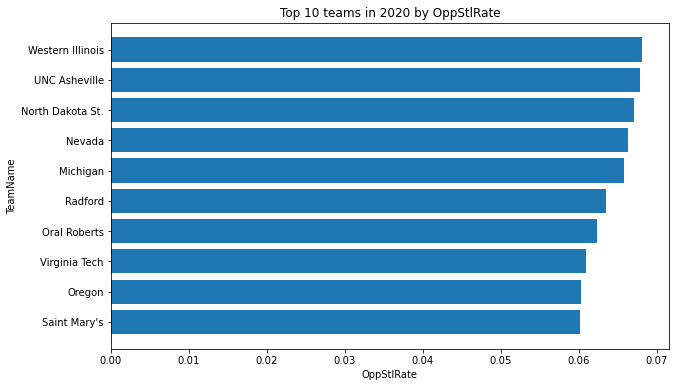

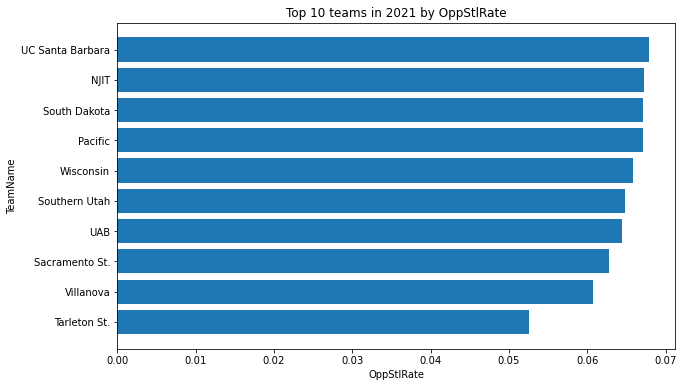

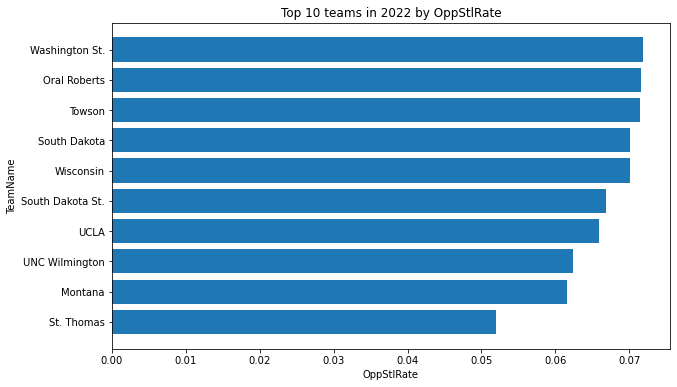

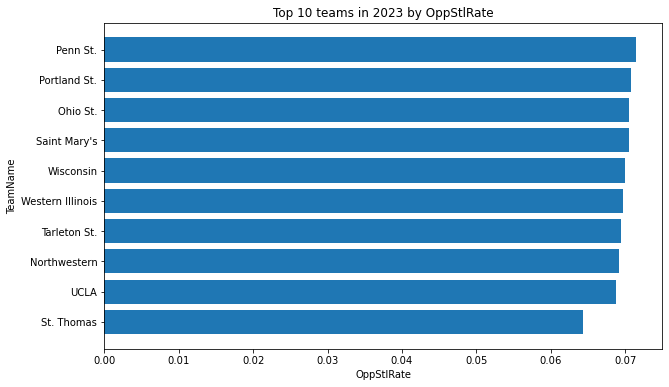

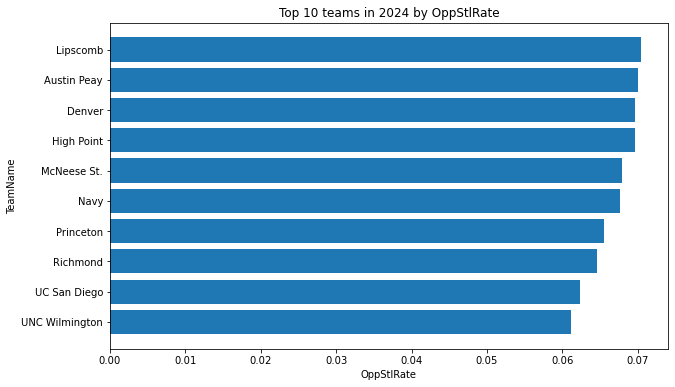

In [36]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankOppStlRate')
    
for season, df_season in sorted_by_season.items():
    top_10_ostl = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_ostl['TeamName'], top_10_ostl['OppStlRate'])
    plt.xlabel('OppStlRate')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by OppStlRate')
    plt.show()

### Misc Dataframe K-Means Clustering

In [37]:
# clustering features
features = ['FG2Pct', 'RankFG2Pct', 'FG3Pct','RankFG3Pct','FTPct','RankFTPct','BlockPct',
            'RankBlockPct','OppFG2Pct','RankOppFG2Pct','OppFG3Pct','RankOppFG3Pct','OppFTPct',
            'RankOppFTPct','OppBlockPct','RankOppBlockPct','ARate','RankARate','OppARate',
            'RankOppARate','StlRate','RankStlRate','OppStlRate','RankOppStlRate']

for season in misc_df['Season'].unique():
    # select data for the current season
    season_data_misc = misc_df[misc_df['Season'] == season].copy()
    
    X = season_data_misc[features]

    # scaling
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # perform PCA for dimensionality reduction
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)

    # initialize KMeans
    kmeans = KMeans(n_clusters=5, random_state=42)

    # fit the model
    kmeans.fit(X_scaled)

    # predict cluster assignments
    clusters = kmeans.predict(X_scaled)

    # add cluster assignments to the df
    season_data_misc['MiscCluster'] = clusters

    # create a df with team names and statistics for hover-over
    hover_data = season_data_misc[['TeamName'] + features + ['MiscCluster']]

    # identify winner for each season
    winner = None
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut' 

    # visualize clusters using Plotly
    fig = px.scatter(season_data_misc, x=X_pca[:, 0], y=X_pca[:, 1], color='MiscCluster', hover_name='TeamName',
                     hover_data=hover_data, labels={'x': 'Principal Component 1', 'y': 'Principal Component 2', 'Cluster': 'Cluster'},
                     title=f'Clusters Visualization (PCA) Misc - Season {season}')

    # highlight the winner with a different marker style
    if winner is not None:
        winner_data = season_data_misc[season_data_misc['TeamName'] == winner]
        winner_hovertext = [f"{winner}\nCluster: {winner_data['MiscCluster'].iloc[0]}"]  # Add cluster to hovertext
        for feature in features:
            winner_hovertext.append(f"{feature}: {winner_data[feature].iloc[0]}")  # Add statistics to hovertext
        fig.add_trace(go.Scatter(x=[X_pca[0, 0]], y=[X_pca[0, 1]], mode='markers', marker=dict(symbol='star', color='black', size=12),
                                 hovertext=winner_hovertext, showlegend=False))

    fig.show()


In [38]:
winners_misc_clusters = [3, 3, 1, 4, 0, 0, 3, 3, 2, 3, 1, 2, 3]

# define a list containing winners and seasons
winners_data = []

# define a list to store filtered df's
winners_misc_dfs = []

for season in range(2010, 2025):
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut'
    else:
        winner = None  # For seasons not mentioned
    
    # append to winners_data list
    winners_data.append({'Season': season, 'Winner': winner})
    
    # filter final_def_df for the current season and winner
    winners_misc_df = misc_df[(misc_df['Season'] == season) & (misc_df['TeamName'] == winner)]
    winners_misc_dfs.append(winners_misc_df)

# concatenate all filtered df's
all_winners_misc_df = pd.concat(winners_misc_dfs, ignore_index=True)

all_winners_misc_df['MiscCluster'] = winners_misc_clusters

# inspect
all_winners_misc_df

,Season,TeamName,FG2Pct,RankFG2Pct,FG3Pct,RankFG3Pct,FTPct,RankFTPct,BlockPct,RankBlockPct,...,RankOppBlockPct,ARate,RankARate,OppARate,RankOppARate,StlRate,RankStlRate,OppStlRate,RankOppStlRate,MiscCluster
0,2010,Duke,46.981100,201,38.491000,25,75.862100,8,9.842000,131,...,215,52.767200,189,48.697600,56,0.099600,148,0.078900,17,3
1,2011,Connecticut,47.671700,180,32.911400,237,76.277400,12,13.571400,19,...,103,50.712300,238,51.490200,110,0.094800,154,0.091500,149,3
2,2012,Kentucky,52.692100,21,37.815100,37,72.281400,67,20.236700,1,...,81,48.448900,292,47.244100,40,0.090900,204,0.081900,43,1
3,2013,Louisville,50.807500,47,33.285100,200,70.869600,123,12.060300,54,...,82,55.725200,119,49.697000,73,0.159300,2,0.083000,35,4
4,2014,Connecticut,48.135100,195,38.731400,24,77.684000,4,15.231800,12,...,112,50.257500,205,51.708400,171,0.106600,43,0.086500,132,0
5,2015,Duke,55.928700,4,38.661200,26,69.874000,153,9.041300,192,...,67,53.503200,161,46.985400,30,0.107400,63,0.083500,71,0
6,2016,Villanova,57.375800,2,36.183500,105,78.198400,2,9.666000,138,...,17,58.655600,44,56.291400,278,0.104600,38,0.086100,182,3
7,2017,North Carolina,50.977108,102,35.475578,148,70.181406,172,9.588068,140,...,231,59.209420,39,46.930281,48,0.095630,99,0.085750,159,3
8,2018,Villanova,58.970359,3,40.069085,11,77.855153,11,10.499028,93,...,94,53.688525,137,51.750973,162,0.091689,125,0.068324,13,2
9,2019,Virginia,52.534191,75,39.483395,8,74.414716,54,12.990410,28,...,93,55.852156,67,43.433030,19,0.090734,146,0.081274,87,3


## Summary Dataframe Analysis

### Data Cleaning

In [39]:
sum_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5285 entries, 0 to 361
Data columns (total 16 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Season        5285 non-null   int64  
 1   TeamName      5285 non-null   object 
 2   Tempo         5285 non-null   float64
 3   RankTempo     5285 non-null   int64  
 4   AdjTempo      5285 non-null   float64
 5   RankAdjTempo  5285 non-null   int64  
 6   OE            5285 non-null   float64
 7   RankOE        5285 non-null   int64  
 8   AdjOE         5285 non-null   float64
 9   RankAdjOE     5285 non-null   int64  
 10  DE            5285 non-null   float64
 11  RankDE        5285 non-null   int64  
 12  AdjDE         5285 non-null   float64
 13  RankAdjDE     5285 non-null   int64  
 14  AdjEM         5285 non-null   float64
 15  RankAdjEM     5285 non-null   int64  
dtypes: float64(7), int64(8), object(1)
memory usage: 701.9+ KB


In [40]:
sum_df

,Season,TeamName,Tempo,RankTempo,AdjTempo,RankAdjTempo,OE,RankOE,AdjOE,RankAdjOE,DE,RankDE,AdjDE,RankAdjDE,AdjEM,RankAdjEM
0,2010,Duke,66.7159,210,64.6642,229,115.060,6,121.003,1,91.5607,10,87.7166,5,33.28630,1
1,2010,Kansas,69.9199,71,67.2407,105,115.932,3,120.391,2,91.8443,13,88.5445,8,31.84600,2
2,2010,Syracuse,70.8086,40,68.6847,59,114.304,7,118.512,6,94.2355,35,90.8966,14,27.61520,3
3,2010,Kentucky,70.2712,60,68.2699,66,111.794,17,114.882,22,91.6096,11,88.3421,6,26.53960,4
4,2010,West Virginia,64.1935,293,62.5976,296,111.006,21,117.209,12,97.5339,85,91.6662,21,25.54230,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
357,2024,Wright St.,72.1357,32,71.5419,26,118.338,11,117.129,26,113.3850,339,115.5490,345,1.58010,148
358,2024,Wyoming,68.4906,188,67.5387,199,103.767,210,108.273,143,112.8310,334,110.4170,253,-2.14464,182
359,2024,Xavier,71.1620,52,70.8623,43,105.785,159,113.382,65,103.5230,141,99.4361,50,13.94620,53
360,2024,Yale,65.9277,312,65.1857,313,109.811,83,111.555,93,103.3150,131,102.1430,94,9.41186,87


## Summary Dataframe EDA

### Top 10 Teams By Tempo

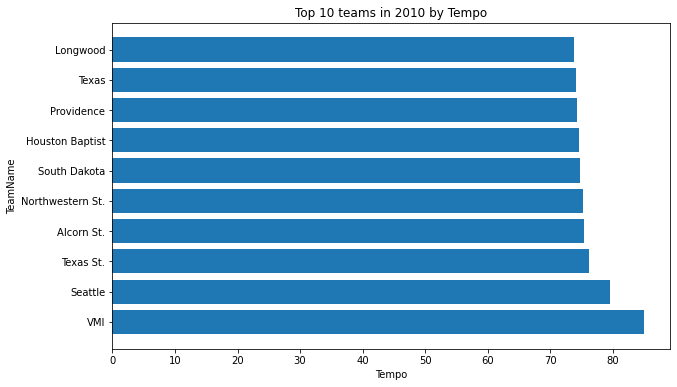

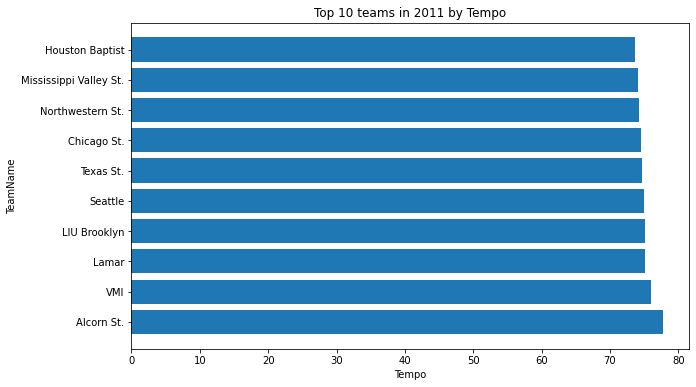

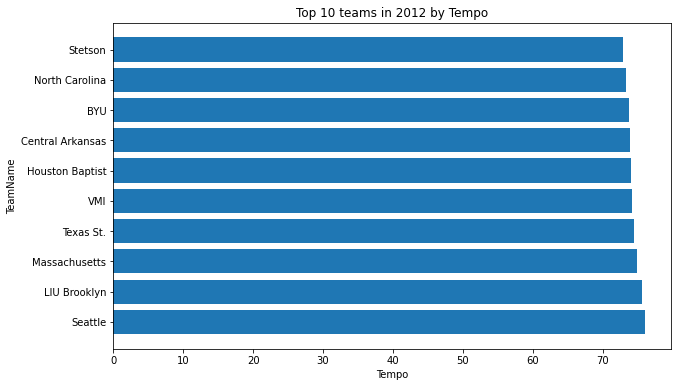

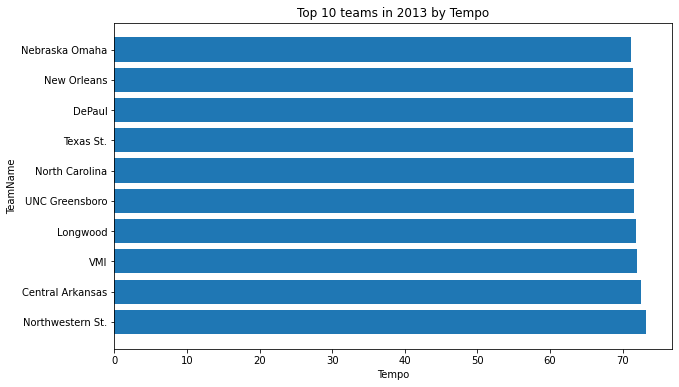

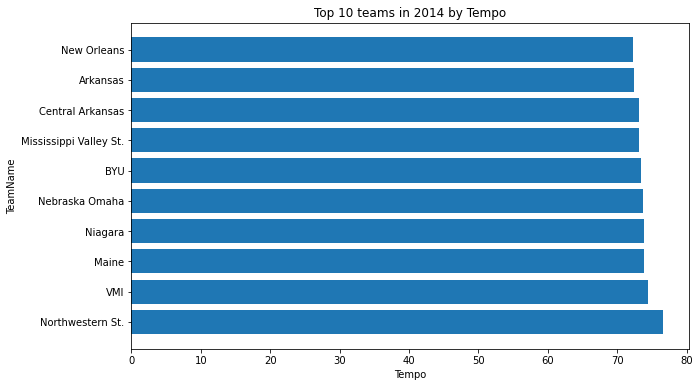

...

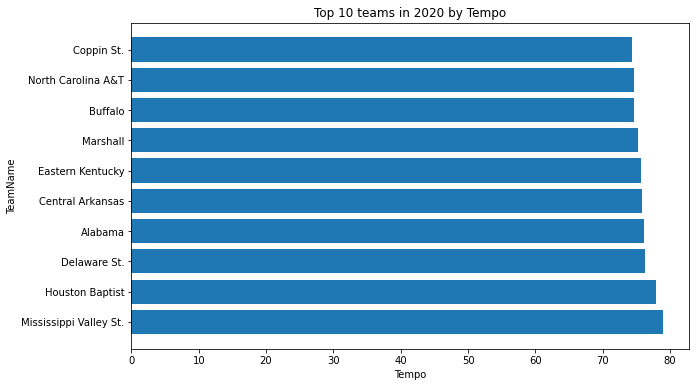

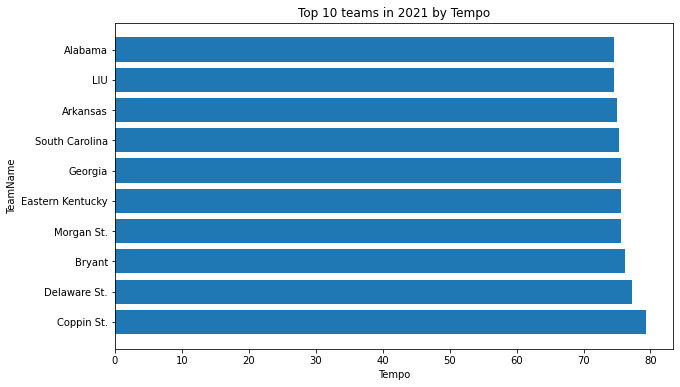

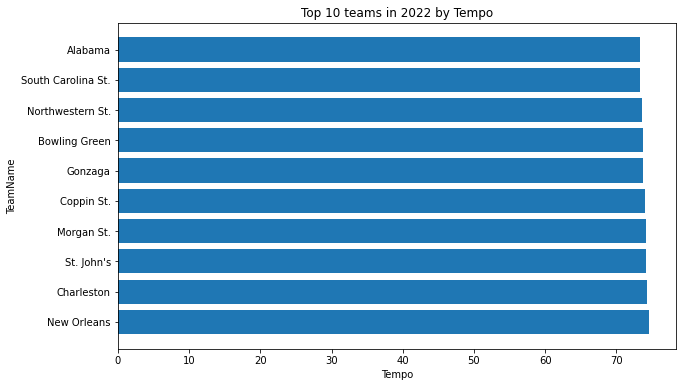

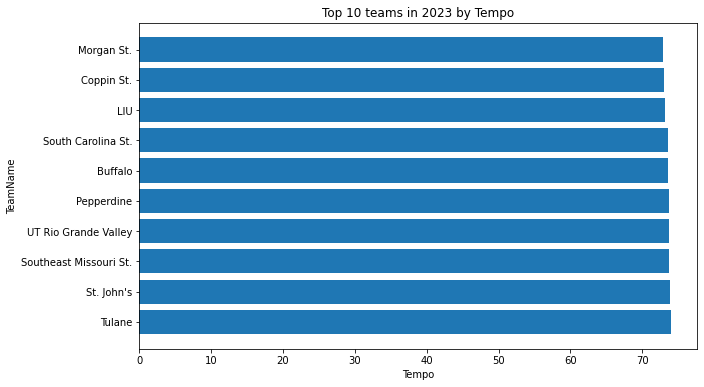

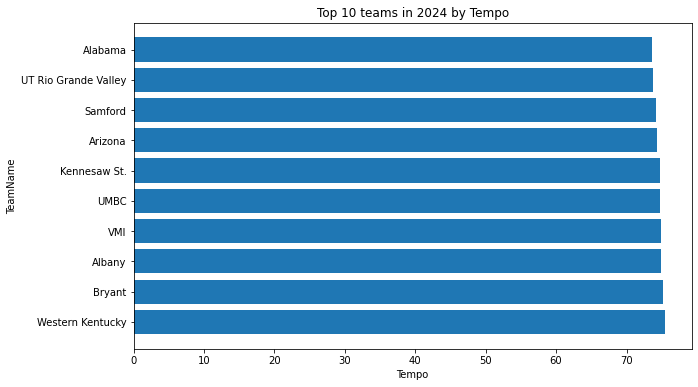

In [41]:
grouped_by_season = sum_df.groupby('Season')

sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankTempo')
    
for season, df_season in sorted_by_season.items():
    top_10_tempo = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_tempo['TeamName'], top_10_tempo['Tempo'])
    plt.xlabel('Tempo')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by Tempo')
    plt.show()

### Top 10 Teams By Adjusted Tempo

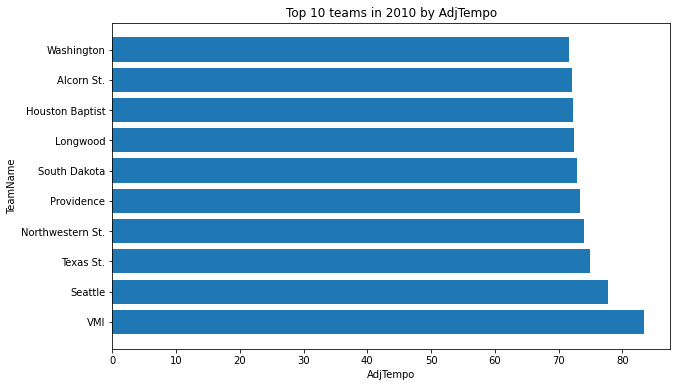

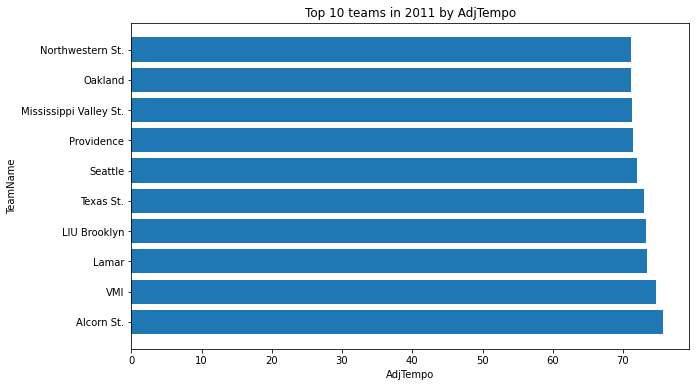

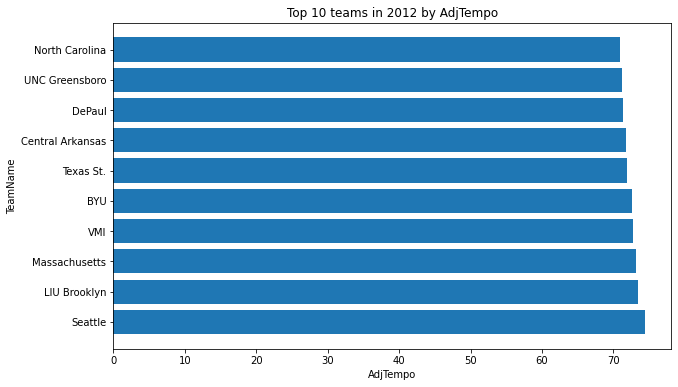

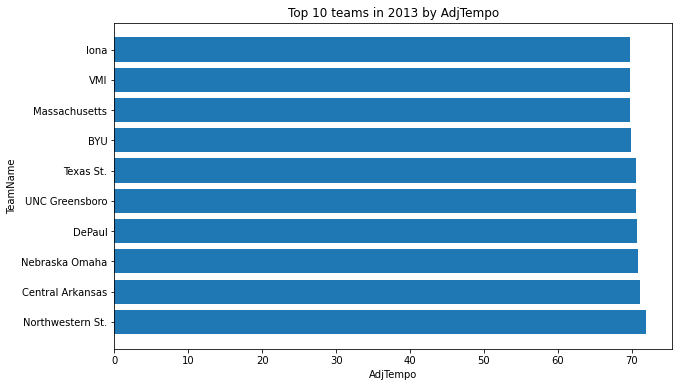

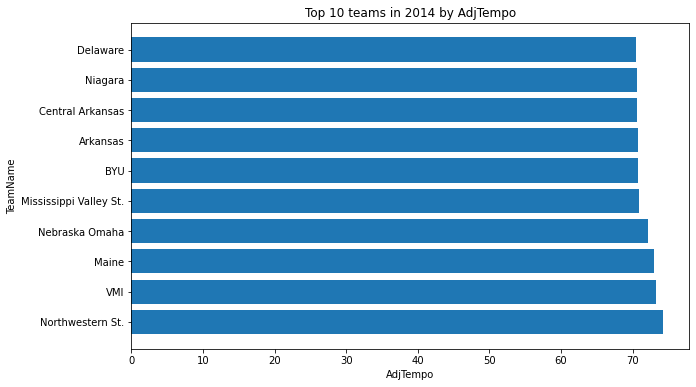

...

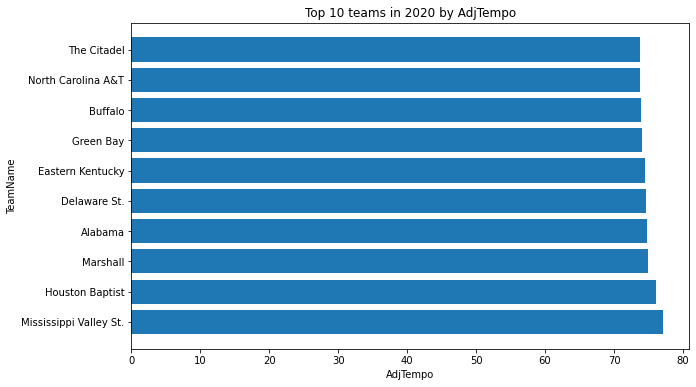

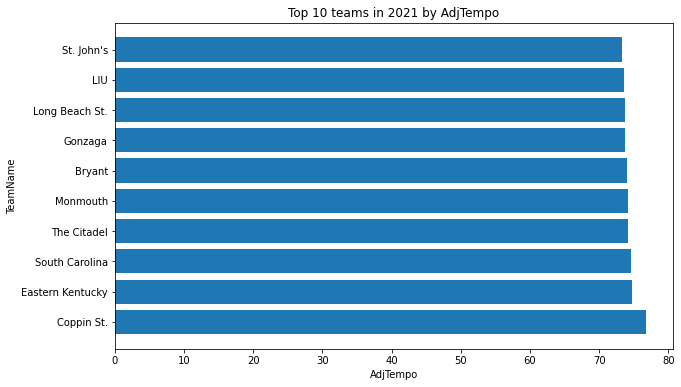

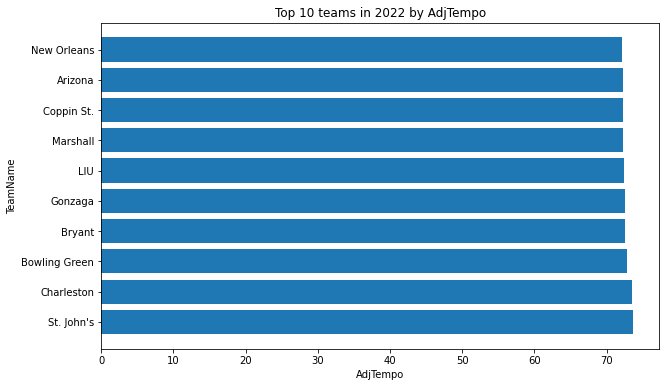

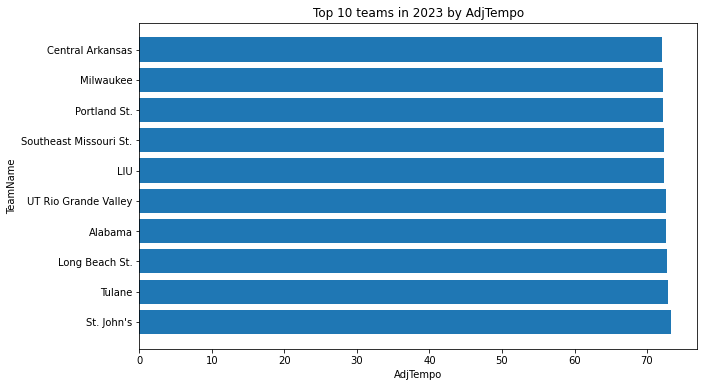

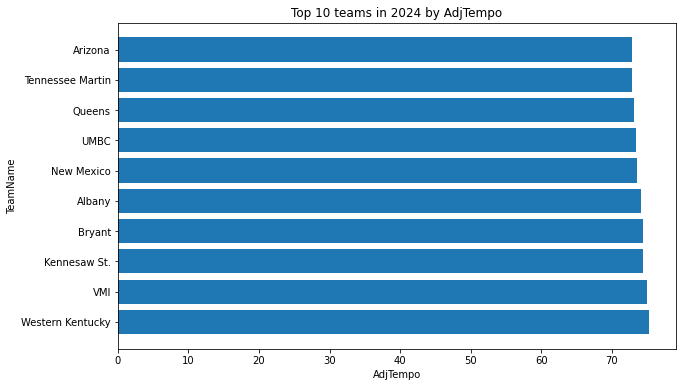

In [42]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankAdjTempo')
    
for season, df_season in sorted_by_season.items():
    top_10_adj_tempo = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_adj_tempo['TeamName'], top_10_adj_tempo['AdjTempo'])
    plt.xlabel('AdjTempo')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by AdjTempo')
    plt.show()

### Top 10 Teams By Offensive Efficiency 

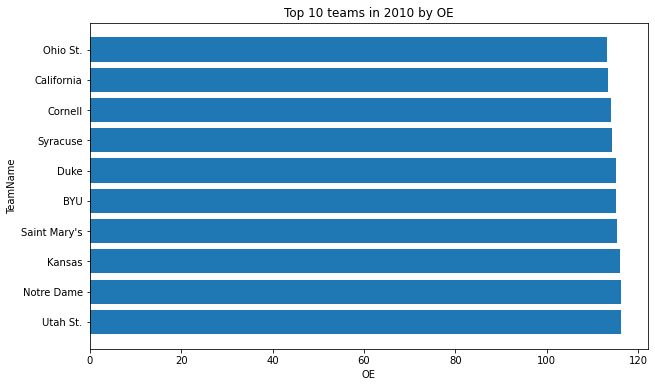

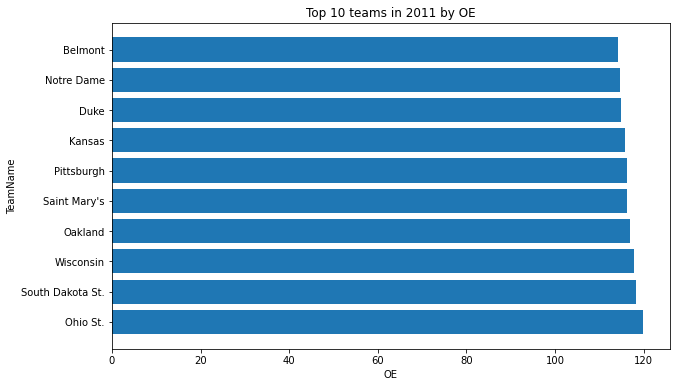

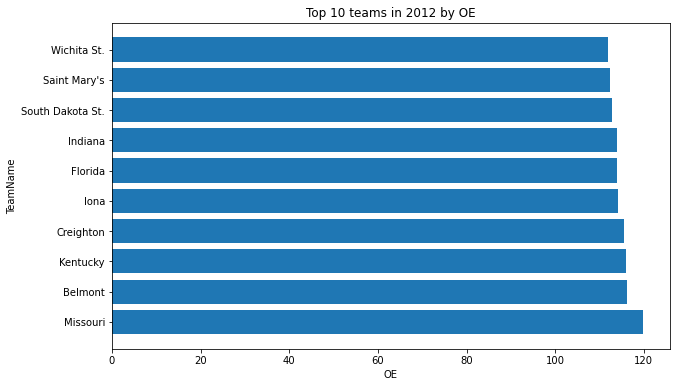

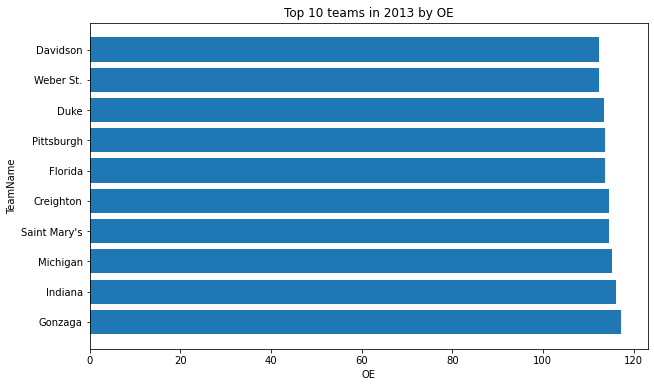

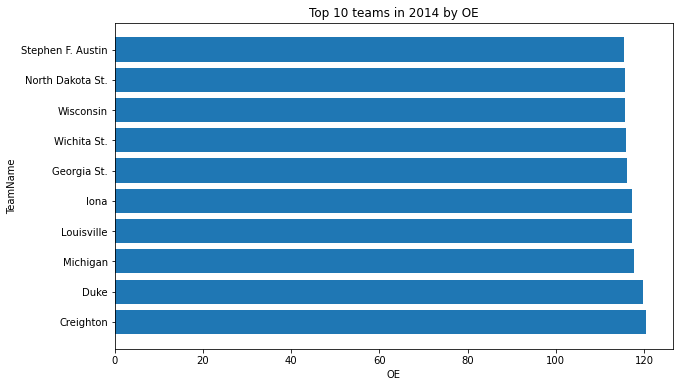

...

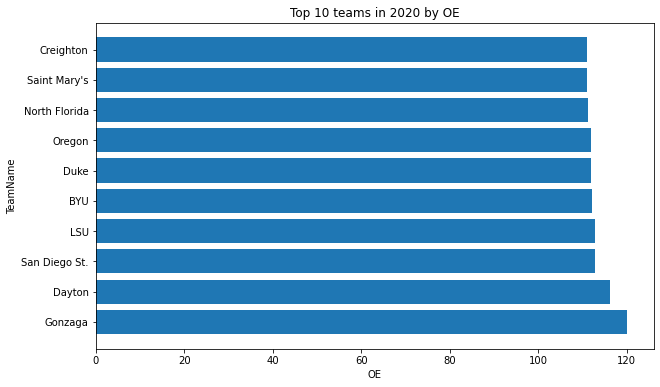

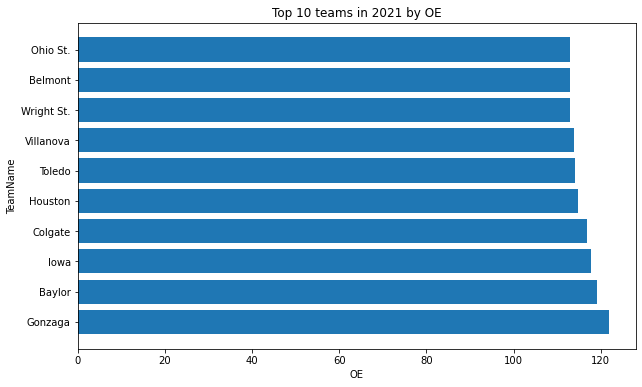

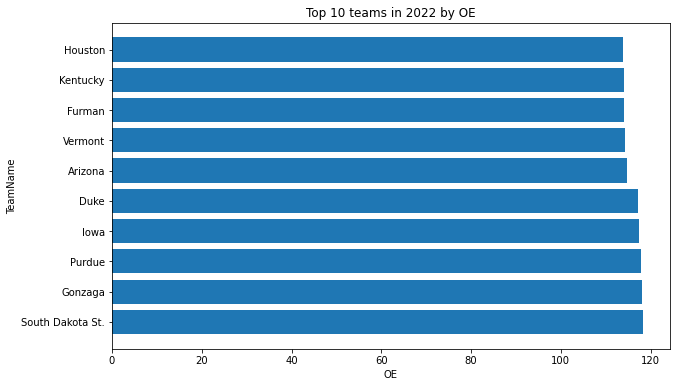

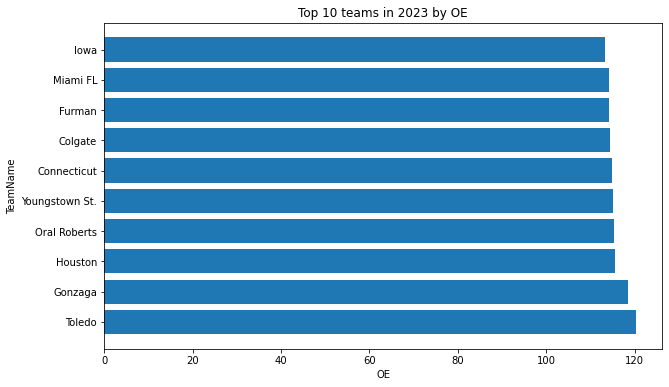

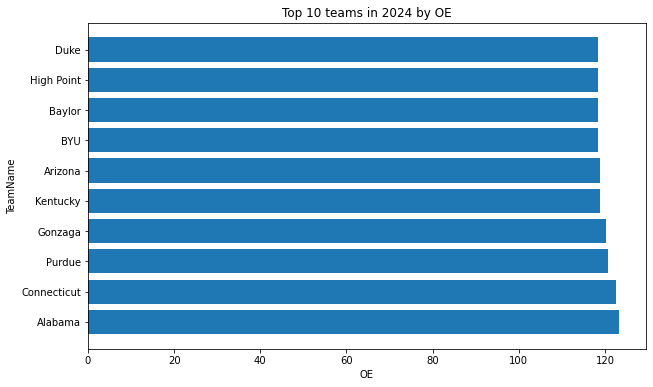

In [43]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankOE')
    
for season, df_season in sorted_by_season.items():
    top_10_oe= df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_oe['TeamName'], top_10_oe['OE'])
    plt.xlabel('OE')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by OE')
    plt.show()

### Top 10 Teams By Adjusted Offensive Efficiency

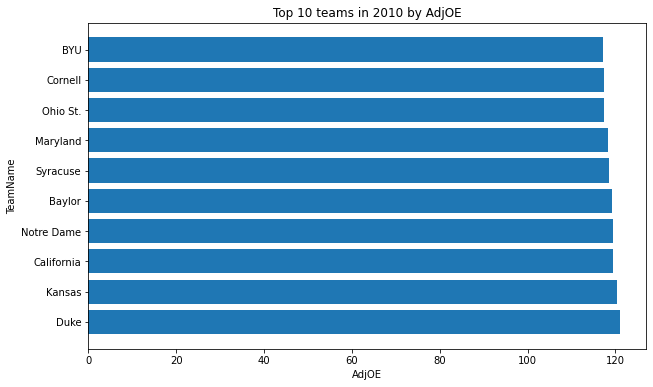

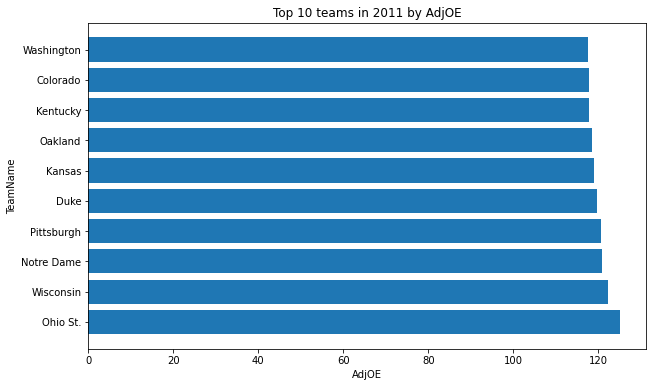

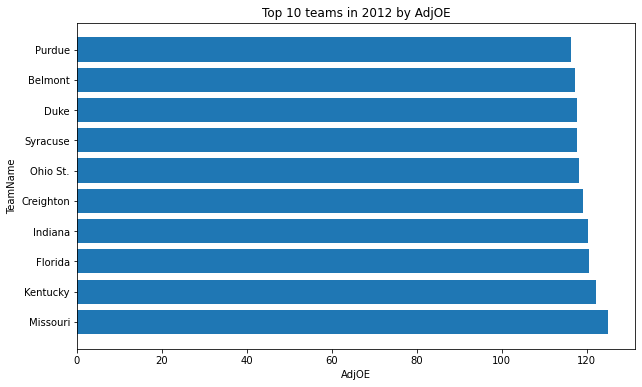

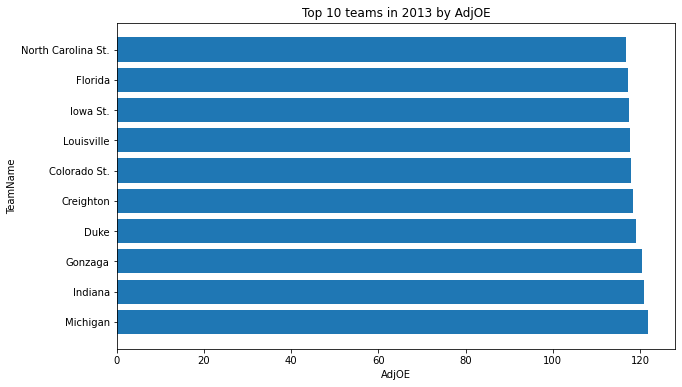

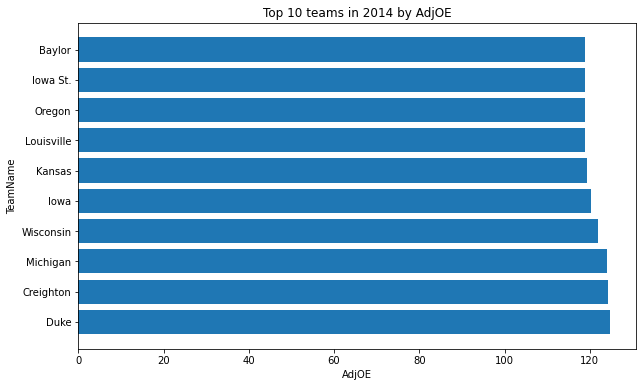

...

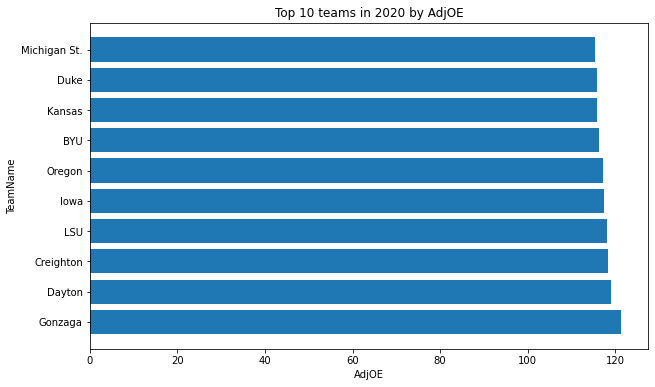

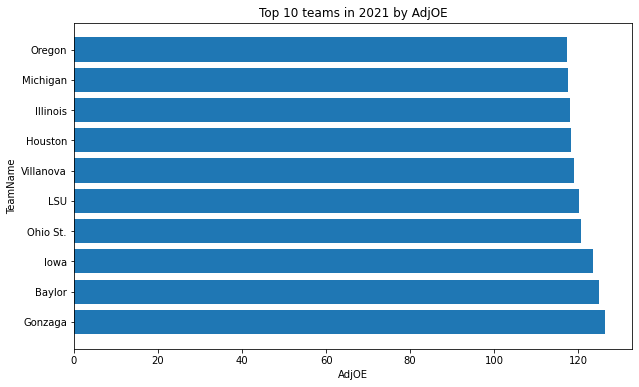

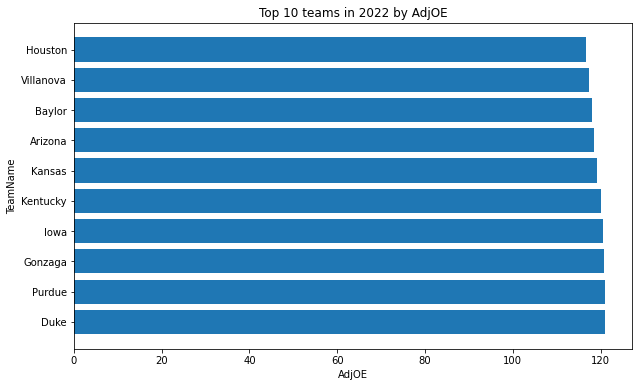

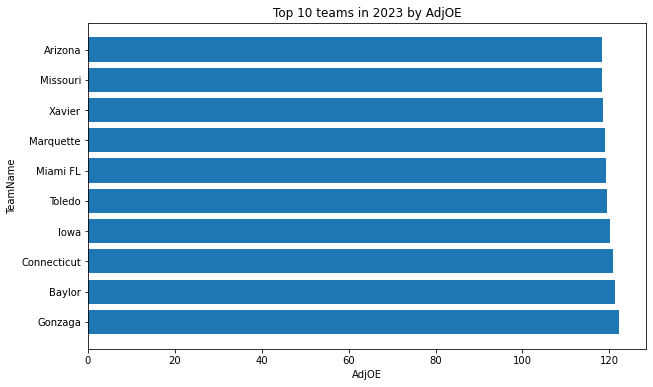

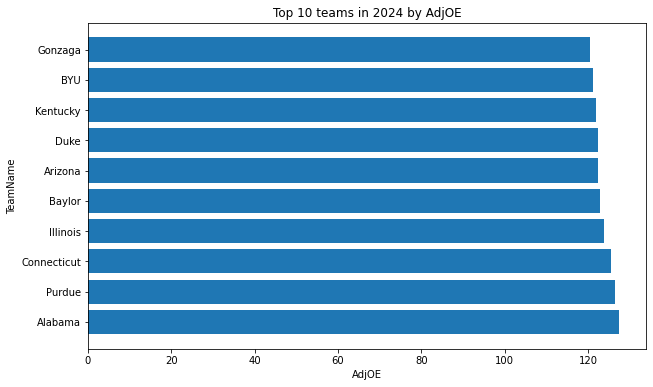

In [44]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankAdjOE')
    
for season, df_season in sorted_by_season.items():
    top_10_adj_oe= df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_adj_oe['TeamName'], top_10_adj_oe['AdjOE'])
    plt.xlabel('AdjOE')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by AdjOE')
    plt.show()

### Top 10 Teams By Defensive Efficiency

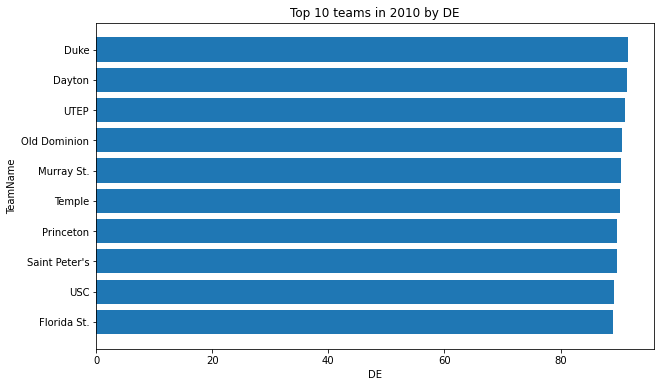

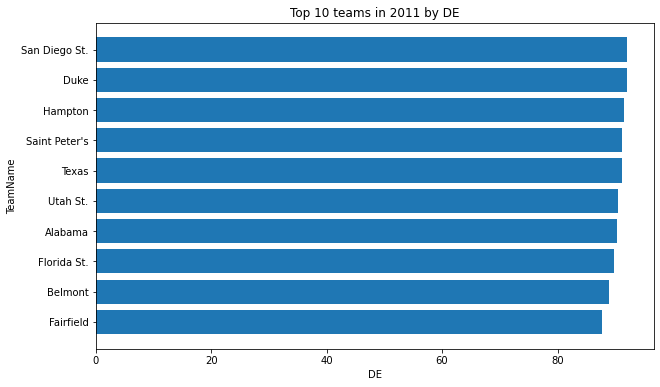

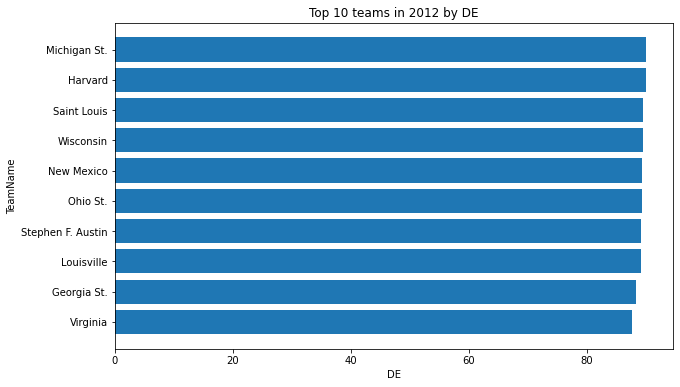

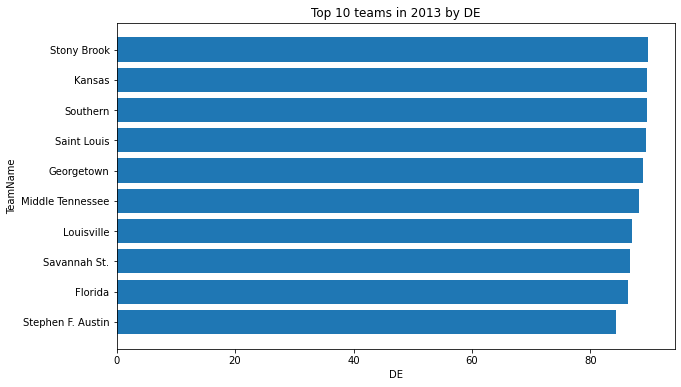

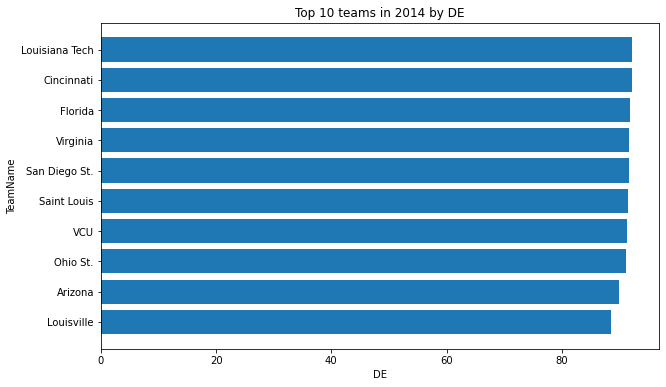

...

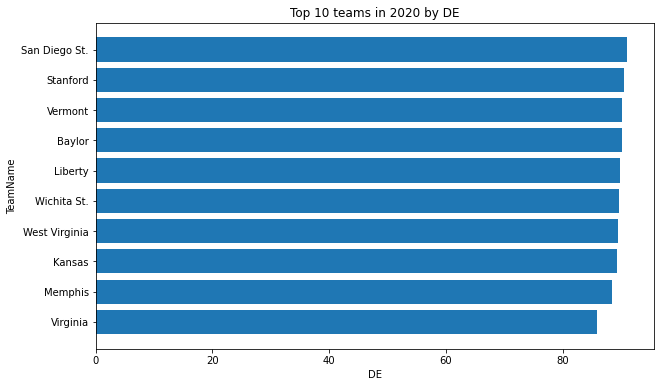

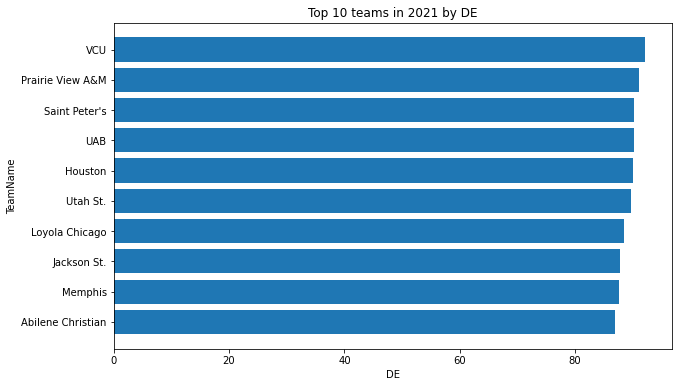

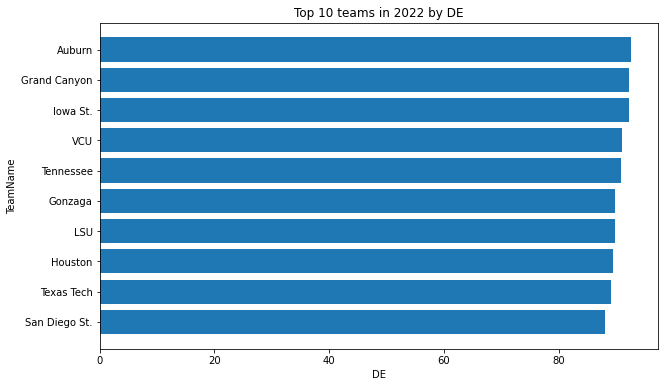

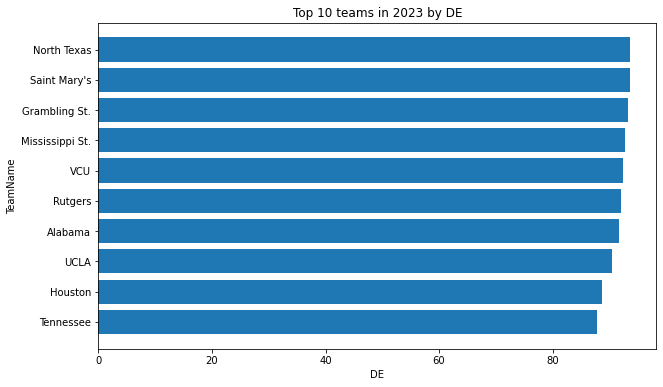

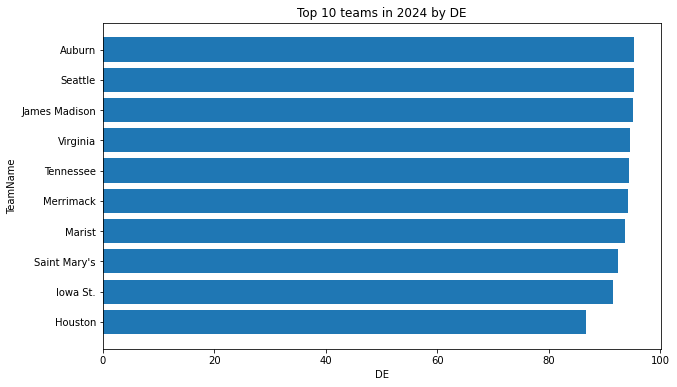

In [45]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankDE')
    
for season, df_season in sorted_by_season.items():
    top_10_de= df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_de['TeamName'], top_10_de['DE'])
    plt.xlabel('DE')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by DE')
    plt.show()

### Top 10 Teams By Adjusted Defensive Efficiency

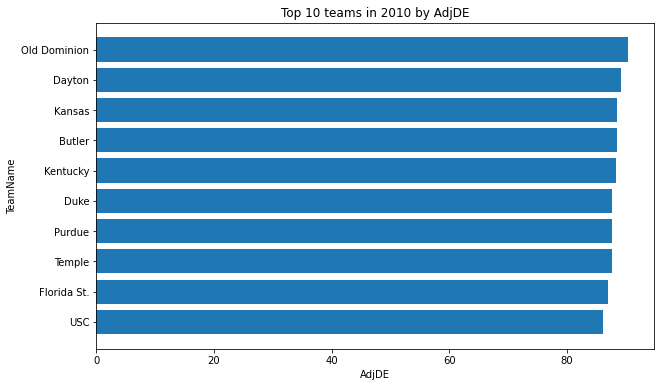

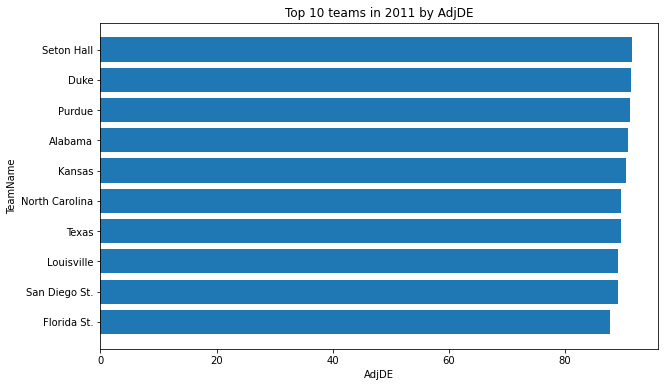

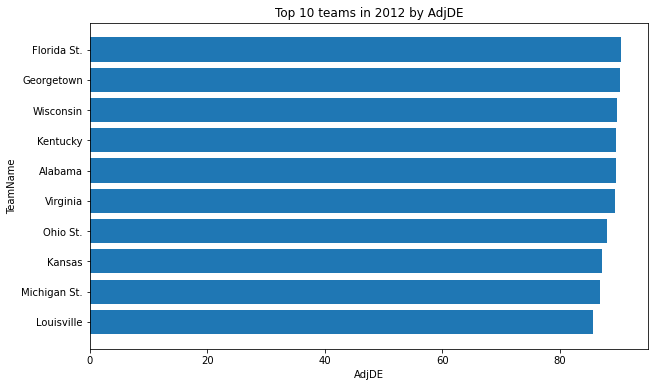

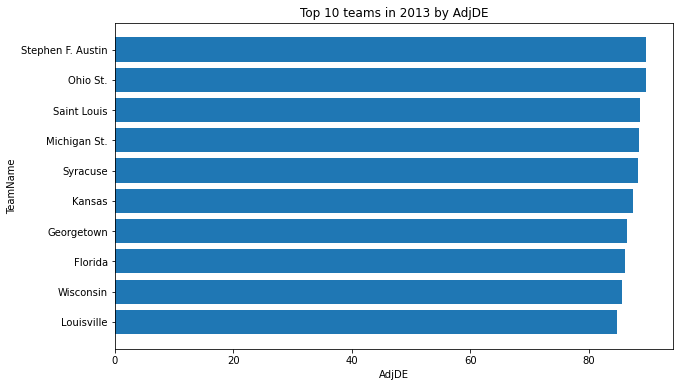

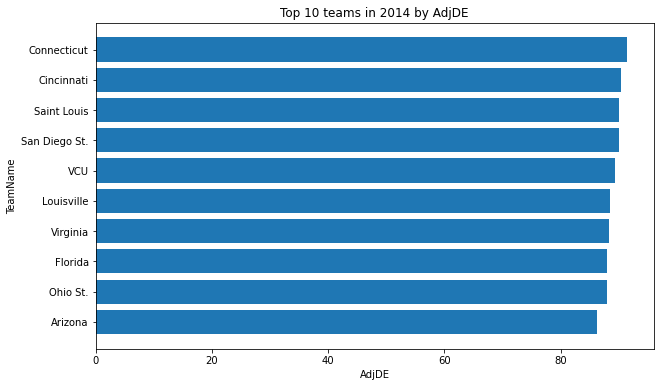

...

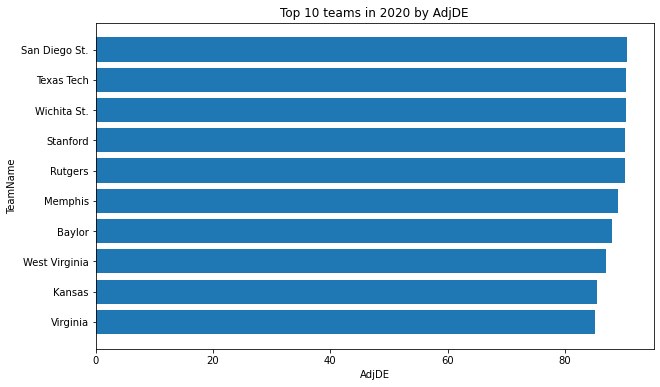

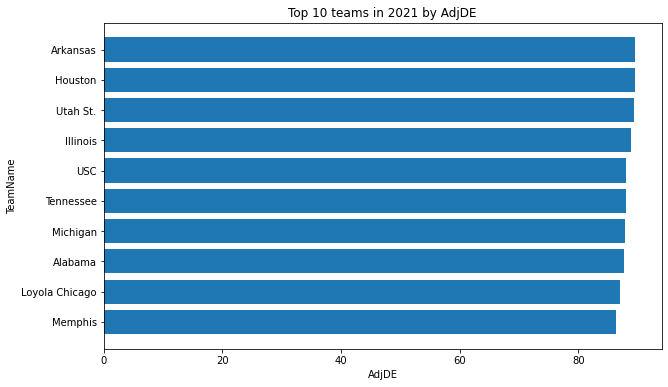

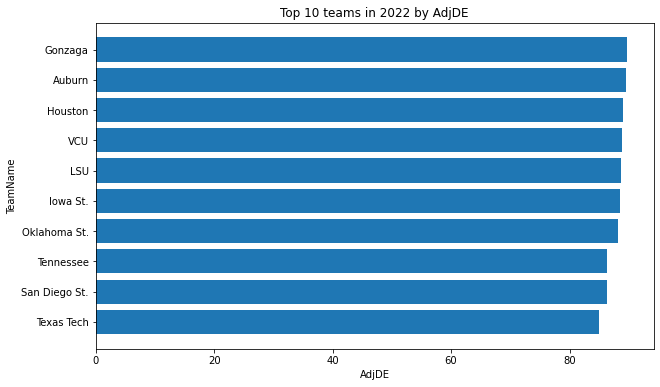

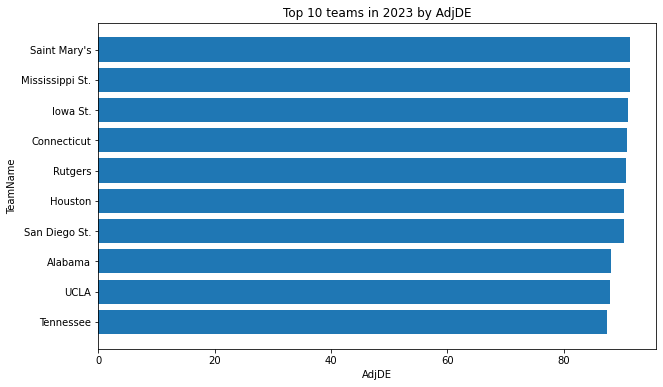

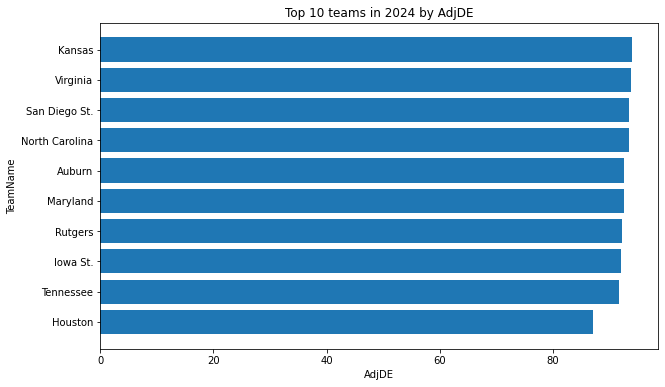

In [46]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankAdjDE')
    
for season, df_season in sorted_by_season.items():
    top_10_adj_de= df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_adj_de['TeamName'], top_10_adj_de['AdjDE'])
    plt.xlabel('AdjDE')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by AdjDE')
    plt.show()

### Top 10 Teams By Adjusted Efficiency Margin

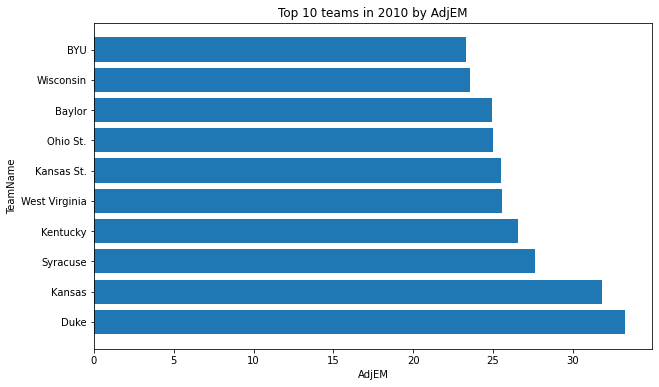

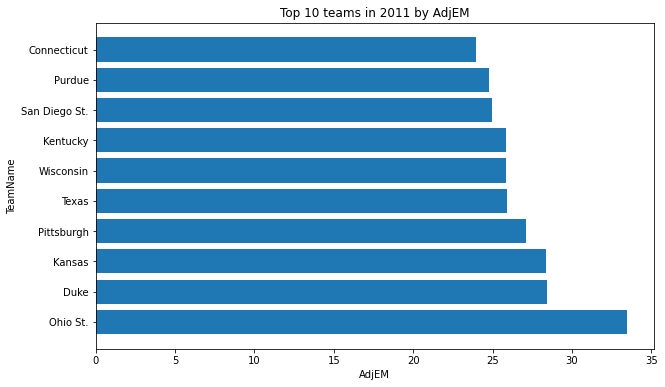

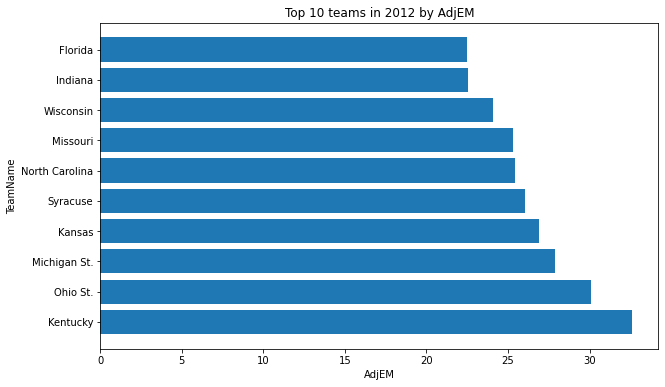

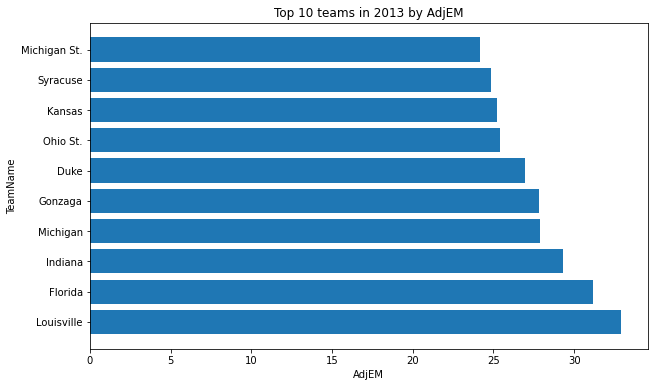

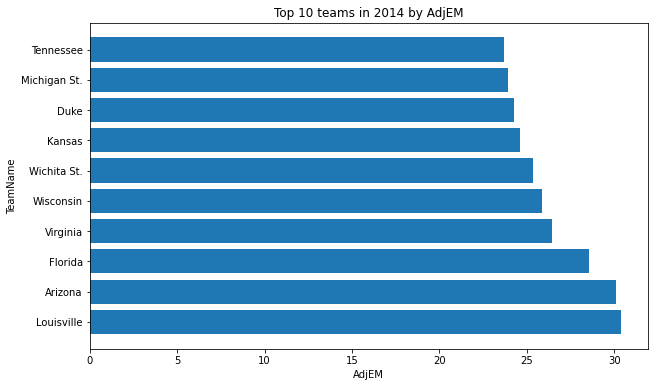

...

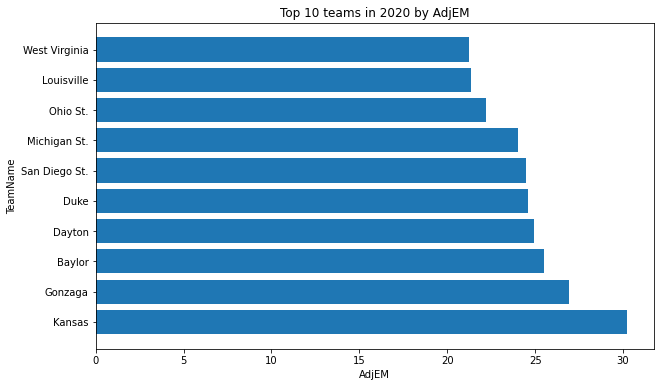

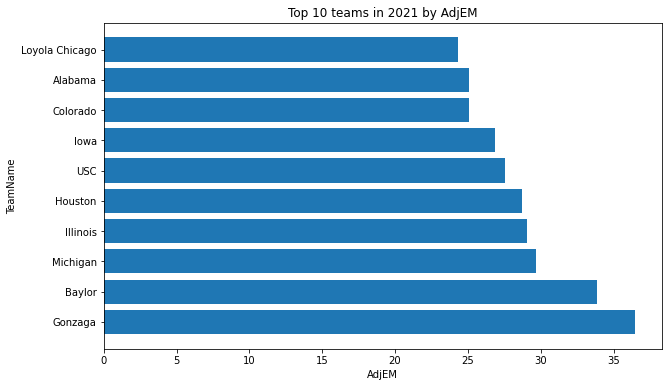

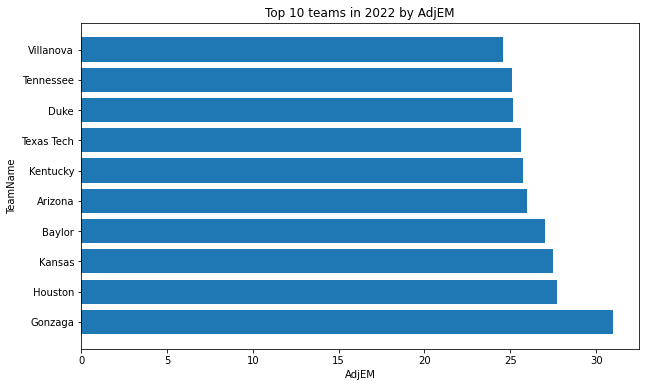

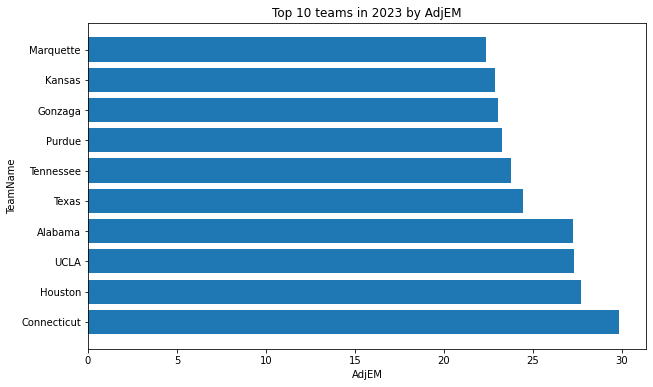

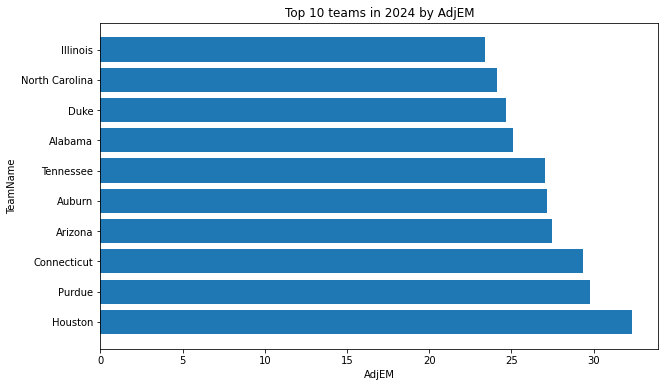

In [47]:
sorted_by_season = {}
for season, df_season in grouped_by_season:
    sorted_by_season[season] = df_season.sort_values('RankAdjEM')
    
for season, df_season in sorted_by_season.items():
    top_10_adj_em = df_season.head(10)
    plt.figure(figsize=(10, 6))
    plt.barh(top_10_adj_em['TeamName'], top_10_adj_em['AdjEM'])
    plt.xlabel('AdjEM')
    plt.ylabel('TeamName')
    plt.title(f'Top 10 teams in {season} by AdjEM')
    plt.show()

In [48]:
# features for clustering
features = ['Tempo','RankTempo','AdjTempo','RankAdjTempo',
            'OE','RankOE','AdjOE','RankAdjOE','DE','RankDE',
            'AdjDE','RankAdjDE','AdjEM','RankAdjEM']

for season in sum_df['Season'].unique():
    # select data for the current season
    season_data_sum = sum_df[sum_df['Season'] == season].copy()
    
    X = season_data_sum[features]

    # scaling
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # perform PCA for dimensionality reduction
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)

    # initialize KMeans
    kmeans = KMeans(n_clusters=5, random_state=42)

    # fit the model
    kmeans.fit(X_scaled)

    # predict cluster assignments
    clusters = kmeans.predict(X_scaled)

    # add cluster assignments to the df
    season_data_sum['SumCluster'] = clusters

    # create a df with team names and statistics for hover-over
    hover_data = season_data_sum[['TeamName'] + features + ['SumCluster']]

    # identify winner for each season
    winner = None
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut' 

    # visualize clusters using Plotly
    fig = px.scatter(season_data_sum, x=X_pca[:, 0], y=X_pca[:, 1], color='SumCluster', hover_name='TeamName',
                     hover_data=hover_data, labels={'x': 'Principal Component 1', 'y': 'Principal Component 2', 'Cluster': 'Cluster'},
                     title=f'Clusters Visualization (PCA) Misc - Season {season}')

    # highlight the winner with a different marker style
    if winner is not None:
        winner_data = season_data_sum[season_data_sum['TeamName'] == winner]
        winner_hovertext = [f"{winner}\nCluster: {winner_data['SumCluster'].iloc[0]}"]  # Add cluster to hovertext
        for feature in features:
            winner_hovertext.append(f"{feature}: {winner_data[feature].iloc[0]}")  # Add statistics to hovertext
        fig.add_trace(go.Scatter(x=[X_pca[0, 0]], y=[X_pca[0, 1]], mode='markers', marker=dict(symbol='star', color='black', size=12),
                                 hovertext=winner_hovertext, showlegend=False))

    fig.show()


In [49]:
winners_sum_clusters = [1, 3, 1, 0, 2, 3, 4, 1, 2, 1, 4, 2, 2]

# define a list containing winners and seasons
winners_data = []

# define a list to store filtered df's
winners_sum_dfs = []

# iterate over each season
for season in range(2010, 2025):
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut'
    else:
        winner = None  # For seasons not mentioned
    
    # append to winners_data list
    winners_data.append({'Season': season, 'Winner': winner})
    
    # filter final_def_df for the current season and winner
    winners_sum_df = sum_df[(sum_df['Season'] == season) & (sum_df['TeamName'] == winner)]
    winners_sum_dfs.append(winners_sum_df)

# concatenate all filtered df's
all_winners_sum_df = pd.concat(winners_sum_dfs, ignore_index=True)

all_winners_sum_df['SumCluster'] = winners_sum_clusters

# inspect
all_winners_sum_df

,Season,TeamName,Tempo,RankTempo,AdjTempo,RankAdjTempo,OE,RankOE,AdjOE,RankAdjOE,DE,RankDE,AdjDE,RankAdjDE,AdjEM,RankAdjEM,SumCluster
0,2010,Duke,66.7159,210,64.6642,229,115.060,6,121.003,1,91.5607,10,87.7166,5,33.2863,1,1
1,2011,Connecticut,65.3819,243,64.5067,221,108.746,45,115.846,19,97.5310,72,91.9129,15,23.9329,10,3
2,2012,Kentucky,67.0400,161,65.3785,150,115.908,3,122.182,2,90.7504,13,89.5938,7,32.5881,1,1
3,2013,Louisville,66.5244,145,65.8158,116,110.494,21,117.680,7,86.9752,4,84.7632,1,32.9166,1,0
4,2014,Connecticut,65.5299,224,63.1794,254,108.575,81,113.591,39,95.8881,21,91.4609,10,22.1300,15,2
5,2015,Duke,65.9330,120,65.7650,104,119.653,3,124.454,3,96.6318,51,91.9701,11,32.4841,3,3
6,2016,Villanova,67.1770,264,66.0317,274,116.158,7,122.761,3,94.4947,13,90.7523,5,32.0092,1,4
7,2017,North Carolina,72.4375,48,71.2891,40,115.379,13,120.675,9,97.7324,44,92.4566,11,28.2180,3,1
8,2018,Villanova,70.0051,138,68.7242,150,122.728,1,127.756,1,99.3109,51,94.0001,11,33.7563,1,2
9,2019,Virginia,60.6202,353,59.4019,353,116.554,4,123.403,2,91.7800,6,89.1871,5,34.2156,1,1


In [50]:
all_clusters = season_data_def['TeamName']

## Tier Ratings Assessment: K-Means Clustering

In [51]:
team_winners = all_winners_def_df['TeamName']
winners_def_clusters = all_winners_def_df['DefCluster']
winners_off_clusters = all_winners_off_df['OffCluster']
winners_misc_clusters = all_winners_misc_df['MiscCluster']
winners_sum_clusters = all_winners_sum_df['SumCluster']
winners_clusters_df = pd.concat([team_winners, 
                                 all_winners_def_df['DefCluster'], 
                                 all_winners_off_df['OffCluster'], 
                                 all_winners_misc_df['MiscCluster'], 
                                 all_winners_sum_df['SumCluster']], 
                                axis=1)

# reset the index to make 'TeamName' a regular column
winners_clusters_df.reset_index(inplace=True)

winners_clusters_df

,index,TeamName,DefCluster,OffCluster,MiscCluster,SumCluster
0,0,Duke,3,1,3,1
1,1,Connecticut,0,4,3,3
2,2,Kentucky,1,3,1,1
3,3,Louisville,2,0,4,0
4,4,Connecticut,1,2,0,2
5,5,Duke,1,4,0,3
6,6,Villanova,0,0,3,4
7,7,North Carolina,2,3,3,1
8,8,Villanova,2,0,2,2
9,9,Virginia,1,1,3,1


In [52]:
winners_clusters_df['DefCluster'].value_counts()

1    6
2    4
0    2
3    1
Name: DefCluster, dtype: int64

In [53]:
winners_clusters_df['OffCluster'].value_counts()

1    4
0    3
4    2
3    2
2    2
Name: OffCluster, dtype: int64

In [54]:
winners_clusters_df['MiscCluster'].value_counts()

3    6
1    2
0    2
2    2
4    1
Name: MiscCluster, dtype: int64

In [55]:
winners_clusters_df['SumCluster'].value_counts()

1    4
2    4
3    2
4    2
0    1
Name: SumCluster, dtype: int64

In [56]:
# merge season_data_def and season_data_off on 'TeamName'
merged_df = pd.merge(season_data_def[['TeamName', 'DefCluster']], season_data_off[['TeamName', 'OffCluster']], on='TeamName')

# merge season_data_misc to the already merged dataframe on 'TeamName'
merged_df = pd.merge(merged_df, season_data_misc[['TeamName', 'MiscCluster']], on='TeamName')

# merge season_data_sum to the already merged dataframe on 'TeamName'
merged_df = pd.merge(merged_df, season_data_sum[['TeamName', 'SumCluster']], on='TeamName')

# inspect
merged_df

,TeamName,DefCluster,OffCluster,MiscCluster,SumCluster
0,Abilene Christian,2,1,0,1
1,Air Force,2,2,1,4
2,Akron,3,4,3,3
3,Alabama,0,4,0,0
4,Alabama A&M,2,0,2,2
...,...,...,...,...,...
357,Wright St.,4,4,0,1
358,Wyoming,4,0,0,1
359,Xavier,3,4,1,0
360,Yale,3,2,1,3


In [57]:
# tier 1 - teams that meet the most common cluster of winners for 4 of 4 clusters
condition = (
    (merged_df['DefCluster'] == 1) &
    (merged_df['OffCluster'] == 1) &
    (merged_df['MiscCluster'] == 3) &
    ((merged_df['SumCluster'] == 1) | (merged_df['SumCluster'] == 2))
)

# apply the condition to filter the df
tier1_df = merged_df[condition]

# display the filtered df
tier1_df['TeamName'].unique()

array(['Western Kentucky'], dtype=object)

In [58]:
# tier 2 - teams that meet the most common cluster of winners for 3 of 4 clusters
tier2_condition = (
    (merged_df['DefCluster'] == 1).astype(int) +
    (merged_df['OffCluster'] == 1).astype(int) +
    (merged_df['MiscCluster'] == 3).astype(int) +
    ((merged_df['SumCluster'] == 1) | (merged_df['SumCluster'] == 2)).astype(int)
) == 3

tier2_df = merged_df[tier2_condition]

tier2_df['TeamName'].unique()

array(['Arizona St.', 'Arkansas', 'Bryant', 'Gardner Webb',
       'Illinois Chicago', 'Indiana', 'Little Rock', 'Merrimack',
       'Missouri St.', "Mount St. Mary's", 'Portland St.', 'Tulsa',
       'Utah Valley'], dtype=object)

In [59]:
# tier 3 - teams that meet the most common cluster of winners for 2 of 4 clusters
tier3_condition = (
    (merged_df['DefCluster'] == 1).astype(int) +
    (merged_df['OffCluster'] == 1).astype(int) +
    (merged_df['MiscCluster'] == 3).astype(int) +
    ((merged_df['SumCluster'] == 1) | (merged_df['SumCluster'] == 2)).astype(int)
) == 2

tier3_df = merged_df[tier3_condition]

tier3_df['TeamName'].unique()

array(['Abilene Christian', 'Alabama St.', 'Arkansas Pine Bluff',
       'Auburn', 'Bowling Green', 'Bradley', 'Cal St. Fullerton',
       'Cal St. Northridge', 'Charlotte', 'DePaul', 'Duquesne',
       'Eastern Kentucky', 'Eastern Washington', 'Fairleigh Dickinson',
       'Fordham', 'George Washington', 'Georgia Tech', 'Grand Canyon',
       'Hofstra', 'James Madison', 'Kansas St.', 'Lehigh', 'Lindenwood',
       'Long Beach St.', 'Longwood', 'Loyola Chicago', 'Marist',
       'Mississippi St.', 'Monmouth', 'Nevada', 'New Orleans', 'Niagara',
       'North Alabama', 'North Carolina A&T', 'Northern Illinois',
       'Northern Kentucky', 'Ohio', 'Pacific', 'Portland',
       'Prairie View A&M', 'Providence', 'Queens', 'Rhode Island',
       'SIU Edwardsville', 'Sacred Heart', 'Saint Louis',
       'Sam Houston St.', 'San Diego St.', 'San Francisco', 'Seattle',
       'South Florida', 'Southern', 'Southern Indiana', 'Southern Utah',
       "St. John's", 'Tennessee', 'Tennessee Martin', 

In [60]:
# tier 4 - teams that meet the most common cluster of winners for 1 of 4 clusters
tier4_condition = (
    (merged_df['DefCluster'] == 1).astype(int) +
    (merged_df['OffCluster'] == 1).astype(int) +
    (merged_df['MiscCluster'] == 3).astype(int) +
    ((merged_df['SumCluster'] == 1) | (merged_df['SumCluster'] == 2)).astype(int)
) == 1

tier4_df = merged_df[tier4_condition]

tier4_df['TeamName'].unique()

array(['Akron', 'Alabama A&M', 'Albany', 'Appalachian St.',
       'Arkansas St.', 'BYU', 'Ball St.', 'Baylor', 'Belmont',
       'Bethune Cookman', 'Buffalo', 'California', 'Campbell', 'Canisius',
       'Central Arkansas', 'Central Connecticut', 'Charleston Southern',
       'Chattanooga', 'Cincinnati', 'Clemson', 'Cleveland St.',
       'Coastal Carolina', 'Colorado St.', 'Columbia', 'Connecticut',
       'Coppin St.', 'Creighton', 'Davidson', 'Dayton', 'Delaware',
       'Delaware St.', 'Denver', 'Detroit Mercy', 'Drexel',
       'East Carolina', 'East Tennessee St.', 'Elon', 'Evansville', 'FIU',
       'Fairfield', 'Florida', 'Florida A&M', 'Florida Atlantic',
       'Florida St.', 'Furman', 'Georgia', 'Georgia Southern',
       'Georgia St.', 'Gonzaga', 'Hampton', 'Harvard', 'Hawaii',
       'Houston', 'Houston Christian', 'Howard', 'IUPUI', 'Illinois',
       'Incarnate Word', 'Iona', 'Iowa St.', 'Jackson St.',
       'Jacksonville St.', 'Kansas', 'Kennesaw St.', 'Kent St.',
   

In [61]:
# tier 5 - teams that meet the most common cluster of winners for 0 of 4 clusters
tier5_condition = (
    (merged_df['DefCluster'] == 1).astype(int) +
    (merged_df['OffCluster'] == 1).astype(int) +
    (merged_df['MiscCluster'] == 3).astype(int) +
    ((merged_df['SumCluster'] == 1) | (merged_df['SumCluster'] == 2)).astype(int)
) == 0

tier5_df = merged_df[tier5_condition]

tier5_df['TeamName'].unique()

array(['Air Force', 'Alabama', 'Alcorn St.', 'American', 'Arizona',
       'Army', 'Austin Peay', 'Bellarmine', 'Binghamton', 'Boise St.',
       'Boston College', 'Boston University', 'Brown', 'Bucknell',
       'Butler', 'Cal Baptist', 'Cal Poly', 'Cal St. Bakersfield',
       'Central Michigan', 'Charleston', 'Chicago St.', 'Colgate',
       'Colorado', 'Cornell', 'Dartmouth', 'Drake', 'Duke',
       'Eastern Illinois', 'Eastern Michigan', 'Florida Gulf Coast',
       'Fresno St.', 'George Mason', 'Georgetown', 'Grambling St.',
       'Green Bay', 'High Point', 'Holy Cross', 'Idaho', 'Idaho St.',
       'Illinois St.', 'Indiana St.', 'Iowa', 'Jacksonville', 'Le Moyne',
       'Liberty', 'Louisiana Monroe', 'Loyola MD', 'Loyola Marymount',
       'Mercer', 'Miami FL', 'Middle Tennessee', 'Minnesota', 'Montana',
       'Murray St.', 'NJIT', 'Nebraska', 'New Mexico St.', 'Norfolk St.',
       'North Dakota', 'North Dakota St.', 'Northeastern', 'Northwestern',
       'Notre Dame', 'Oreg

### Top 15 Teams from Vegas Odds Placed in Tier Groups
- This information was gathered via the following link https://sportsbook.fanduel.com/navigation/ncaab?tab=national-champion

In [62]:
dataframes = [tier1_df, tier2_df, tier3_df, tier4_df, tier5_df]
tier_labels = ['tier1_df', 'tier2_df', 'tier3_df', 'tier4_df', 'tier5_df']
top_15_list = ['Connecticut', 'Houston', 'Purdue', 'Arizona', 
               'Tennessee', 'North Carolina', 'Duke', 'Creighton',
               'Marquette', 'Auburn', 'Illinois', 'Alabama',
               'Iowa State', 'Kansas', 'Baylor']

team_tier_data = []

for team in top_15_list:
    for i, tier_df in enumerate(dataframes):
        if team in tier_df.values:
            team_tier_data.append({'Team': team, 'Tier': tier_labels[i]})
            break


team_tier_df = pd.DataFrame(team_tier_data)

print(team_tier_df)

              Team      Tier
0      Connecticut  tier4_df
1          Houston  tier4_df
2           Purdue  tier4_df
3          Arizona  tier5_df
4        Tennessee  tier3_df
5   North Carolina  tier4_df
6             Duke  tier5_df
7        Creighton  tier4_df
8        Marquette  tier4_df
9           Auburn  tier3_df
10        Illinois  tier4_df
11         Alabama  tier5_df
12          Kansas  tier4_df
13          Baylor  tier4_df


# Hierarchical Clustering

### Defensive Dataframe - Hierarchical Clustering

In [63]:
features = ['eFGPct-Def', 'RankeFGPct-Def', 'TOPct-Def', 'RankTOPct-Def',
            'ORPct-Def', 'RankORPct-Def', 'FTRate-Def', 'RankFTRate-Def']

for season in final_def_df['Season'].unique():
    # select data for the current season
    season_data_def = final_def_df[final_def_df['Season'] == season].copy()
    
    # select features for clustering
    X = season_data_def[features]

    # scaling
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # perform PCA for dimensionality reduction
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)

    # initialize AgglomerativeClustering
    agg_clustering = AgglomerativeClustering(n_clusters=5)

    # fit the model
    clusters = agg_clustering.fit_predict(X_scaled)

    # add cluster assignments to the df
    season_data_def['DefCluster'] = clusters

    # create a df with team names and statistics for hover-over
    hover_data = season_data_def[['TeamName'] + features + ['DefCluster']]

    # identify winner for the current season
    winner = None
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut' 

    # visualize clusters using Plotly
    fig = px.scatter(season_data_def, x=X_pca[:, 0], y=X_pca[:, 1], color='DefCluster', hover_name='TeamName',
                     hover_data=hover_data, labels={'x': 'Principal Component 1', 'y': 'Principal Component 2', 'Cluster': 'Cluster'},
                     title=f'Clusters Visualization (PCA) Defense - Season {season}')

    # highlight the winner with a different marker style
    if winner is not None:
        winner_data = season_data_def[season_data_def['TeamName'] == winner]
        winner_hovertext = [f"{winner}\nCluster: {winner_data['DefCluster'].iloc[0]}"]  # Add cluster to hovertext
        for feature in features:
            winner_hovertext.append(f"{feature}: {winner_data[feature].iloc[0]}")  # Add statistics to hovertext
        fig.add_trace(go.Scatter(x=[X_pca[0, 0]], y=[X_pca[0, 1]], mode='markers', marker=dict(symbol='star', color='black', size=12),
                                 hovertext=winner_hovertext, showlegend=False))

    fig.show()


In [64]:
winners_def_clusters = [2, 2, 4, 4, 2, 0, 0, 3, 3, 0, 2, 2, 4]

# define a list containing winners and seasons
winners_data = []

# define a list to store filtered df's
winners_def_dfs = []

# iterate over each season
for season in range(2010, 2025):
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut'
    else:
        winner = None  # For seasons not mentioned
    
    # append to winners_data list
    winners_data.append({'Season': season, 'Winner': winner})
    
    # filter final_def_df for the current season and winner
    winners_def_df = final_def_df[(final_def_df['Season'] == season) & (final_def_df['TeamName'] == winner)]
    winners_def_dfs.append(winners_def_df)

# concatenate all filtered df's
all_winners_def_df = pd.concat(winners_def_dfs, ignore_index=True)

all_winners_def_df['DefCluster'] = winners_def_clusters

# display the resulting df
all_winners_def_df

,Season,TeamName,eFGPct-Def,RankeFGPct-Def,TOPct-Def,RankTOPct-Def,ORPct-Def,RankORPct-Def,FTRate-Def,RankFTRate-Def,DefCluster
0,2010,Duke,43.628100,7.0,21.263100,116.0,32.134200,149.0,34.013600,97.0,2
1,2011,Connecticut,44.531900,13.0,17.283600,314.0,33.459500,236.0,26.836200,10.0,2
2,2012,Kentucky,41.971400,1.0,17.583400,301.0,30.756800,113.0,25.809200,8.0,4
3,2013,Louisville,44.782200,32.0,27.048300,2.0,33.286000,242.0,34.945000,147.0,4
4,2014,Connecticut,44.556000,15.0,19.646300,82.0,32.778100,244.0,35.743000,78.0,2
5,2015,Duke,46.536600,70.0,18.585900,204.0,30.162100,125.0,24.024500,4.0,0
6,2016,Villanova,46.662200,42.0,20.552800,43.0,29.371580,147.0,29.995550,48.0,0
7,2017,North Carolina,48.102630,71.0,18.596773,168.0,24.982699,25.0,31.565330,82.0,3
8,2018,Villanova,48.479800,56.0,18.196220,186.0,27.096327,100.0,26.697209,32.0,3
9,2019,Virginia,44.686717,8.0,17.372795,250.0,25.363985,50.0,26.265664,21.0,0


### Offensive Dataframe - Hierarchical Clustering

In [65]:
features = ['eFGPct-Off', 'RankeFGPct-Off', 'TOPct-Off', 'RankTOPct-Off',
            'ORPct-Off', 'RankORPct-Off', 'FTRate-Off', 'RankFTRate-Off']

for season in final_off_df['Season'].unique():
    # select data for the current season
    season_data_off = final_off_df[final_off_df['Season'] == season].copy()
    
    # select features for clustering
    X = season_data_off[features]

    # scaling
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # perform PCA for dimensionality reduction
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)

    # initialize AgglomerativeClustering
    agg_clustering = AgglomerativeClustering(n_clusters=5)

    # fit the model
    clusters = agg_clustering.fit_predict(X_scaled)

    # add cluster assignments to the DataFrame
    season_data_off['OffCluster'] = clusters

    # create a DataFrame with team names and statistics for hover-over
    hover_data = season_data_off[['TeamName'] + features + ['OffCluster']]

    # identify winner for the current season
    winner = None
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut' 

    # visualize clusters using Plotly
    fig = px.scatter(season_data_off, x=X_pca[:, 0], y=X_pca[:, 1], color='OffCluster', hover_name='TeamName',
                     hover_data=hover_data, labels={'x': 'Principal Component 1', 'y': 'Principal Component 2', 'Cluster': 'Cluster'},
                     title=f'Clusters Visualization (PCA) Offense - Season {season}')

    # highlight the winner with a different marker style
    if winner is not None:
        winner_data = season_data_off[season_data_off['TeamName'] == winner]
        winner_hovertext = [f"{winner}\nCluster: {winner_data['OffCluster'].iloc[0]}"]  # Add cluster to hovertext
        for feature in features:
            winner_hovertext.append(f"{feature}: {winner_data[feature].iloc[0]}")  # Add statistics to hovertext
        fig.add_trace(go.Scatter(x=[X_pca[0, 0]], y=[X_pca[0, 1]], mode='markers', marker=dict(symbol='star', color='black', size=12),
                                 hovertext=winner_hovertext, showlegend=False))

    fig.show()


In [66]:
winners_off_clusters = [2, 1, 0, 1, 0, 2, 0, 0, 2, 2, 2, 1, 4]

# define a list containing winners and seasons
winners_data = []

# define a list to store filtered df's
winners_off_dfs = []

# iterate over each season
for season in range(2010, 2025):
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut'
    else:
        winner = None  # For seasons not mentioned
    
    # append to winners_data list
    winners_data.append({'Season': season, 'Winner': winner})
    
    # filter final_def_df for the current season and winner
    winners_off_df = final_off_df[(final_off_df['Season'] == season) & (final_off_df['TeamName'] == winner)]
    winners_off_dfs.append(winners_off_df)

# concatenate all filtered df's
all_winners_off_df = pd.concat(winners_off_dfs, ignore_index=True)

all_winners_off_df['OffCluster'] = winners_off_clusters

# display the resulting df
all_winners_off_df

,Season,TeamName,eFGPct-Off,RankeFGPct-Off,TOPct-Off,RankTOPct-Off,ORPct-Off,RankORPct-Off,FTRate-Off,RankFTRate-Off,OffCluster
0,2010,Duke,50.527000,92.0,16.416900,15.0,40.308400,7.0,37.900500,158.0,2
1,2011,Connecticut,48.168000,213.0,17.137100,26.0,38.228300,7.0,33.841100,268.0,1
2,2012,Kentucky,53.758900,14.0,16.982300,21.0,37.461400,21.0,41.726000,47.0,0
3,2013,Louisville,50.543200,88.0,18.303900,77.0,38.228900,16.0,39.982600,71.0,1
4,2014,Connecticut,51.549500,83.0,17.332800,103.0,30.400600,209.0,38.344100,233.0,0
5,2015,Duke,56.618000,4.0,16.267500,35.0,35.771700,32.0,39.844800,97.0,2
6,2016,Villanova,56.052500,8.0,16.323500,58.0,28.238130,224.0,34.089900,242.0,0
7,2017,North Carolina,51.654340,115.0,16.232477,39.0,41.251682,1.0,34.332425,208.0,0
8,2018,Villanova,59.508197,1.0,15.045513,14.0,29.569892,140.0,29.426230,287.0,2
9,2019,Virginia,55.179961,19.0,14.706673,12.0,30.366492,101.0,29.085603,279.0,2


### Misc Dataframe - Hierarchical Clustering

In [67]:
import pandas as pd
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
import plotly.graph_objects as go

# features for clustering
features = ['FG2Pct', 'RankFG2Pct', 'FG3Pct','RankFG3Pct','FTPct','RankFTPct','BlockPct',
            'RankBlockPct','OppFG2Pct','RankOppFG2Pct','OppFG3Pct','RankOppFG3Pct','OppFTPct',
            'RankOppFTPct','OppBlockPct','RankOppBlockPct','ARate','RankARate','OppARate',
            'RankOppARate','StlRate','RankStlRate','OppStlRate','RankOppStlRate']

for season in misc_df['Season'].unique():
    # select data for the current season
    season_data_misc = misc_df[misc_df['Season'] == season].copy()
    
    # select features for clustering
    X = season_data_misc[features]

    # scaling
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # perform PCA for dimensionality reduction
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)

    # initialize AgglomerativeClustering
    agg_clustering = AgglomerativeClustering(n_clusters=5)

    # fit the model
    clusters = agg_clustering.fit_predict(X_scaled)

    # add cluster assignments to the DataFrame
    season_data_misc['MiscCluster'] = clusters

    # create a DataFrame with team names and statistics for hover-over
    hover_data = season_data_misc[['TeamName'] + features + ['MiscCluster']]

    # identify winner for the current season
    winner = None
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut' 

    # visualize clusters using Plotly
    fig = px.scatter(season_data_misc, x=X_pca[:, 0], y=X_pca[:, 1], color='MiscCluster', hover_name='TeamName',
                     hover_data=hover_data, labels={'x': 'Principal Component 1', 'y': 'Principal Component 2', 'Cluster': 'Cluster'},
                     title=f'Clusters Visualization (PCA) Misc - Season {season}')

    # highlight the winner with a different marker style
    if winner is not None:
        winner_data = season_data_misc[season_data_misc['TeamName'] == winner]
        winner_hovertext = [f"{winner}\nCluster: {winner_data['MiscCluster'].iloc[0]}"]  # Add cluster to hovertext
        for feature in features:
            winner_hovertext.append(f"{feature}: {winner_data[feature].iloc[0]}")  # Add statistics to hovertext
        fig.add_trace(go.Scatter(x=[X_pca[0, 0]], y=[X_pca[0, 1]], mode='markers', marker=dict(symbol='star', color='black', size=12),
                                 hovertext=winner_hovertext, showlegend=False))

    fig.show()


In [68]:
winners_misc_clusters = [1, 3, 1, 0, 0, 0, 3, 1, 0, 3, 0, 2, 0]

# define a list containing winners and seasons
winners_data = []

# define a list to store filtered df's
winners_misc_dfs = []

# iterate over each season
for season in range(2010, 2025):
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut'
    else:
        winner = None  # For seasons not mentioned
    
    # append to winners_data list
    winners_data.append({'Season': season, 'Winner': winner})
    
    # filter final_def_df for the current season and winner
    winners_misc_df = misc_df[(misc_df['Season'] == season) & (misc_df['TeamName'] == winner)]
    winners_misc_dfs.append(winners_misc_df)

# concatenate all filtered df's
all_winners_misc_df = pd.concat(winners_misc_dfs, ignore_index=True)

all_winners_misc_df['MiscCluster'] = winners_misc_clusters

# inspect
all_winners_misc_df

,Season,TeamName,FG2Pct,RankFG2Pct,FG3Pct,RankFG3Pct,FTPct,RankFTPct,BlockPct,RankBlockPct,...,RankOppBlockPct,ARate,RankARate,OppARate,RankOppARate,StlRate,RankStlRate,OppStlRate,RankOppStlRate,MiscCluster
0,2010,Duke,46.981100,201,38.491000,25,75.862100,8,9.842000,131,...,215,52.767200,189,48.697600,56,0.099600,148,0.078900,17,1
1,2011,Connecticut,47.671700,180,32.911400,237,76.277400,12,13.571400,19,...,103,50.712300,238,51.490200,110,0.094800,154,0.091500,149,3
2,2012,Kentucky,52.692100,21,37.815100,37,72.281400,67,20.236700,1,...,81,48.448900,292,47.244100,40,0.090900,204,0.081900,43,1
3,2013,Louisville,50.807500,47,33.285100,200,70.869600,123,12.060300,54,...,82,55.725200,119,49.697000,73,0.159300,2,0.083000,35,0
4,2014,Connecticut,48.135100,195,38.731400,24,77.684000,4,15.231800,12,...,112,50.257500,205,51.708400,171,0.106600,43,0.086500,132,0
5,2015,Duke,55.928700,4,38.661200,26,69.874000,153,9.041300,192,...,67,53.503200,161,46.985400,30,0.107400,63,0.083500,71,0
6,2016,Villanova,57.375800,2,36.183500,105,78.198400,2,9.666000,138,...,17,58.655600,44,56.291400,278,0.104600,38,0.086100,182,3
7,2017,North Carolina,50.977108,102,35.475578,148,70.181406,172,9.588068,140,...,231,59.209420,39,46.930281,48,0.095630,99,0.085750,159,1
8,2018,Villanova,58.970359,3,40.069085,11,77.855153,11,10.499028,93,...,94,53.688525,137,51.750973,162,0.091689,125,0.068324,13,0
9,2019,Virginia,52.534191,75,39.483395,8,74.414716,54,12.990410,28,...,93,55.852156,67,43.433030,19,0.090734,146,0.081274,87,3


### Summary Dataframe - Hierarchical Clustering

In [69]:
import pandas as pd
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
import plotly.graph_objects as go

# features for clustering
features = ['Tempo','RankTempo','AdjTempo','RankAdjTempo',
            'OE','RankOE','AdjOE','RankAdjOE','DE','RankDE',
            'AdjDE','RankAdjDE','AdjEM','RankAdjEM']

# iterate over seasons
for season in sum_df['Season'].unique():
    # select data for the current season
    season_data_sum = sum_df[sum_df['Season'] == season].copy()
    
    # select features for clustering
    X = season_data_sum[features]

    # scaling
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # perform PCA for dimensionality reduction
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)

    # initialize AgglomerativeClustering
    agg_clustering = AgglomerativeClustering(n_clusters=5)

    # fit the model
    clusters = agg_clustering.fit_predict(X_scaled)

    # add cluster assignments to the df
    season_data_sum['SumCluster'] = clusters

    # create a df with team names and statistics for hover-over
    hover_data = season_data_sum[['TeamName'] + features + ['SumCluster']]

    # identify winner for the current season
    winner = None
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut' 

    # visualize clusters using Plotly
    fig = px.scatter(season_data_sum, x=X_pca[:, 0], y=X_pca[:, 1], color='SumCluster', hover_name='TeamName',
                     hover_data=hover_data, labels={'x': 'Principal Component 1', 'y': 'Principal Component 2', 'Cluster': 'Cluster'},
                     title=f'Clusters Visualization (PCA) Sum - Season {season}')

    # highlight the winner with a different marker style
    if winner is not None:
        winner_data = season_data_sum[season_data_sum['TeamName'] == winner]
        winner_hovertext = [f"{winner}\nCluster: {winner_data['SumCluster'].iloc[0]}"]  # Add cluster to hovertext
        for feature in features:
            winner_hovertext.append(f"{feature}: {winner_data[feature].iloc[0]}")  # Add statistics to hovertext
        fig.add_trace(go.Scatter(x=[X_pca[0, 0]], y=[X_pca[0, 1]], mode='markers', marker=dict(symbol='star', color='black', size=12),
                                 hovertext=winner_hovertext, showlegend=False))

    fig.show()


In [70]:
winners_sum_clusters = [2, 3, 3, 3, 3, 2, 4, 1, 0, 0, 0, 1, 2]

# define a list containing winners and seasons
winners_data = []

# define a list to store filtered df's
winners_sum_dfs = []

# iterate over each season
for season in range(2010, 2025):
    if season == 2010:
        winner = 'Duke'
    elif season == 2011:
        winner = 'Connecticut'
    elif season == 2012:
        winner = 'Kentucky'
    elif season == 2013:
        winner = 'Louisville'
    elif season == 2014:
        winner = 'Connecticut'
    elif season == 2015:
        winner = 'Duke'    
    elif season == 2016:
        winner = 'Villanova'
    elif season == 2017:
        winner = 'North Carolina'
    elif season == 2018:
        winner = 'Villanova'    
    elif season == 2019:
        winner = 'Virginia' 
    elif season == 2021:
        winner = 'Baylor'
    elif season == 2022:
        winner = 'Kansas'
    elif season == 2023:
        winner = 'Connecticut'
    else:
        winner = None  # For seasons not mentioned
    
    # append to winners_data list
    winners_data.append({'Season': season, 'Winner': winner})
    
    # filter final_def_df for the current season and winner
    winners_sum_df = sum_df[(sum_df['Season'] == season) & (sum_df['TeamName'] == winner)]
    winners_sum_dfs.append(winners_sum_df)

# concatenate all filtered df's
all_winners_sum_df = pd.concat(winners_sum_dfs, ignore_index=True)

all_winners_sum_df['SumCluster'] = winners_sum_clusters

# display the resulting df
all_winners_sum_df

,Season,TeamName,Tempo,RankTempo,AdjTempo,RankAdjTempo,OE,RankOE,AdjOE,RankAdjOE,DE,RankDE,AdjDE,RankAdjDE,AdjEM,RankAdjEM,SumCluster
0,2010,Duke,66.7159,210,64.6642,229,115.060,6,121.003,1,91.5607,10,87.7166,5,33.2863,1,2
1,2011,Connecticut,65.3819,243,64.5067,221,108.746,45,115.846,19,97.5310,72,91.9129,15,23.9329,10,3
2,2012,Kentucky,67.0400,161,65.3785,150,115.908,3,122.182,2,90.7504,13,89.5938,7,32.5881,1,3
3,2013,Louisville,66.5244,145,65.8158,116,110.494,21,117.680,7,86.9752,4,84.7632,1,32.9166,1,3
4,2014,Connecticut,65.5299,224,63.1794,254,108.575,81,113.591,39,95.8881,21,91.4609,10,22.1300,15,3
5,2015,Duke,65.9330,120,65.7650,104,119.653,3,124.454,3,96.6318,51,91.9701,11,32.4841,3,2
6,2016,Villanova,67.1770,264,66.0317,274,116.158,7,122.761,3,94.4947,13,90.7523,5,32.0092,1,4
7,2017,North Carolina,72.4375,48,71.2891,40,115.379,13,120.675,9,97.7324,44,92.4566,11,28.2180,3,1
8,2018,Villanova,70.0051,138,68.7242,150,122.728,1,127.756,1,99.3109,51,94.0001,11,33.7563,1,0
9,2019,Virginia,60.6202,353,59.4019,353,116.554,4,123.403,2,91.7800,6,89.1871,5,34.2156,1,0


In [71]:
team_winners = all_winners_def_df['TeamName']
winners_def_clusters = all_winners_def_df['DefCluster']
winners_off_clusters = all_winners_off_df['OffCluster']
winners_misc_clusters = all_winners_misc_df['MiscCluster']
winners_sum_clusters = all_winners_sum_df['SumCluster']
winners_clusters_df = pd.concat([team_winners, 
                                 all_winners_def_df['DefCluster'], 
                                 all_winners_off_df['OffCluster'], 
                                 all_winners_misc_df['MiscCluster'], 
                                 all_winners_sum_df['SumCluster']], 
                                axis=1)

# reset the index to make 'TeamName' a regular column
winners_clusters_df.reset_index(inplace=True)

winners_clusters_df

,index,TeamName,DefCluster,OffCluster,MiscCluster,SumCluster
0,0,Duke,2,2,1,2
1,1,Connecticut,2,1,3,3
2,2,Kentucky,4,0,1,3
3,3,Louisville,4,1,0,3
4,4,Connecticut,2,0,0,3
5,5,Duke,0,2,0,2
6,6,Villanova,0,0,3,4
7,7,North Carolina,3,0,1,1
8,8,Villanova,3,2,0,0
9,9,Virginia,0,2,3,0


In [72]:
winners_clusters_df['DefCluster'].value_counts()

2    5
4    3
0    3
3    2
Name: DefCluster, dtype: int64

In [73]:
winners_clusters_df['OffCluster'].value_counts()

2    5
0    4
1    3
4    1
Name: OffCluster, dtype: int64

In [74]:
winners_clusters_df['MiscCluster'].value_counts()

0    6
1    3
3    3
2    1
Name: MiscCluster, dtype: int64

In [75]:
winners_clusters_df['SumCluster'].value_counts()

3    4
2    3
0    3
1    2
4    1
Name: SumCluster, dtype: int64

In [76]:
# merge season_data_def and season_data_off on 'TeamName'
merged_df = pd.merge(season_data_def[['TeamName', 'DefCluster']], season_data_off[['TeamName', 'OffCluster']], on='TeamName')

# merge season_data_misc to the already merged dataframe on 'TeamName'
merged_df = pd.merge(merged_df, season_data_misc[['TeamName', 'MiscCluster']], on='TeamName')

# merge season_data_sum to the already merged dataframe on 'TeamName'
merged_df = pd.merge(merged_df, season_data_sum[['TeamName', 'SumCluster']], on='TeamName')

# inspect
merged_df

,TeamName,DefCluster,OffCluster,MiscCluster,SumCluster
0,Abilene Christian,3,3,1,0
1,Air Force,3,1,0,1
2,Akron,0,2,2,2
3,Alabama,2,2,3,3
4,Alabama A&M,1,4,1,0
...,...,...,...,...,...
357,Wright St.,4,1,2,1
358,Wyoming,4,4,2,1
359,Xavier,0,2,0,3
360,Yale,0,1,0,2


In [77]:
# tier 1 - teams that meet the most common cluster of winners for all 4 clusters
condition = (
    (merged_df['DefCluster'] == 2) &
    (merged_df['OffCluster'] == 2) &
    (merged_df['MiscCluster'] == 0) &
    ((merged_df['SumCluster'] == 3))
)

# Apply the condition to filter the DataFrame
tier1_df = merged_df[condition]

# Display the filtered DataFrame
tier1_df['TeamName'].unique()

array([], dtype=object)

In [78]:
# tier 2 - teams that meet the most common cluster of winners for 3 of 4 clusters
tier2_condition = (
    (merged_df['DefCluster'] == 2).astype(int) +
    (merged_df['OffCluster'] == 2).astype(int) +
    (merged_df['MiscCluster'] == 0).astype(int) +
    ((merged_df['SumCluster'] == 3)).astype(int)
) == 3

tier2_df = merged_df[tier2_condition]

tier2_df['TeamName'].unique()

array(['Alabama', 'Arkansas', 'Florida', 'Georgia', 'Georgia Tech', 'LSU',
       'Lamar', 'Little Rock', 'Massachusetts', 'Memphis', 'Milwaukee',
       'New Mexico', 'Rider', "St. John's", 'USC', 'UTSA', 'Xavier',
       'Youngstown St.'], dtype=object)

In [79]:
# tier 3 - teams that meet the most common cluster of winners for 2 of 4 clusters
tier3_condition = (
    (merged_df['DefCluster'] == 2).astype(int) +
    (merged_df['OffCluster'] == 2).astype(int) +
    (merged_df['MiscCluster'] == 0).astype(int) +
    (merged_df['SumCluster'] == 3).astype(int) 
) == 2

tier3_df = merged_df[tier3_condition]

tier3_df['TeamName'].unique()

array(['Arizona', 'Arkansas St.', 'Auburn', 'BYU', 'Bucknell',
       'California', 'Canisius', 'Central Arkansas', 'Charleston',
       'Cincinnati', 'Cleveland St.', 'Colorado', 'East Carolina',
       'Florida Atlantic', 'Florida St.', 'Gonzaga', 'Houston', 'Idaho',
       'Illinois', 'Incarnate Word', 'Indiana', 'Iowa', 'Iowa St.',
       'James Madison', 'Kentucky', 'La Salle', 'Le Moyne', 'Marquette',
       'McNeese St.', 'Minnesota', 'Mississippi', "Mount St. Mary's",
       'Nicholls St.', 'North Carolina', 'North Texas', 'Ohio St.',
       'Penn St.', 'Pittsburgh', 'Purdue Fort Wayne', 'Quinnipiac',
       'Rice', 'Robert Morris', 'SMU', "Saint Joseph's", 'Samford',
       'Santa Clara', 'Seton Hall', 'Southeastern Louisiana',
       'Southern Indiana', 'Southern Miss', 'Syracuse', 'TCU',
       'Tarleton St.', 'Tennessee', 'Troy', 'Tulane', 'UAB', 'UMKC',
       'UMass Lowell', 'UNC Asheville', 'Utah St.', 'Valparaiso',
       'Wichita St.'], dtype=object)

In [80]:
# tier 4 - teams that meet the most common cluster of winners for 1 of 4 clusters
tier4_condition = (
    (merged_df['DefCluster'] == 2).astype(int) +
    (merged_df['OffCluster'] == 2).astype(int) +
    (merged_df['MiscCluster'] == 0).astype(int) +
    (merged_df['SumCluster'] == 3).astype(int) 
) == 1

tier4_df = merged_df[tier4_condition]

tier4_df['TeamName'].unique()

array(['Air Force', 'Akron', 'Albany', 'Alcorn St.', 'Arizona St.',
       'Arkansas Pine Bluff', 'Austin Peay', 'Baylor', 'Bellarmine',
       'Belmont', 'Boise St.', 'Boston University', 'Buffalo',
       'Cal St. Bakersfield', 'Cal St. Fullerton', 'Cal St. Northridge',
       'Campbell', 'Central Connecticut', 'Central Michigan',
       'Charleston Southern', 'Columbia', 'Connecticut', 'Cornell',
       'Davidson', 'Dayton', 'DePaul', 'Denver', 'Detroit Mercy', 'Drake',
       'Drexel', 'Duke', 'Duquesne', 'Eastern Kentucky',
       'Eastern Michigan', 'Eastern Washington', 'Elon', 'Fairfield',
       'Fairleigh Dickinson', 'Florida A&M', 'Furman', 'Gardner Webb',
       'George Mason', 'Georgetown', 'Georgia Southern', 'Georgia St.',
       'Grand Canyon', 'Green Bay', 'Hampton', 'Harvard', 'High Point',
       'Houston Christian', 'IUPUI', 'Idaho St.', 'Illinois Chicago',
       'Indiana St.', 'Iona', 'Kansas', 'Kansas St.', 'Kennesaw St.',
       'Kent St.', 'LIU', 'Lafayette', '

In [81]:
# tier 5 - teams that meet the most common cluster of winners for 0 of 4 clusters
tier5_condition = (
    (merged_df['DefCluster'] == 2).astype(int) +
    (merged_df['OffCluster'] == 2).astype(int) +
    (merged_df['MiscCluster'] == 0).astype(int) +
    (merged_df['SumCluster'] == 3).astype(int)
) == 0

tier5_df = merged_df[tier5_condition]

tier5_df['TeamName'].unique()

array(['Abilene Christian', 'Alabama A&M', 'Alabama St.', 'American',
       'Appalachian St.', 'Army', 'Ball St.', 'Bethune Cookman',
       'Binghamton', 'Boston College', 'Bowling Green', 'Bradley',
       'Brown', 'Bryant', 'Butler', 'Cal Baptist', 'Cal Poly',
       'Charlotte', 'Chattanooga', 'Chicago St.', 'Clemson',
       'Coastal Carolina', 'Colgate', 'Colorado St.', 'Coppin St.',
       'Creighton', 'Dartmouth', 'Delaware', 'Delaware St.',
       'East Tennessee St.', 'Eastern Illinois', 'Evansville', 'FIU',
       'Florida Gulf Coast', 'Fordham', 'Fresno St.', 'George Washington',
       'Grambling St.', 'Hawaii', 'Hofstra', 'Holy Cross', 'Howard',
       'Illinois St.', 'Jackson St.', 'Jacksonville', 'Jacksonville St.',
       'Liberty', 'Lindenwood', 'Lipscomb', 'Longwood',
       'Louisiana Monroe', 'Louisiana Tech', 'Louisville', 'Loyola MD',
       'Loyola Marymount', 'Manhattan', 'Marist',
       'Maryland Eastern Shore', 'Middle Tennessee', 'Mississippi St.',
       

### Top 15 Teams from Vegas Odds Placed in Tier Groups
- This information was gathered via the following link https://sportsbook.fanduel.com/navigation/ncaab?tab=national-champion

In [82]:
dataframes = [tier1_df, tier2_df, tier3_df, tier4_df, tier5_df]
tier_labels = ['tier1_df', 'tier2_df', 'tier3_df', 'tier4_df', 'tier5_df']
top_15_list = ['Connecticut', 'Houston', 'Purdue', 'Arizona', 
               'Tennessee', 'North Carolina', 'Duke', 'Creighton',
               'Marquette', 'Auburn', 'Illinois', 'Alabama',
               'Iowa State', 'Kansas', 'Baylor']

team_tier_data = []

for team in top_15_list:
    for i, tier_df in enumerate(dataframes):
        if team in tier_df.values:
            team_tier_data.append({'Team': team, 'Tier': tier_labels[i]})
            break


team_tier_df = pd.DataFrame(team_tier_data)

print(team_tier_df)

              Team      Tier
0      Connecticut  tier4_df
1          Houston  tier3_df
2           Purdue  tier4_df
3          Arizona  tier3_df
4        Tennessee  tier3_df
5   North Carolina  tier3_df
6             Duke  tier4_df
7        Creighton  tier5_df
8        Marquette  tier3_df
9           Auburn  tier3_df
10        Illinois  tier3_df
11         Alabama  tier2_df
12          Kansas  tier4_df
13          Baylor  tier4_df


# Conclusion:
Overall the tier ratings did not adequately portray the Top 15 teams per the Vegas Odds. The K-Means Clustering Method indicated that Western Kentucky was the only Tier 1 team, who is most likely not probable to win the tournament or even participate. Additionally, the top 15 teams of the Vegas odds were ranked Tier 3 or below. The Hierarchical Clustering Method did show some sign of improvement but by a very modest amount. The only team from the top 15 ranked in Tier 2 was Alabama. Additionally, there were some teams present in this tier that most likely would not make the tournament. Additional future work for this project would be to increase the number of clusters (as only 5 were utilized) to separate the teams a bit more. The winner's cluster numbers were all very close, as the most common cluster was typically close followed by the second most common cluster for several categories. 